d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_B4_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B4_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ConvNeXt_Tiny_Weights.IMAGENET1K_V1`. You 

Initial Evaluation...


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 4.5337, Accuracy: 32/3709 (1%)

Training DS_FusionNet Epoch 1/10...


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\torch\nn\functional.py:2994: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn(


Evaluating DS_FusionNet Epoch 1/10...

Test set: Average loss: 2.8488, Accuracy: 1497/3709 (40%)

Training DS_FusionNet Epoch 2/10...
Evaluating DS_FusionNet Epoch 2/10...

Test set: Average loss: 2.4814, Accuracy: 1732/3709 (47%)

Training DS_FusionNet Epoch 3/10...
Evaluating DS_FusionNet Epoch 3/10...

Test set: Average loss: 2.7527, Accuracy: 1707/3709 (46%)

Training DS_FusionNet Epoch 4/10...
Evaluating DS_FusionNet Epoch 4/10...

Test set: Average loss: 2.6953, Accuracy: 1792/3709 (48%)

Training DS_FusionNet Epoch 5/10...
Evaluating DS_FusionNet Epoch 5/10...

Test set: Average loss: 2.7701, Accuracy: 1791/3709 (48%)

Training DS_FusionNet Epoch 6/10...
Evaluating DS_FusionNet Epoch 6/10...

Test set: Average loss: 2.9103, Accuracy: 1708/3709 (46%)

Training DS_FusionNet Epoch 7/10...
Evaluating DS_FusionNet Epoch 7/10...

Test set: Average loss: 3.2029, Accuracy: 1735/3709 (47%)

Training DS_FusionNet Epoch 8/10...
Evaluating DS_FusionNet Epoch 8/10...

Test set: Average loss:

d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\joblib\externals\loky\backend\context.py:136: UserWarning: Could not find the number of physical cores for the following reason:
[WinError 2] 系统找不到指定的文件。
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.
  warnings.warn(
  File "d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\joblib\externals\loky\backend\context.py", line 257, in _count_physical_cores
    cpu_info = subprocess.run(
  File "d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\subprocess.py", line 493, in run
    with Popen(*popenargs, **kwargs) as process:
  File "d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\subprocess.py", line 858, in __init__
    self._execute_child(args, executable, preexec_fn, close_fds,
  File "d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\subprocess.py", line 1327, in _execute_child
    hp, ht, pid, tid = _winapi.CreateProcess(executabl

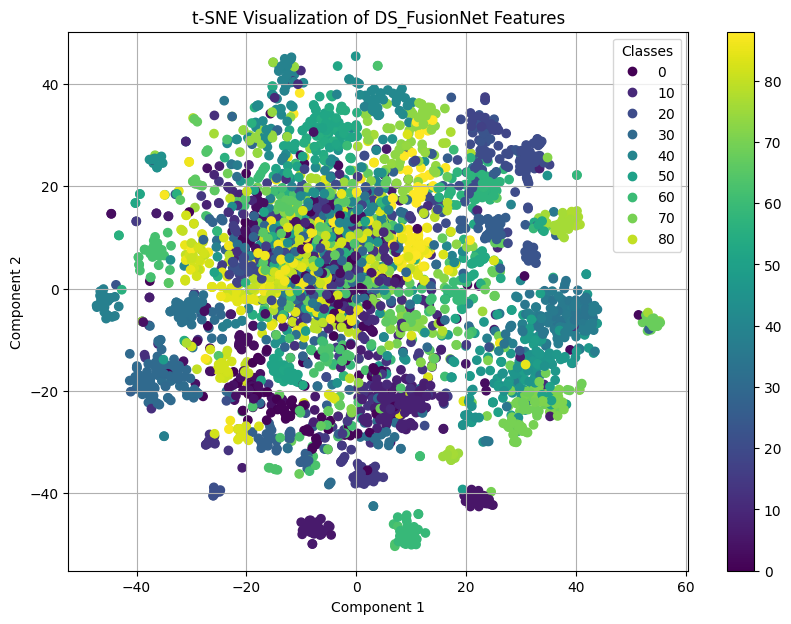

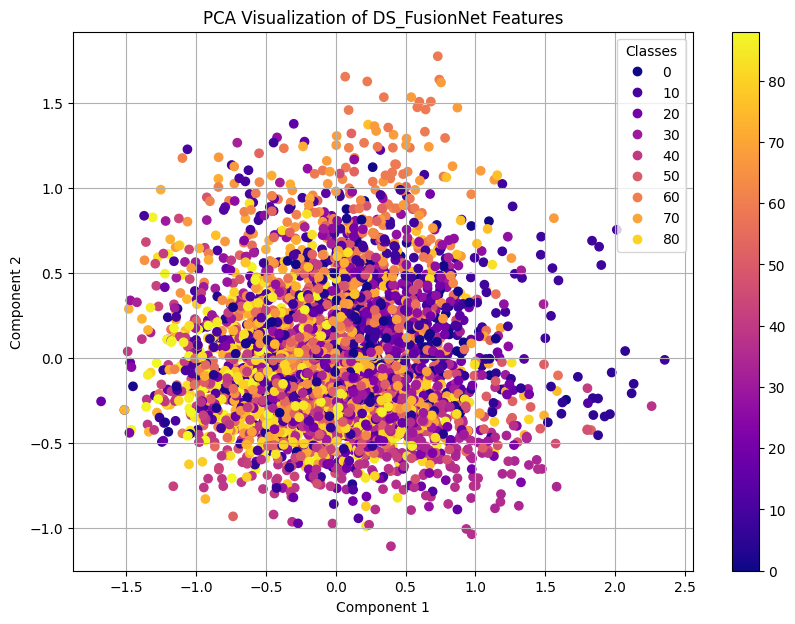

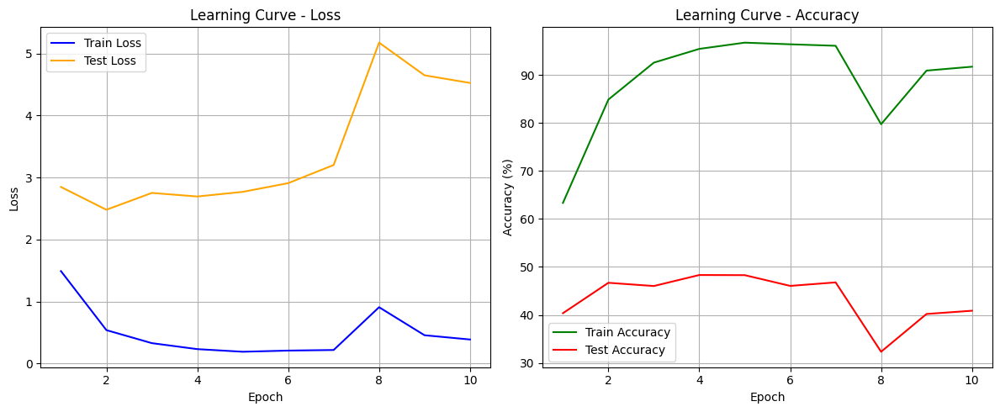

In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms, models
from torch.utils.data import DataLoader, Dataset
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import os
from PIL import Image

# 自定义数据集类
class PlantDocDataset(Dataset):
    def __init__(self, root_dir, txt_path, transform=None, train=True, train_ratio=0.8, random_seed=42):
        self.root_dir = root_dir
        self.transform = transform
        self.samples = []

        # 解析txt文件
        with open(txt_path, 'r') as f:
            lines = f.readlines()

        for line in lines:
            line = line.strip()
            if not line:
                continue
            parts = line.split('=')
            if len(parts) < 3:
                continue
            img_rel_path, label_str, _ = parts[0], parts[1], parts[2]
            img_full_path = os.path.join(root_dir, 'images', img_rel_path.replace('/', os.path.sep))
            if not os.path.exists(img_full_path):
                continue
            label = int(label_str)
            self.samples.append((img_full_path, label))

        # 随机分割数据集
        num_samples = len(self.samples)
        indices = list(range(num_samples))
        np.random.seed(random_seed)
        np.random.shuffle(indices)
        split_idx = int(train_ratio * num_samples)
        self.indices = indices[:split_idx] if train else indices[split_idx:]

    def __len__(self):
        return len(self.indices)

    def __getitem__(self, idx):
        actual_idx = self.indices[idx]
        img_path, label = self.samples[actual_idx]
        image = Image.open(img_path).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image, label

# 数据预处理
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# 创建数据集和数据加载器
train_dataset = PlantDocDataset(
    root_dir=r'E:\data1\plantdoc',
    txt_path=r'E:\data1\plantdoc\trainval.txt',
    transform=transform,
    train=True
)

test_dataset = PlantDocDataset(
    root_dir=r'E:\data1\plantdoc',
    txt_path=r'E:\data1\plantdoc\trainval.txt',
    transform=transform,
    train=False
)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False)

# 修改模型输出为89类
def load_efficientnet_b4(pretrained=True):
    model = models.efficientnet_b4(pretrained=pretrained)
    num_ftrs = model.classifier[1].in_features
    model.classifier[1] = nn.Linear(num_ftrs, 89)
    return model

def load_convnext_tiny(pretrained=True):
    model = models.convnext_tiny(pretrained=pretrained)
    num_ftrs = model.classifier[-1].in_features
    model.classifier[-1] = nn.Linear(num_ftrs, 89)
    return model

class DS_FusionNet(nn.Module):
    def __init__(self):
        super(DS_FusionNet, self).__init__()
        self.efficientnet = load_efficientnet_b4(pretrained=True)
        self.convnext = load_convnext_tiny(pretrained=True)
        self.deformable_conv = nn.Conv2d(2560, 64, kernel_size=3, padding=1)
        self.avgpool = nn.AdaptiveAvgPool2d((7, 7))
        self.fc = nn.Linear(64 * 7 * 7, 89)  # 89 classes

    def forward(self, x):
        eff_out_feat = self.efficientnet.features(x)
        convnext_out_feat = self.convnext.features(x)
        fused_feat = torch.cat((eff_out_feat, convnext_out_feat), dim=1)
        fused_feat = self.deformable_conv(fused_feat)
        fused_feat = self.avgpool(fused_feat)
        fused_feat = fused_feat.view(fused_feat.size(0), -1)
        out = self.fc(fused_feat)
        return out

# 其余函数保持不变（双向知识蒸馏、训练、测试、可视化等）
# ... [保持与原代码相同的函数定义] ...
# 双向知识蒸馏损失函数
def distillation_loss(y, labels, teacher_scores, T=3, alpha=0.5):
    KD_loss = nn.KLDivLoss()(nn.functional.log_softmax(y / T, dim=1),
                             nn.functional.softmax(teacher_scores / T, dim=1)) * (alpha * T * T) + \
              nn.CrossEntropyLoss()(y, labels) * (1. - alpha)
    return KD_loss

# 训练函数
def train(model, teacher_model, device, train_loader, optimizer, epoch, accumulation_steps=4):
    model.train()
    teacher_model.eval()
    for batch_idx, (data, target) in enumerate(train_loader):
        data, target = data.to(device), target.to(device)
        output_student = model(data)
        with torch.no_grad():
            output_teacher = teacher_model(data)
        loss = distillation_loss(output_student, target, output_teacher) / accumulation_steps
        
        loss.backward()
        
        if ((batch_idx + 1) % accumulation_steps == 0) or (batch_idx + 1 == len(train_loader)):
            optimizer.step()
            optimizer.zero_grad()

# 测试函数
def test(model, device, test_loader):
    model.eval()
    test_loss = 0
    correct = 0
    all_preds = []
    all_labels = []
    with torch.no_grad():
        for data, target in test_loader:
            data, target = data.to(device), target.to(device)
            output = model(data)
            test_loss += nn.CrossEntropyLoss(reduction='sum')(output, target).item()  # sum up batch loss
            pred = output.argmax(dim=1, keepdim=True)  # get the index of the max log-probability
            correct += pred.eq(target.view_as(pred)).sum().item()
            all_preds.extend(pred.cpu().numpy())
            all_labels.extend(target.cpu().numpy())

    test_loss /= len(test_loader.dataset)

    print('\nTest set: Average loss: {:.4f}, Accuracy: {}/{} ({:.0f}%)\n'.format(
        test_loss, correct, len(test_loader.dataset),
        100. * correct / len(test_loader.dataset)))
    
    return all_preds, all_labels

# t-SNE可视化
def visualize_tsne(features, labels, title):
    tsne = TSNE(n_components=2, random_state=0)
    features_tsne = tsne.fit_transform(features)

    plt.figure(figsize=(10, 7))
    scatter = plt.scatter(features_tsne[:, 0], features_tsne[:, 1], c=labels, cmap='viridis')  # 使用 viridis 配色
    legend1 = plt.legend(*scatter.legend_elements(), title="Classes", loc='best')
    plt.title(title)
    plt.xlabel('Component 1')
    plt.ylabel('Component 2')
    plt.colorbar(scatter)  # 添加颜色条以显示类别对应的颜色
    plt.grid(True)
    plt.show()

# PCA可视化
def visualize_pca(features, labels, title):
    pca = PCA(n_components=2)
    features_pca = pca.fit_transform(features)

    plt.figure(figsize=(10, 7))
    scatter = plt.scatter(features_pca[:, 0], features_pca[:, 1], c=labels, cmap='plasma')  # 使用 plasma 配色
    legend1 = plt.legend(*scatter.legend_elements(), title="Classes", loc='best')
    plt.title(title)
    plt.xlabel('Component 1')
    plt.ylabel('Component 2')
    plt.colorbar(scatter)  # 添加颜色条以显示类别对应的颜色
    plt.grid(True)
    plt.show()



# 计算指标
def calculate_metrics(model, teacher_model, device, dataloader):
    model.eval()
    total_loss = 0
    correct = 0
    with torch.no_grad():
        for data, target in dataloader:
            data, target = data.to(device), target.to(device)
            output = model(data)
            total_loss += nn.CrossEntropyLoss(reduction='sum')(output, target).item()
            pred = output.argmax(dim=1, keepdim=True)
            correct += pred.eq(target.view_as(pred)).sum().item()

    total_loss /= len(dataloader.dataset)
    accuracy = 100. * correct / len(dataloader.dataset)
    return total_loss, accuracy


# 主程序
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = DS_FusionNet().to(device)
optimizer = optim.Adam(model.parameters(), lr=0.001)
teacher_model = load_efficientnet_b4(pretrained=True).to(device)

# 初始评估
print(f'Initial Evaluation...')
initial_all_preds, initial_all_labels = test(model, device, test_loader)
initial_train_loss, initial_train_acc = calculate_metrics(model, teacher_model, device, train_loader)
initial_test_loss, initial_test_acc = calculate_metrics(model, None, device, test_loader)

num_epochs = 10  # 设置训练轮数为10
train_losses = []
train_accuracies = []
test_losses = []
test_accuracies = []

for epoch in range(1, num_epochs + 1):  # 将训练轮数设为10
    print(f'Training DS_FusionNet Epoch {epoch}/{num_epochs}...')
    train(model, teacher_model, device, train_loader, optimizer, epoch)
    print(f'Evaluating DS_FusionNet Epoch {epoch}/{num_epochs}...')
    all_preds, all_labels = test(model, device, test_loader)

    # Collecting training and testing metrics for learning curves
    train_loss, train_acc = calculate_metrics(model, teacher_model, device, train_loader)
    test_loss, test_acc = calculate_metrics(model, None, device, test_loader)
    train_losses.append(train_loss)
    train_accuracies.append(train_acc)
    test_losses.append(test_loss)
    test_accuracies.append(test_acc)

# 最终评估
final_train_loss, final_train_acc = calculate_metrics(model, teacher_model, device, train_loader)
final_test_loss, final_test_acc = calculate_metrics(model, None, device, test_loader)

print(f'\nInitial Training Loss: {initial_train_loss:.4f}, Initial Training Accuracy: {initial_train_acc:.2f}%')
print(f'Final Training Loss: {final_train_loss:.4f}, Final Training Accuracy: {final_train_acc:.2f}%')
print(f'Initial Test Loss: {initial_test_loss:.4f}, Initial Test Accuracy: {initial_test_acc:.2f}%')
print(f'Final Test Loss: {final_test_loss:.4f}, Final Test Accuracy: {final_test_acc:.2f}%')

print(f'Visualizing DS_FusionNet...')

# Extract features for visualization
features = []
labels = []
with torch.no_grad():
    for i, (data, target) in enumerate(test_loader):
        data, target = data.to(device), target.to(device)
        eff_out_feat = model.efficientnet.features(data)
        convnext_out_feat = model.convnext.features(data)
        fused_feat = torch.cat((eff_out_feat, convnext_out_feat), dim=1)
        feature_map = fused_feat.mean(dim=(2, 3))
        features.append(feature_map.cpu().numpy())
        labels.extend(target.cpu().numpy())  # 将 target 移动到 CPU

features = np.concatenate(features)
labels = np.array(labels)

visualize_tsne(features, labels, 't-SNE Visualization of DS_FusionNet Features')
visualize_pca(features, labels, 'PCA Visualization of DS_FusionNet Features')


# Plotting Learning Curves
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.plot(range(1, num_epochs + 1), train_losses, label='Train Loss', color='blue')
plt.plot(range(1, num_epochs + 1), test_losses, label='Test Loss', color='orange')
plt.title('Learning Curve - Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)

plt.subplot(1, 2, 2)
plt.plot(range(1, num_epochs + 1), train_accuracies, label='Train Accuracy', color='green')
plt.plot(range(1, num_epochs + 1), test_accuracies, label='Test Accuracy', color='red')
plt.title('Learning Curve - Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy (%)')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()




简化代码，专注于在小数据集下比较教师-学生网络和常规训练方法的效果。我们主要关注以下几个方面：

减少数据集大小：将训练集比例设置为 10%。
教师模型：训练 EfficientNetB4 和 ConvNeXtTiny 作为教师模型。
学生模型：使用这两个教师模型的知识来训练 DS_FusionNet。
常规训练：分别训练 EfficientNetB4、ConvNeXtTiny 和 DS_FusionNet，不使用知识蒸馏。
评估：记录每个模型的准确率，并进行特征可视化（t-SNE 和 PCA）以观察特征分布。

d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_B4_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B4_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ConvNeXt_Tiny_Weights.IMAGENET1K_V1`. You 

No pre-trained weights found at teacher_weights.pth. Training the EfficientNet teacher model from scratch.

Training EfficientNet Teacher Model...
Starting Epoch 1/1
Epoch 1 Training Loss: 4.4742


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 4.4545, Accuracy: 117/3709 (3%)


Training ConvNeXt Teacher Model...
Starting Epoch 1/1
Epoch 1 Training Loss: 4.2679

Test set: Average loss: 3.9351, Accuracy: 650/3709 (18%)


Training Fusion Net Student Model using EfficientNet and ConvNeXt Teachers...
Starting Epoch 1/1


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\torch\nn\functional.py:2994: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn(


Epoch 1 Training Loss: 2.1091

Test set: Average loss: 3.5899, Accuracy: 729/3709 (20%)



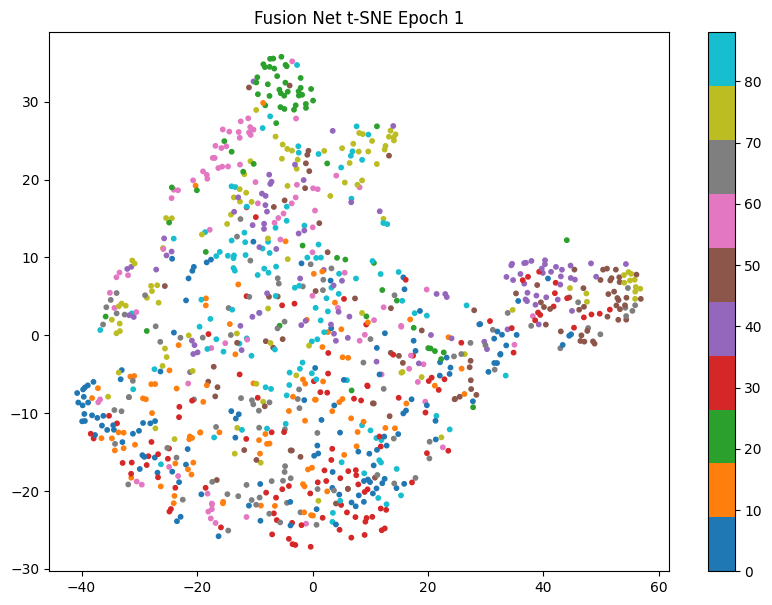

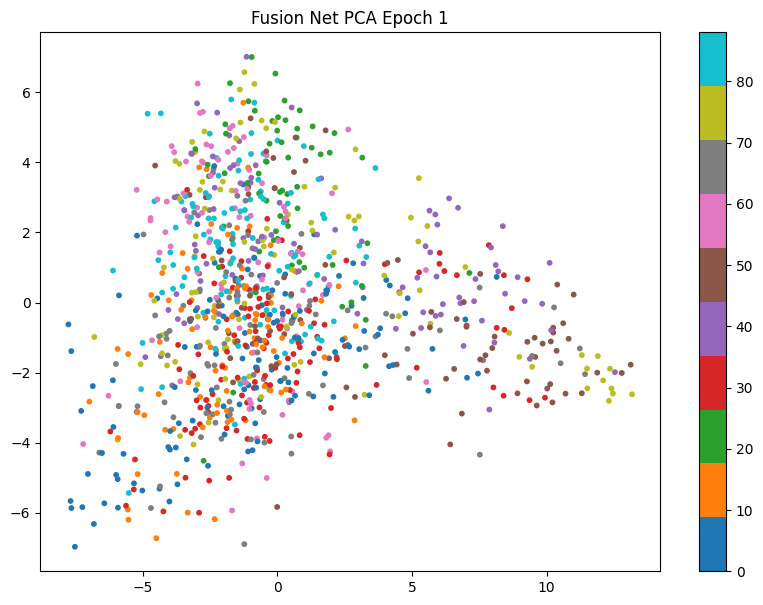

Saved Fusion Net weights to FusionNet_student_epoch_1.pth


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_B4_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B4_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ConvNeXt_Tiny_Weights.IMAGENET1K_V1`. You 


Regular Training for Comparison...

Training EfficientNetB4...
Starting Epoch 1/1
Epoch 1 Training Loss: 4.4783


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 4.4523, Accuracy: 156/3709 (4%)



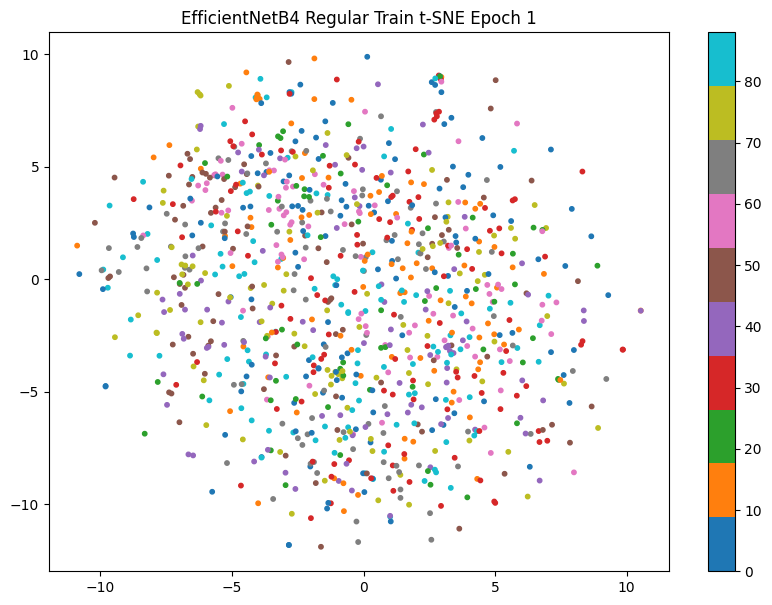

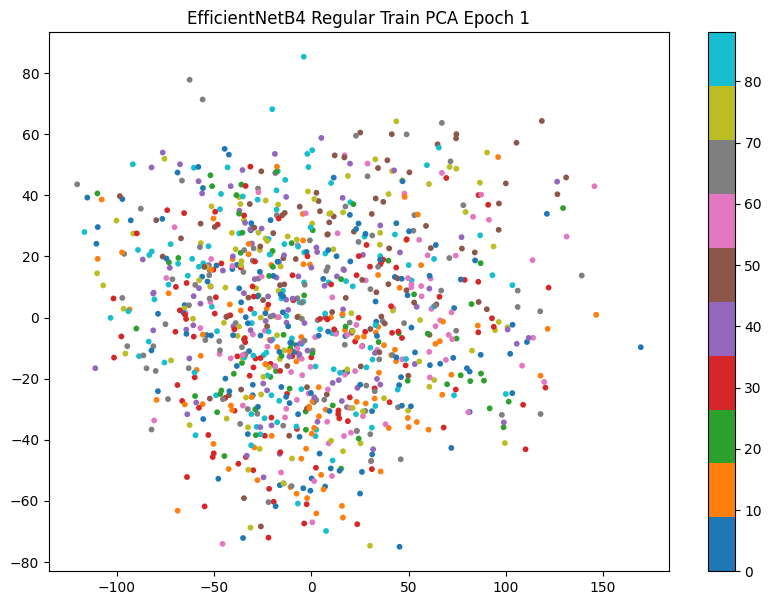

Saved EfficientNetB4 weights to EfficientNetB4_regular_train_epoch_1.pth

Training ConvNeXtTiny...
Starting Epoch 1/1
Epoch 1 Training Loss: 4.2837


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 3.9428, Accuracy: 515/3709 (14%)



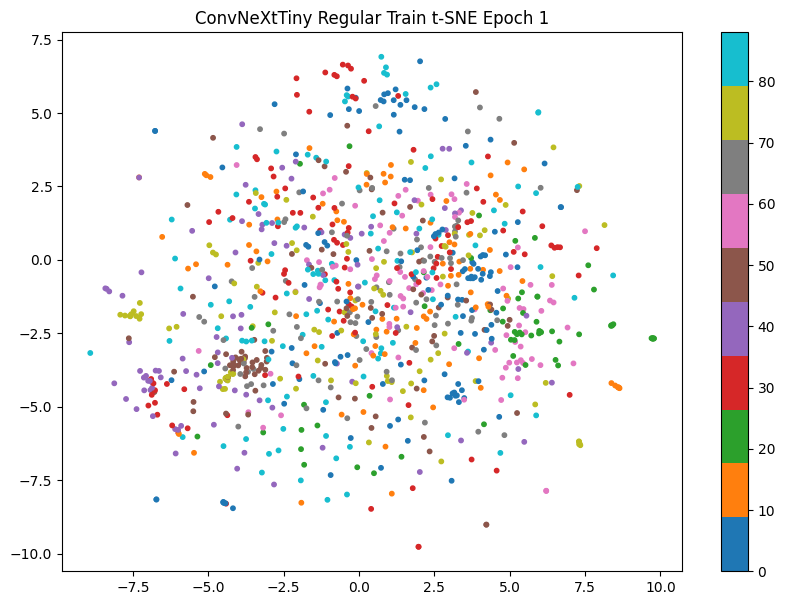

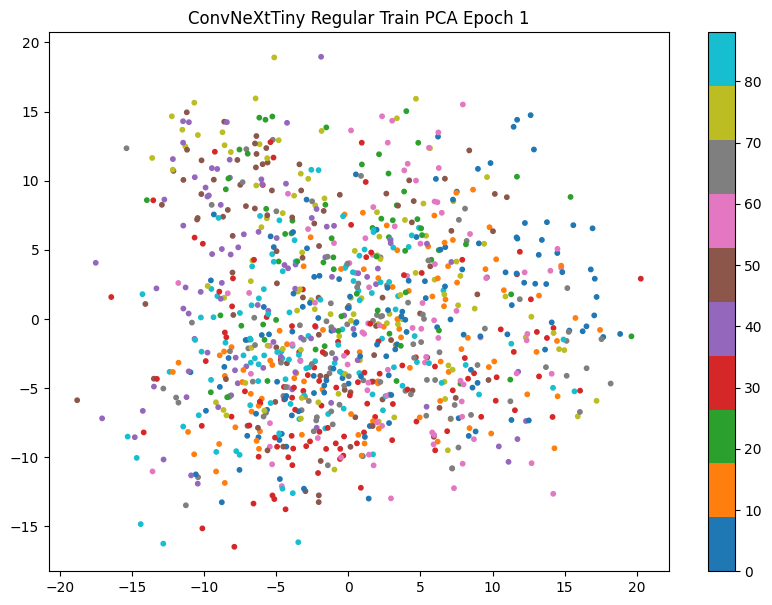

Saved ConvNeXtTiny weights to ConvNeXtTiny_regular_train_epoch_1.pth

Training DS_FusionNet...
Starting Epoch 1/1
Epoch 1 Training Loss: 4.2163


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 3.6124, Accuracy: 685/3709 (18%)



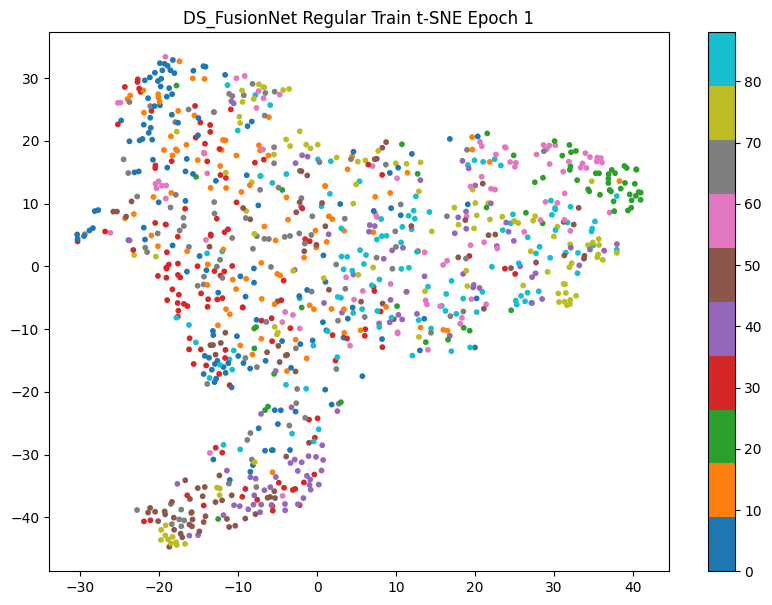

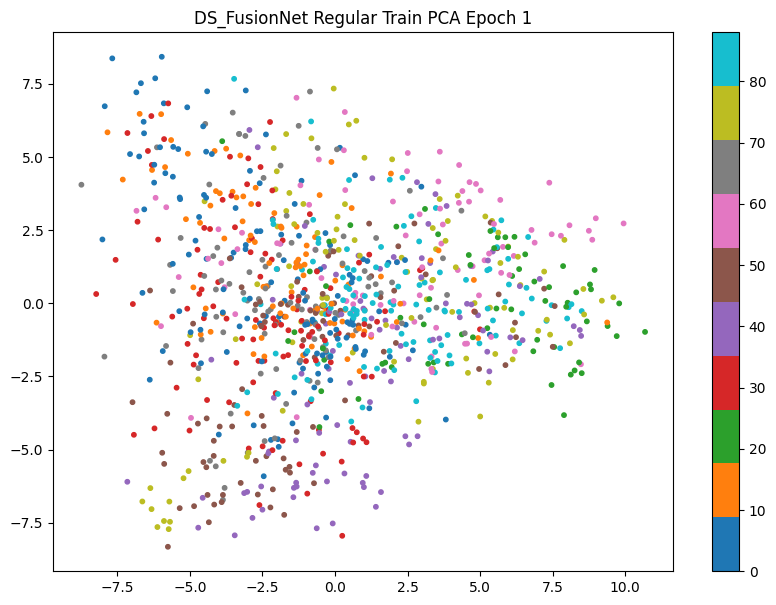

Saved DS_FusionNet weights to DS_FusionNet_regular_train_epoch_1.pth


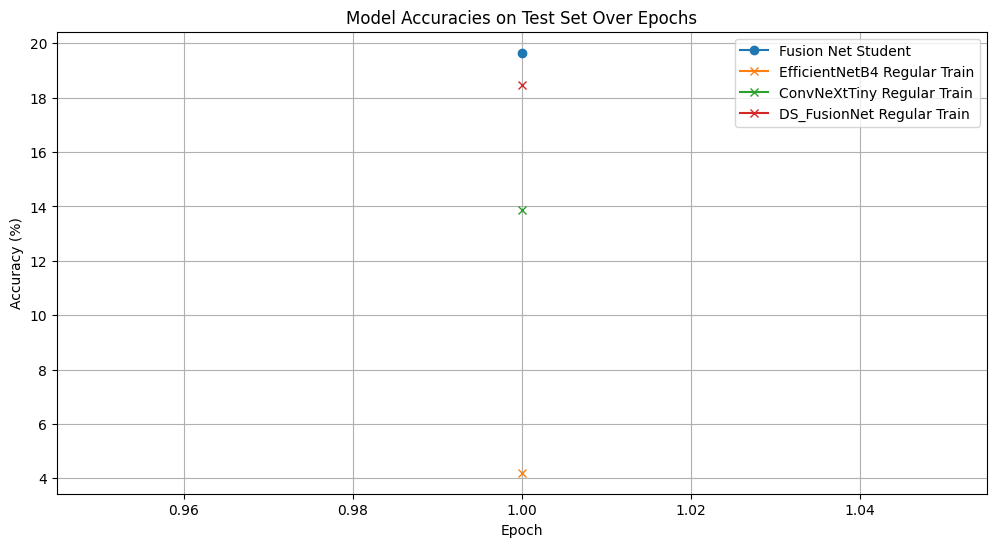

In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms, models
from torch.utils.data import DataLoader, Dataset
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import os
from PIL import Image

# 自定义数据集类
class PlantDocDataset(Dataset):
    def __init__(self, root_dir, txt_path, transform=None, train=True, train_ratio=0.8, random_seed=42):
        self.root_dir = root_dir
        self.transform = transform
        self.samples = []

        # 解析txt文件
        with open(txt_path, 'r') as f:
            lines = f.readlines()

        for line in lines:
            line = line.strip()
            if not line:
                continue
            parts = line.split('=')
            if len(parts) < 3:
                continue
            img_rel_path, label_str, _ = parts[0], parts[1], parts[2]
            img_full_path = os.path.join(root_dir, 'images', img_rel_path.replace('/', os.path.sep))
            if not os.path.exists(img_full_path):
                continue
            label = int(label_str)
            self.samples.append((img_full_path, label))

        # 随机分割数据集
        num_samples = len(self.samples)
        indices = list(range(num_samples))
        np.random.seed(random_seed)
        np.random.shuffle(indices)
        split_idx = int(train_ratio * num_samples)
        self.indices = indices[:split_idx] if train else indices[split_idx:]

    def __len__(self):
        return len(self.indices)

    def __getitem__(self, idx):
        actual_idx = self.indices[idx]
        img_path, label = self.samples[actual_idx]
        image = Image.open(img_path).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image, label

# 数据预处理
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# 创建数据集和数据加载器
train_dataset = PlantDocDataset(
    root_dir=r'E:\data1\plantdoc',
    txt_path=r'E:\data1\plantdoc\trainval.txt',
    transform=transform,
    train=True,
    train_ratio=0.1  # 减少训练集比例到10%
)

test_dataset = PlantDocDataset(
    root_dir=r'E:\data1\plantdoc',
    txt_path=r'E:\data1\plantdoc\trainval.txt',
    transform=transform,
    train=False
)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False)

# 修改模型输出为89类
def load_efficientnet_b4(pretrained=True):
    model = models.efficientnet_b4(pretrained=pretrained)
    num_ftrs = model.classifier[1].in_features
    model.classifier[1] = nn.Linear(num_ftrs, 89)
    return model

def load_convnext_tiny(pretrained=True):
    model = models.convnext_tiny(pretrained=pretrained)
    num_ftrs = model.classifier[-1].in_features
    model.classifier[-1] = nn.Linear(num_ftrs, 89)
    return model

class DS_FusionNet(nn.Module):
    def __init__(self):
        super(DS_FusionNet, self).__init__()
        self.efficientnet = load_efficientnet_b4(pretrained=True)
        self.convnext = load_convnext_tiny(pretrained=True)
        self.deformable_conv = nn.Conv2d(2560, 64, kernel_size=3, padding=1)
        self.avgpool = nn.AdaptiveAvgPool2d((7, 7))
        self.fc = nn.Linear(64 * 7 * 7, 89)  # 89 classes

    def forward(self, x):
        eff_out_feat = self.efficientnet.features(x)
        convnext_out_feat = self.convnext.features(x)
        fused_feat = torch.cat((eff_out_feat, convnext_out_feat), dim=1)
        fused_feat = self.deformable_conv(fused_feat)
        fused_feat = self.avgpool(fused_feat)
        fused_feat = fused_feat.view(fused_feat.size(0), -1)
        out = self.fc(fused_feat)
        return out

# 双向知识蒸馏损失函数
def distillation_loss(y, labels, teacher_scores, T=3, alpha=0.5):
    KD_loss = nn.KLDivLoss()(nn.functional.log_softmax(y / T, dim=1),
                             nn.functional.softmax(teacher_scores / T, dim=1)) * (alpha * T * T) + \
              nn.CrossEntropyLoss()(y, labels) * (1. - alpha)
    return KD_loss

# 训练函数
def train(model, teacher_model, device, train_loader, optimizer, epoch, accumulation_steps=4):
    model.train()
    teacher_model.eval() if teacher_model is not None else model.train()
    running_loss = 0.0
    for batch_idx, (data, target) in enumerate(train_loader):
        data, target = data.to(device), target.to(device)
        
        if teacher_model is not None:
            output_student = model(data)
            with torch.no_grad():
                output_teacher = teacher_model(data)
            loss = distillation_loss(output_student, target, output_teacher) / accumulation_steps
        else:
            output = model(data)
            loss = nn.CrossEntropyLoss()(output, target) / accumulation_steps
        
        loss.backward()
        
        if ((batch_idx + 1) % accumulation_steps == 0) or (batch_idx + 1 == len(train_loader)):
            optimizer.step()
            optimizer.zero_grad()
        
        running_loss += loss.item() * accumulation_steps
    
    print(f'Epoch {epoch} Training Loss: {running_loss / len(train_loader):.4f}')

# 测试函数
def test(model, device, test_loader):
    model.eval()
    test_loss = 0
    correct = 0
    with torch.no_grad():
        for data, target in test_loader:
            data, target = data.to(device), target.to(device)
            output = model(data)
            test_loss += nn.CrossEntropyLoss(reduction='sum')(output, target).item()  # sum up batch loss
            pred = output.argmax(dim=1, keepdim=True)  # get the index of the max log-probability
            correct += pred.eq(target.view_as(pred)).sum().item()

    test_loss /= len(test_loader.dataset)

    accuracy = 100. * correct / len(test_loader.dataset)
    print('\nTest set: Average loss: {:.4f}, Accuracy: {}/{} ({:.0f}%)\n'.format(
        test_loss, correct, len(test_loader.dataset), accuracy))
    
    return accuracy

# 可视化函数
def visualize_tsne(features, labels, title):
    tsne = TSNE(n_components=2, random_state=0)
    features_tsne = tsne.fit_transform(features)
    plt.figure(figsize=(10, 7))
    plt.scatter(features_tsne[:, 0], features_tsne[:, 1], c=labels, cmap='tab10', s=10)
    plt.title(title)
    plt.colorbar()
    plt.show()

def visualize_pca(features, labels, title):
    pca = PCA(n_components=2)
    features_pca = pca.fit_transform(features)
    plt.figure(figsize=(10, 7))
    plt.scatter(features_pca[:, 0], features_pca[:, 1], c=labels, cmap='tab10', s=10)
    plt.title(title)
    plt.colorbar()
    plt.show()

# 特征提取函数（修正后的）
def extract_features(model, dataloader, device, num_samples=1000):
    model.eval()
    features = []
    labels = []
    with torch.no_grad():
        for i, (data, target) in enumerate(dataloader):
            if i * len(data) >= num_samples:
                break
            data, target = data.to(device), target.to(device)
            
            # 获取中间特征
            if isinstance(model, models.EfficientNet):
                feature_map = model.features(data)
            elif isinstance(model, models.ConvNeXt):
                feature_map = model.features(data)
            elif isinstance(model, DS_FusionNet):
                feature_map = model.forward(data)
            else:
                raise ValueError("Unsupported model type")
                
            # 将特征展平成一维向量
            feature_vector = torch.flatten(feature_map, start_dim=1)
            features.append(feature_vector.cpu().numpy())
            labels.extend(target.cpu().numpy())  # 修正处：添加.cpu()
    
    features = np.concatenate(features)[:num_samples]
    labels = np.array(labels)[:num_samples]
    return features, labels

# 主程序
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# 初始化模型
efficientnet = load_efficientnet_b4().to(device)
convnext = load_convnext_tiny().to(device)
fusion_net = DS_FusionNet().to(device)

# 加载教师模型权重（如果存在）
teacher_weights_path = "teacher_weights.pth"
if os.path.exists(teacher_weights_path):
    efficientnet.load_state_dict(torch.load(teacher_weights_path))
else:
    print(f"No pre-trained weights found at {teacher_weights_path}. Training the EfficientNet teacher model from scratch.")

# 训练参数
optimizer_efficientnet = optim.Adam(efficientnet.parameters(), lr=1e-4)
optimizer_convnext = optim.Adam(convnext.parameters(), lr=1e-4)
optimizer_fusion_net = optim.Adam(fusion_net.parameters(), lr=1e-4)

# 训练循环
num_epochs = 1  # 设置训练轮数为10

print("\nTraining EfficientNet Teacher Model...")
for epoch in range(1, num_epochs + 1):
    print(f'Starting Epoch {epoch}/{num_epochs}')
    train(efficientnet, None, device, train_loader, optimizer_efficientnet, epoch)
    acc_efficientnet = test(efficientnet, device, test_loader)

print("\nTraining ConvNeXt Teacher Model...")
for epoch in range(1, num_epochs + 1):
    print(f'Starting Epoch {epoch}/{num_epochs}')
    train(convnext, None, device, train_loader, optimizer_convnext, epoch)
    acc_convnext = test(convnext, device, test_loader)

print("\nTraining Fusion Net Student Model using EfficientNet and ConvNeXt Teachers...")
accuracies_fusion_net = []
for epoch in range(1, num_epochs + 1):
    print(f'Starting Epoch {epoch}/{num_epochs}')
    train(fusion_net, efficientnet, device, train_loader, optimizer_fusion_net, epoch)
    acc_fusion_net = test(fusion_net, device, test_loader)
    accuracies_fusion_net.append(acc_fusion_net)
    
    # 提取特征并进行可视化
    features, labels = extract_features(fusion_net, test_loader, device)
    visualize_tsne(features, labels, f'Fusion Net t-SNE Epoch {epoch}')
    visualize_pca(features, labels, f'Fusion Net PCA Epoch {epoch}')
    
    # 保存学生模型权重
    student_weights_path = f"FusionNet_student_epoch_{epoch}.pth"
    torch.save(fusion_net.state_dict(), student_weights_path)
    print(f'Saved Fusion Net weights to {student_weights_path}')

# 常规训练部分
regular_models = {
    'EfficientNetB4': load_efficientnet_b4().to(device),
    'ConvNeXtTiny': load_convnext_tiny().to(device),
    'DS_FusionNet': DS_FusionNet().to(device)
}

regular_optimizers = {name: optim.Adam(model.parameters(), lr=1e-4) for name, model in regular_models.items()}

regular_accuracies = {name: [] for name in regular_models.keys()}

print("\nRegular Training for Comparison...")
for name, model in regular_models.items():
    print(f'\nTraining {name}...')
    for epoch in range(1, num_epochs + 1):
        print(f'Starting Epoch {epoch}/{num_epochs}')
        train(model, None, device, train_loader, regular_optimizers[name], epoch)
        acc_regular = test(model, device, test_loader)
        regular_accuracies[name].append(acc_regular)
        
        # 提取特征并进行可视化
        features, labels = extract_features(model, test_loader, device)
        visualize_tsne(features, labels, f'{name} Regular Train t-SNE Epoch {epoch}')
        visualize_pca(features, labels, f'{name} Regular Train PCA Epoch {epoch}')
        
        # 保存模型权重
        model_weights_path = f"{name}_regular_train_epoch_{epoch}.pth"
        torch.save(model.state_dict(), model_weights_path)
        print(f'Saved {name} weights to {model_weights_path}')

# 绘制准确率曲线
plt.figure(figsize=(12, 6))
plt.plot(range(1, num_epochs + 1), accuracies_fusion_net, label='Fusion Net Student', marker='o')
for name, accs in regular_accuracies.items():
    plt.plot(range(1, num_epochs + 1), accs, label=f'{name} Regular Train', marker='x')

plt.xlabel('Epoch')
plt.ylabel('Accuracy (%)')
plt.title('Model Accuracies on Test Set Over Epochs')
plt.legend()
plt.grid(True)
plt.show()

上述代码的十次训练

d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_B4_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B4_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ConvNeXt_Tiny_Weights.IMAGENET1K_V1`. You 

No pre-trained weights found at teacher_weights.pth. Training the EfficientNet teacher model from scratch.

Training EfficientNet Teacher Model...
Starting Epoch 1/10
Epoch 1 Training Loss: 4.4688

Test set: Average loss: 4.4510, Accuracy: 138/3709 (4%)

Starting Epoch 2/10
Epoch 2 Training Loss: 4.3764

Test set: Average loss: 4.3740, Accuracy: 203/3709 (5%)

Starting Epoch 3/10
Epoch 3 Training Loss: 4.2505

Test set: Average loss: 4.2840, Accuracy: 164/3709 (4%)

Starting Epoch 4/10
Epoch 4 Training Loss: 4.1339

Test set: Average loss: 4.1883, Accuracy: 264/3709 (7%)

Starting Epoch 5/10
Epoch 5 Training Loss: 3.9878

Test set: Average loss: 4.0389, Accuracy: 347/3709 (9%)

Starting Epoch 6/10
Epoch 6 Training Loss: 3.7822

Test set: Average loss: 3.8413, Accuracy: 608/3709 (16%)

Starting Epoch 7/10
Epoch 7 Training Loss: 3.4684

Test set: Average loss: 3.5655, Accuracy: 794/3709 (21%)

Starting Epoch 8/10
Epoch 8 Training Loss: 3.0727

Test set: Average loss: 3.2018, Accuracy: 10

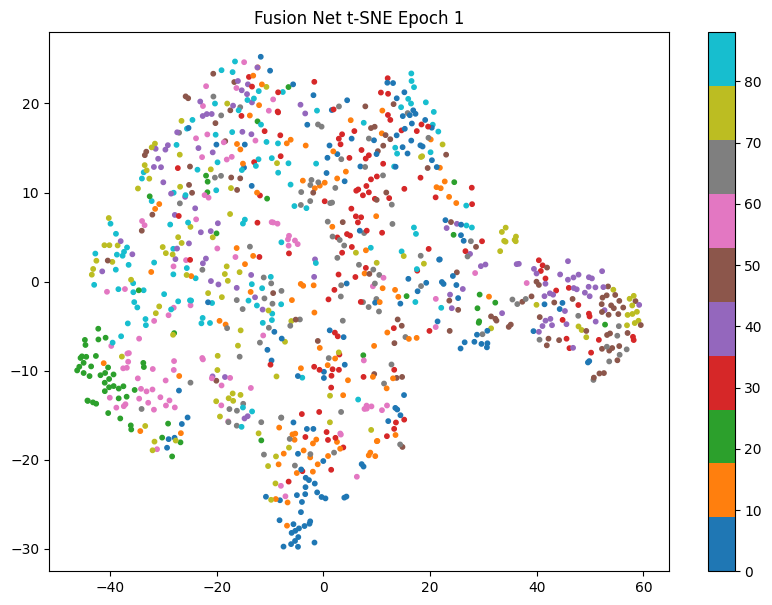

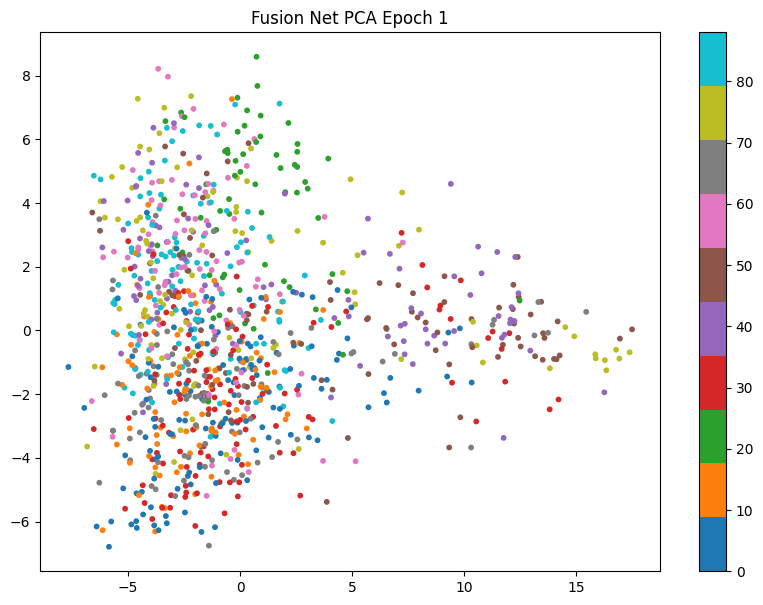

Saved Fusion Net weights to FusionNet_student_epoch_1.pth
Starting Epoch 2/10


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\torch\nn\functional.py:2994: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn(


Epoch 2 Training Loss: 1.2361


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.5550, Accuracy: 1252/3709 (34%)



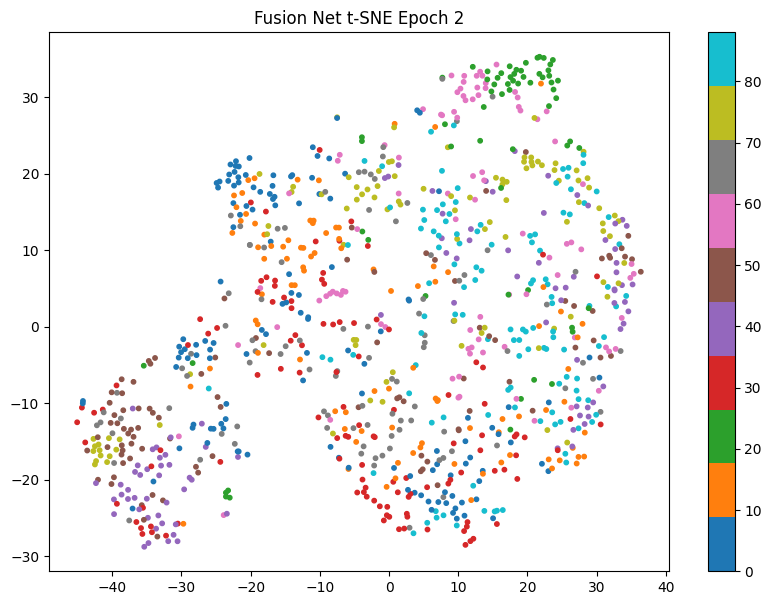

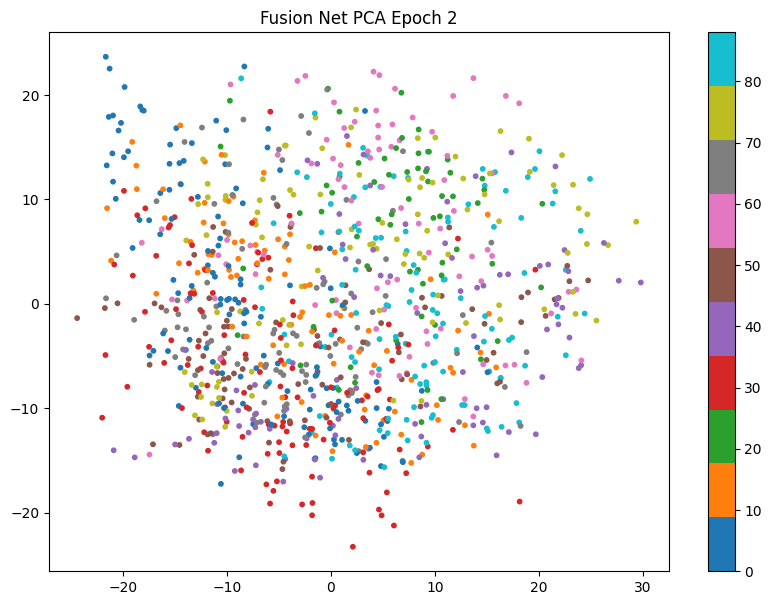

Saved Fusion Net weights to FusionNet_student_epoch_2.pth
Starting Epoch 3/10


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\torch\nn\functional.py:2994: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn(


Epoch 3 Training Loss: 0.5618


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.1878, Accuracy: 1538/3709 (41%)



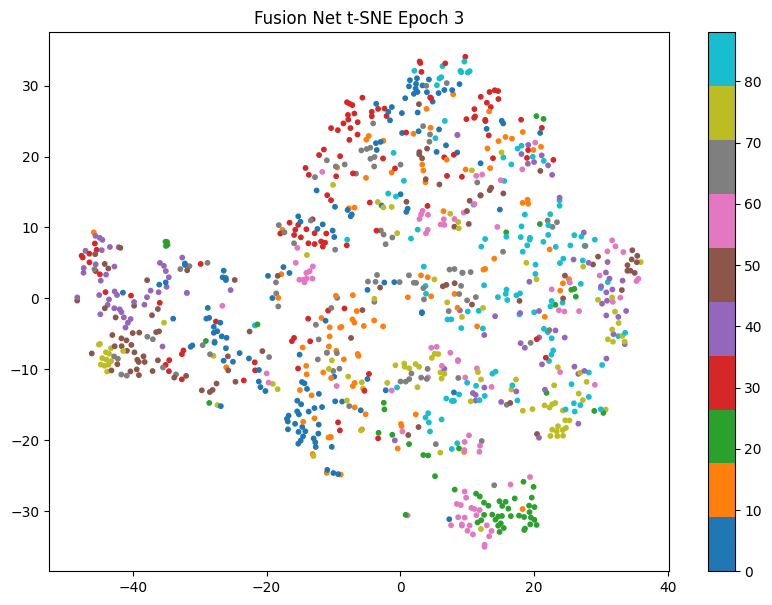

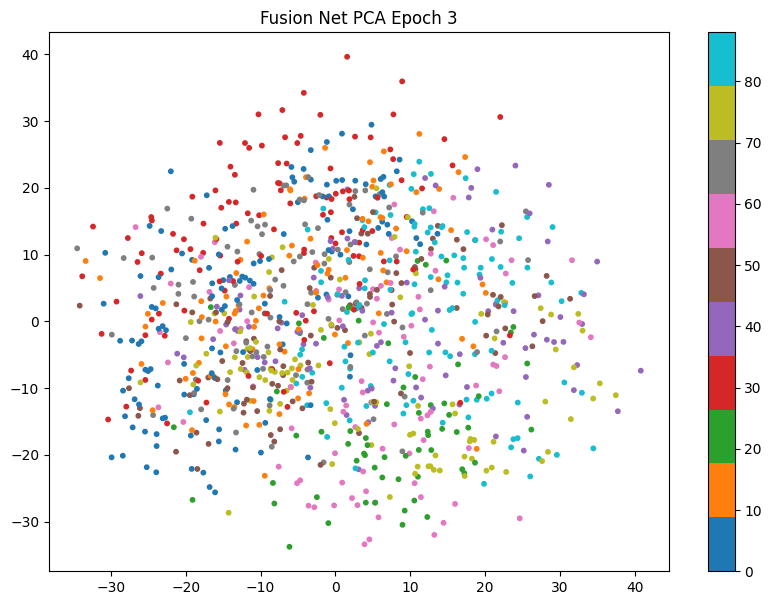

Saved Fusion Net weights to FusionNet_student_epoch_3.pth
Starting Epoch 4/10


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\torch\nn\functional.py:2994: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn(


Epoch 4 Training Loss: 0.2121


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.1319, Accuracy: 1593/3709 (43%)



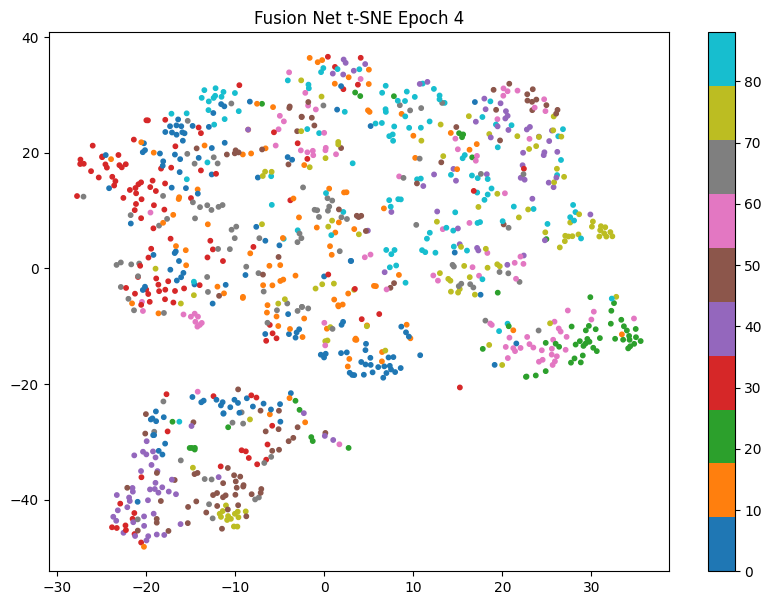

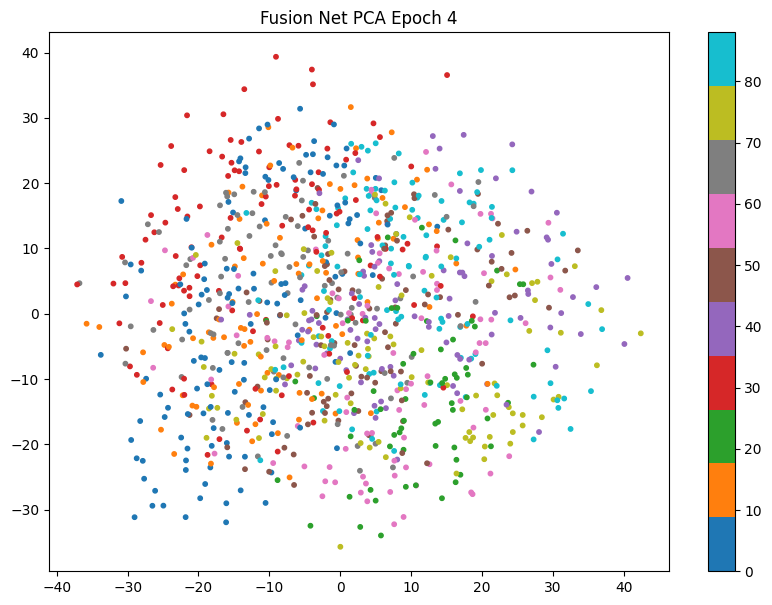

Saved Fusion Net weights to FusionNet_student_epoch_4.pth
Starting Epoch 5/10


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\torch\nn\functional.py:2994: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn(


Epoch 5 Training Loss: 0.1046


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.1401, Accuracy: 1615/3709 (44%)



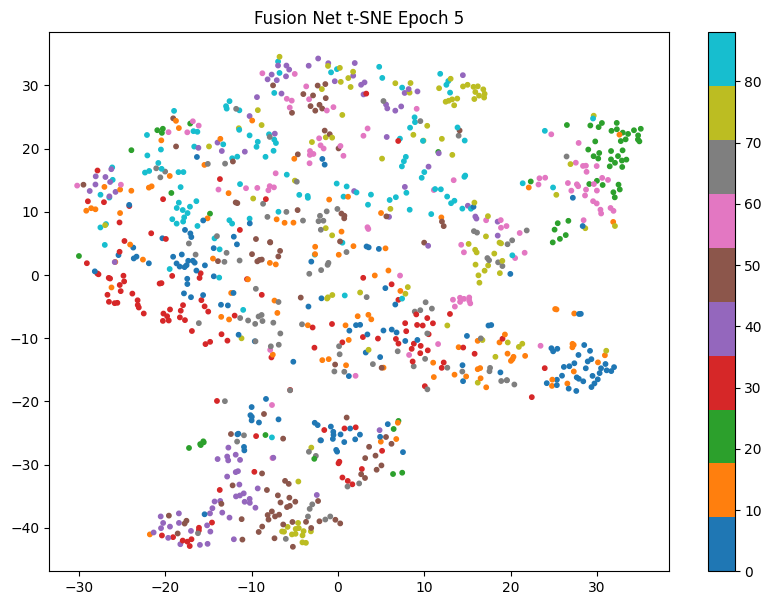

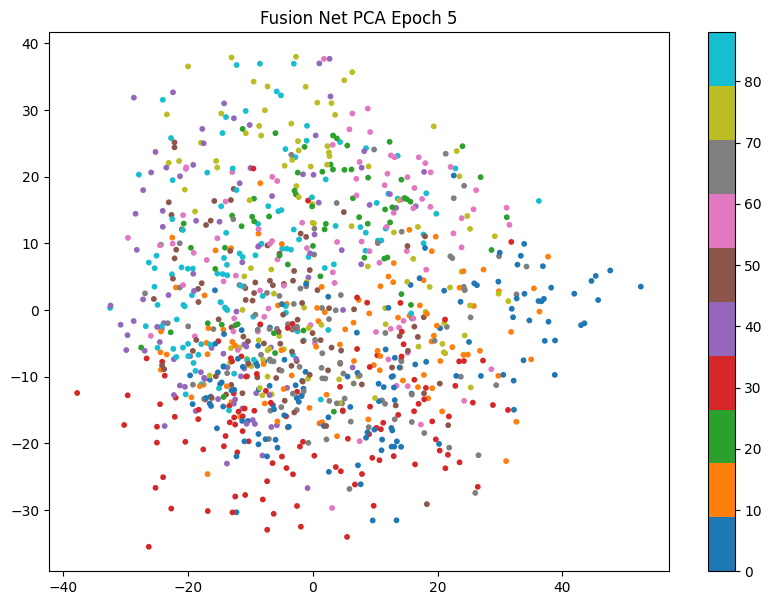

Saved Fusion Net weights to FusionNet_student_epoch_5.pth
Starting Epoch 6/10


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\torch\nn\functional.py:2994: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn(


Epoch 6 Training Loss: 0.0756


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.1045, Accuracy: 1664/3709 (45%)



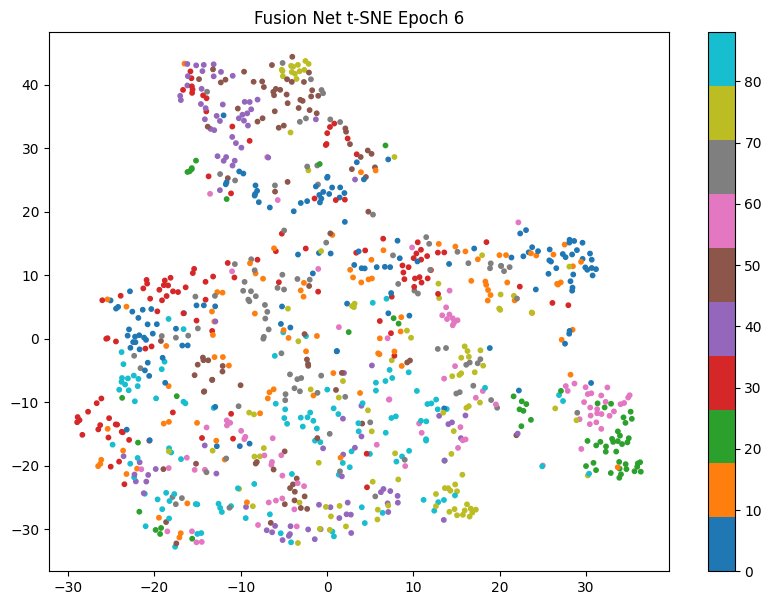

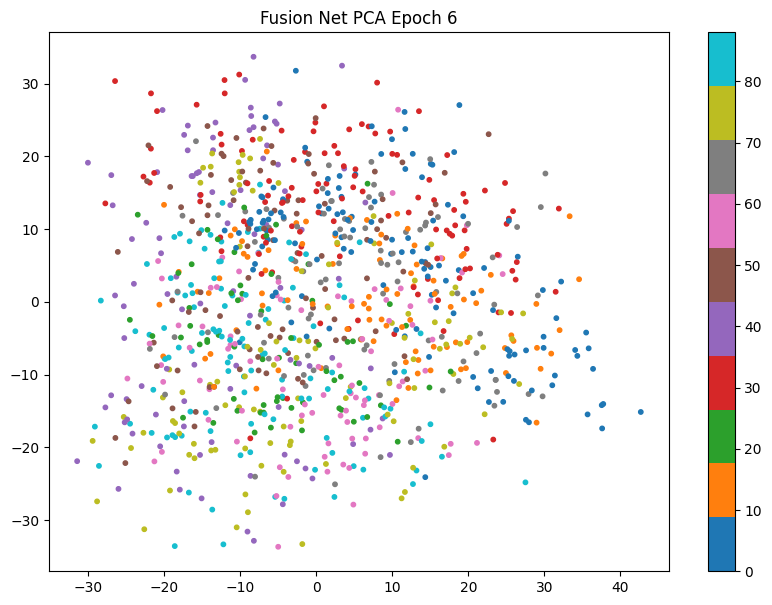

Saved Fusion Net weights to FusionNet_student_epoch_6.pth
Starting Epoch 7/10


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\torch\nn\functional.py:2994: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn(


Epoch 7 Training Loss: 0.0586


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.0423, Accuracy: 1686/3709 (45%)



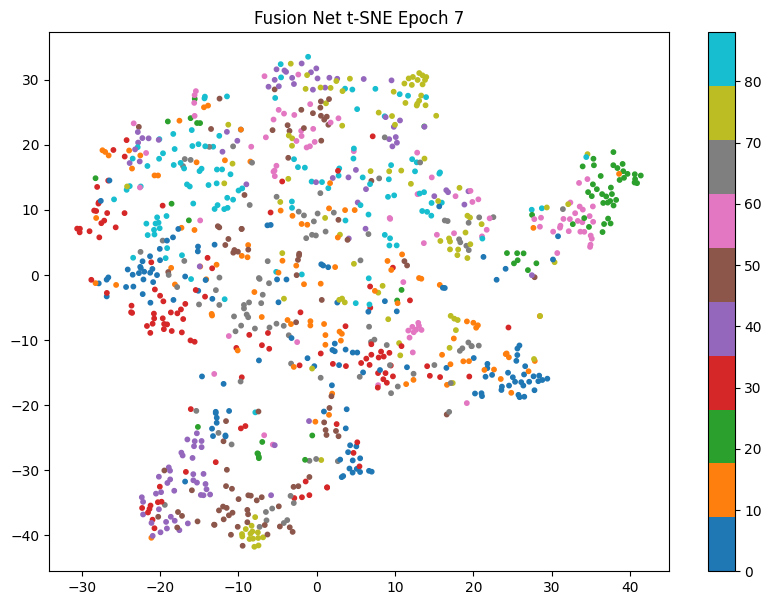

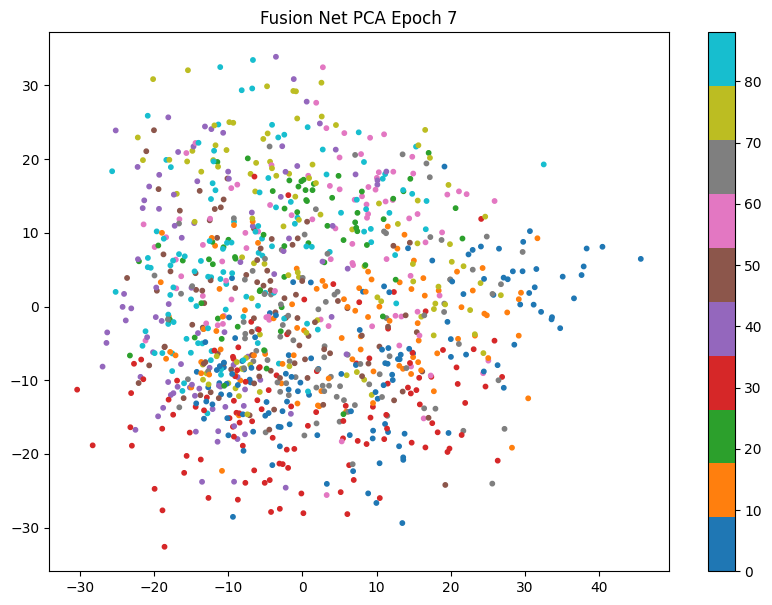

Saved Fusion Net weights to FusionNet_student_epoch_7.pth
Starting Epoch 8/10


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\torch\nn\functional.py:2994: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn(


Epoch 8 Training Loss: 0.0579


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.0455, Accuracy: 1677/3709 (45%)



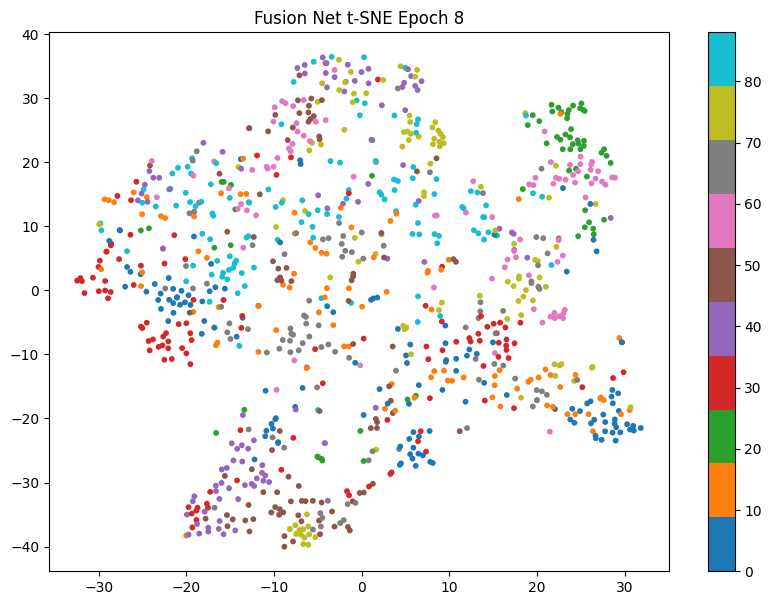

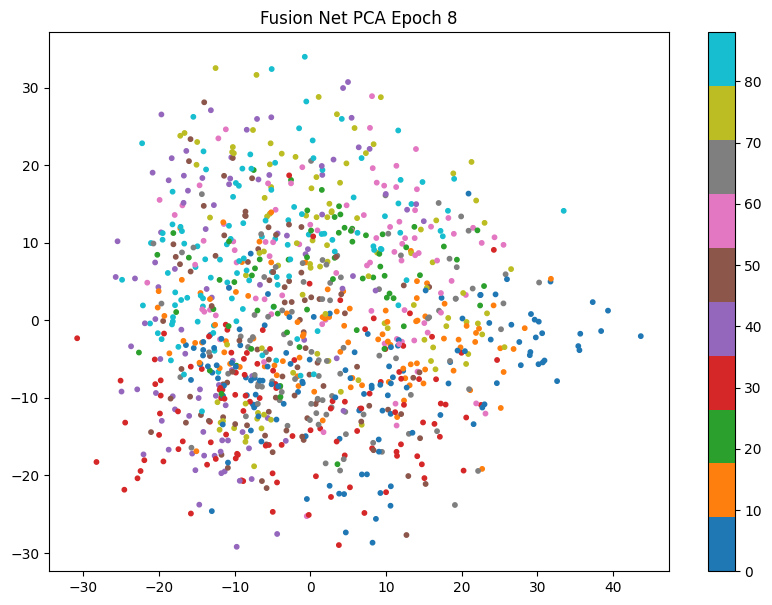

Saved Fusion Net weights to FusionNet_student_epoch_8.pth
Starting Epoch 9/10


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\torch\nn\functional.py:2994: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn(


Epoch 9 Training Loss: 0.0516


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.0570, Accuracy: 1690/3709 (46%)



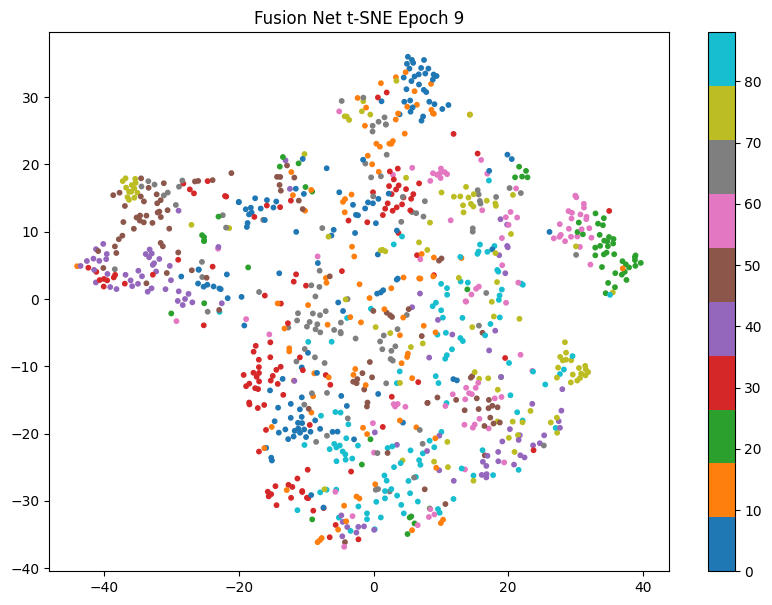

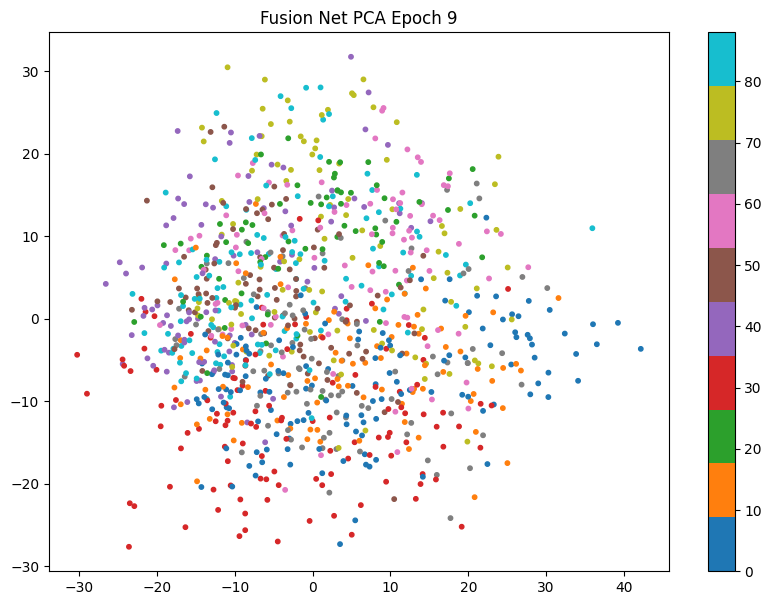

Saved Fusion Net weights to FusionNet_student_epoch_9.pth
Starting Epoch 10/10


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\torch\nn\functional.py:2994: UserWarning: reduction: 'mean' divides the total loss by both the batch size and the support size.'batchmean' divides only by the batch size, and aligns with the KL div math definition.'mean' will be changed to behave the same as 'batchmean' in the next major release.
  warnings.warn(


Epoch 10 Training Loss: 0.0457


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.0919, Accuracy: 1694/3709 (46%)



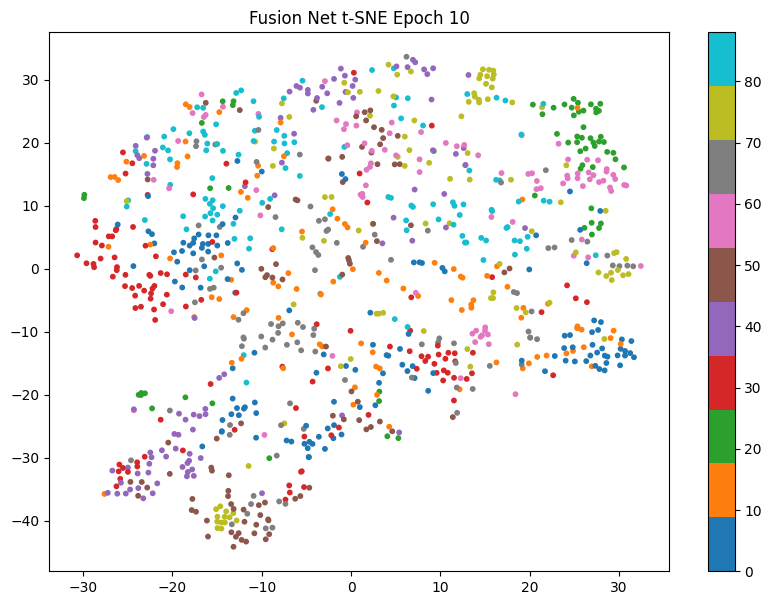

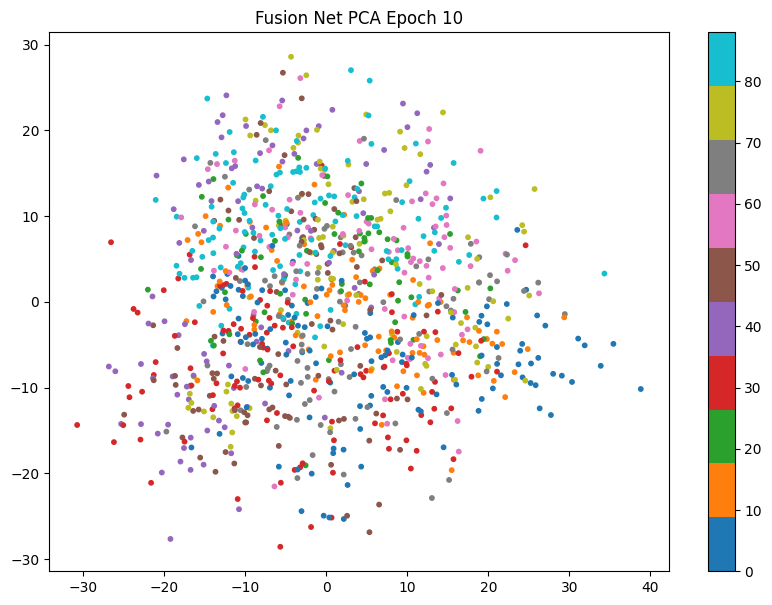

Saved Fusion Net weights to FusionNet_student_epoch_10.pth


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_B4_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B4_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ConvNeXt_Tiny_Weights.IMAGENET1K_V1`. You 


Regular Training for Comparison...

Training EfficientNetB4...
Starting Epoch 1/10
Epoch 1 Training Loss: 4.4742


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 4.4517, Accuracy: 144/3709 (4%)



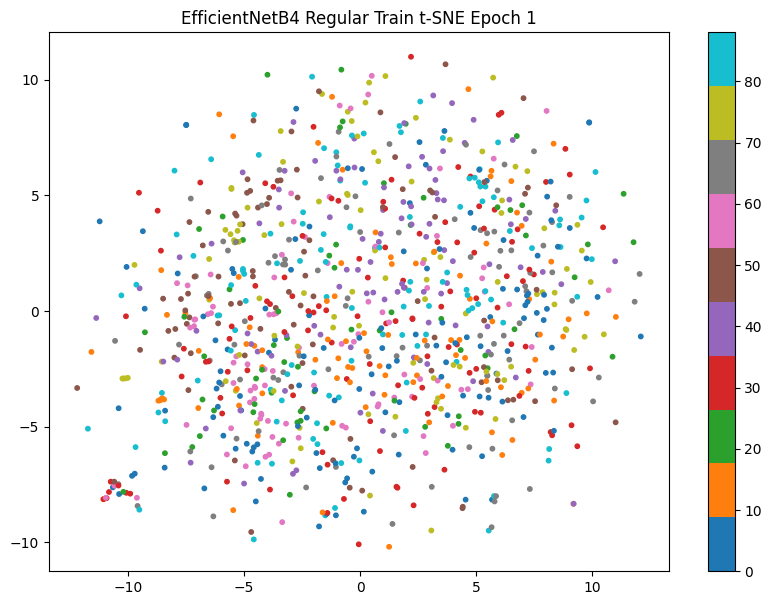

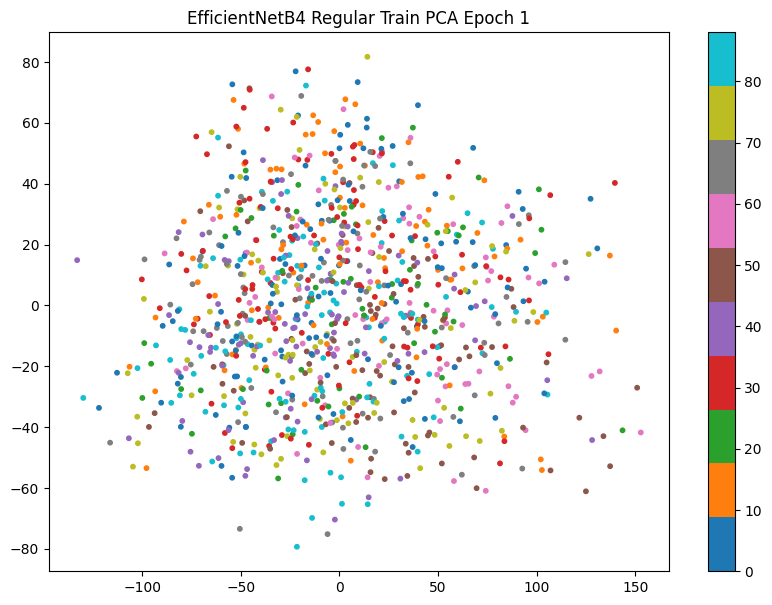

Saved EfficientNetB4 weights to EfficientNetB4_regular_train_epoch_1.pth
Starting Epoch 2/10
Epoch 2 Training Loss: 4.3833


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 4.3782, Accuracy: 176/3709 (5%)



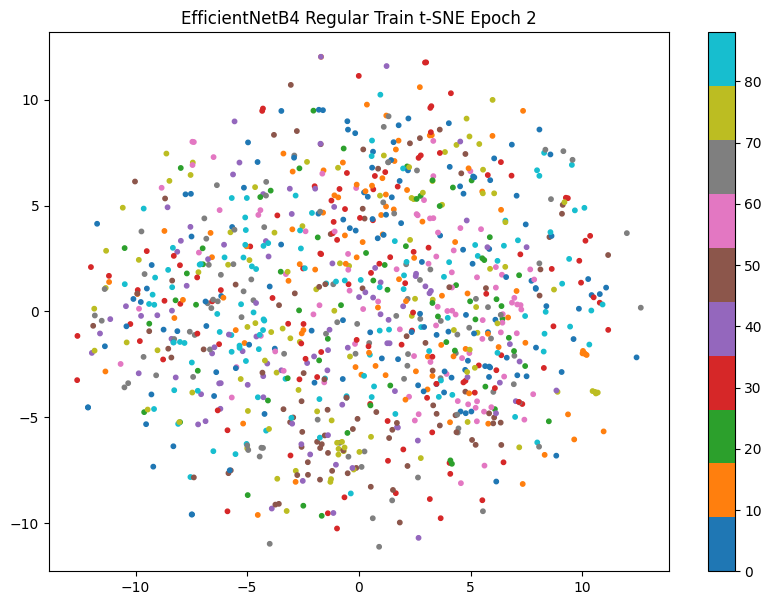

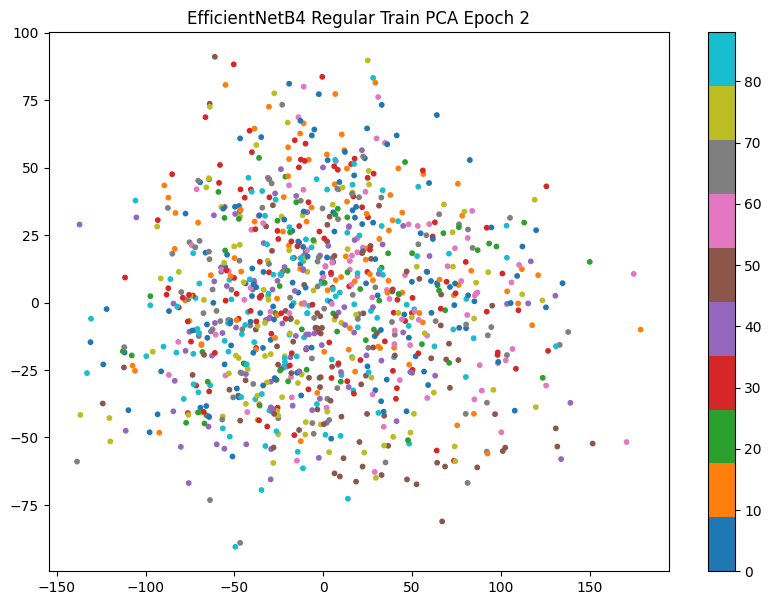

Saved EfficientNetB4 weights to EfficientNetB4_regular_train_epoch_2.pth
Starting Epoch 3/10
Epoch 3 Training Loss: 4.2604


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 4.2963, Accuracy: 222/3709 (6%)



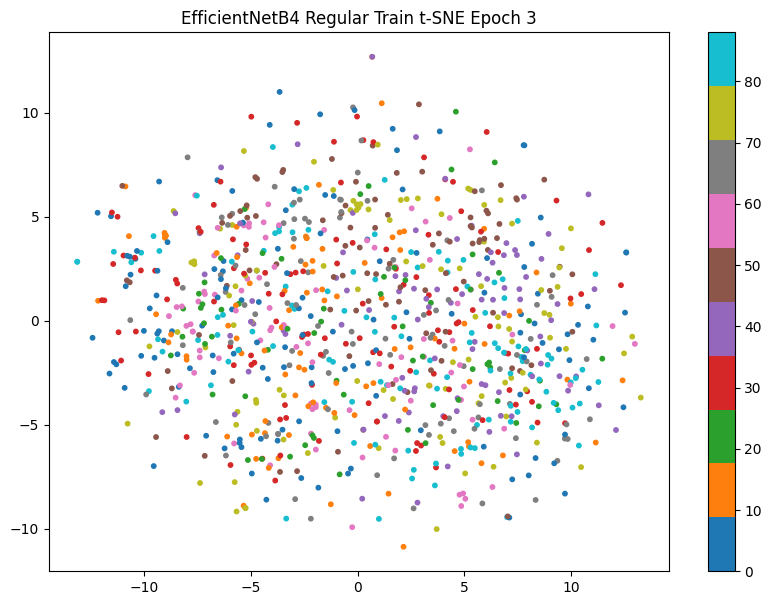

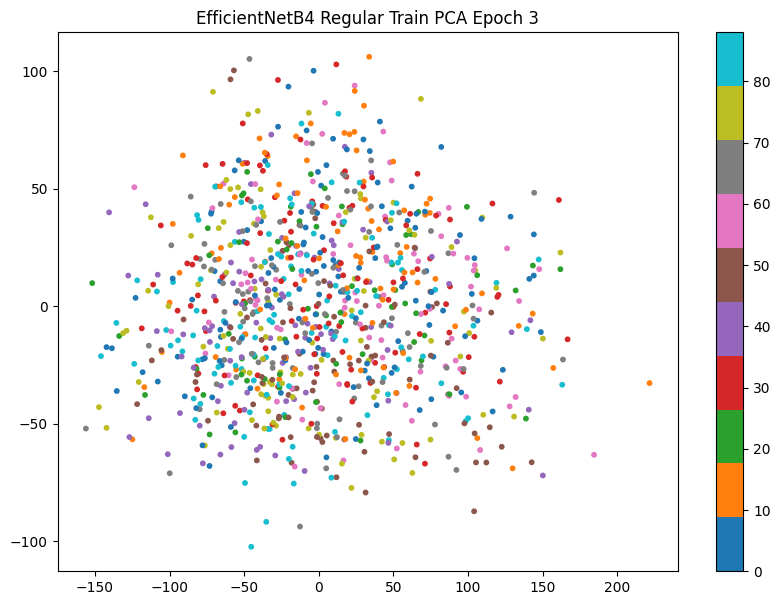

Saved EfficientNetB4 weights to EfficientNetB4_regular_train_epoch_3.pth
Starting Epoch 4/10
Epoch 4 Training Loss: 4.1515


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 4.2192, Accuracy: 265/3709 (7%)



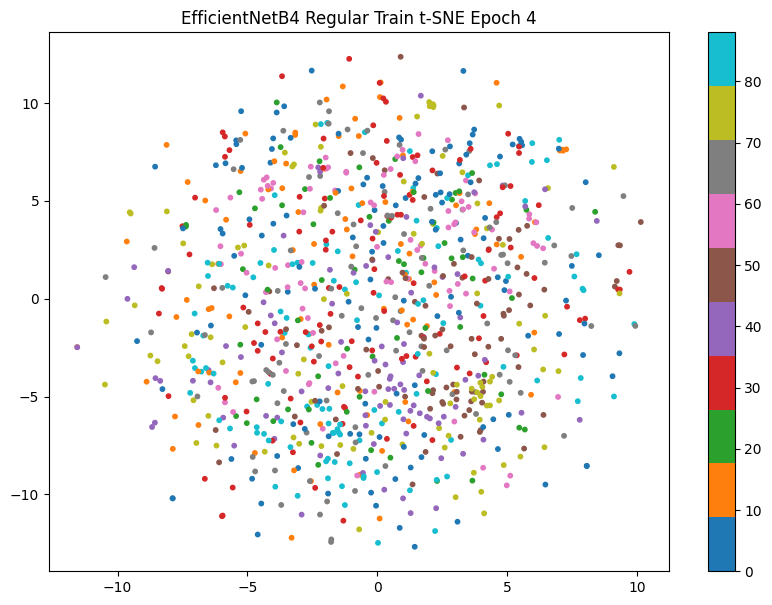

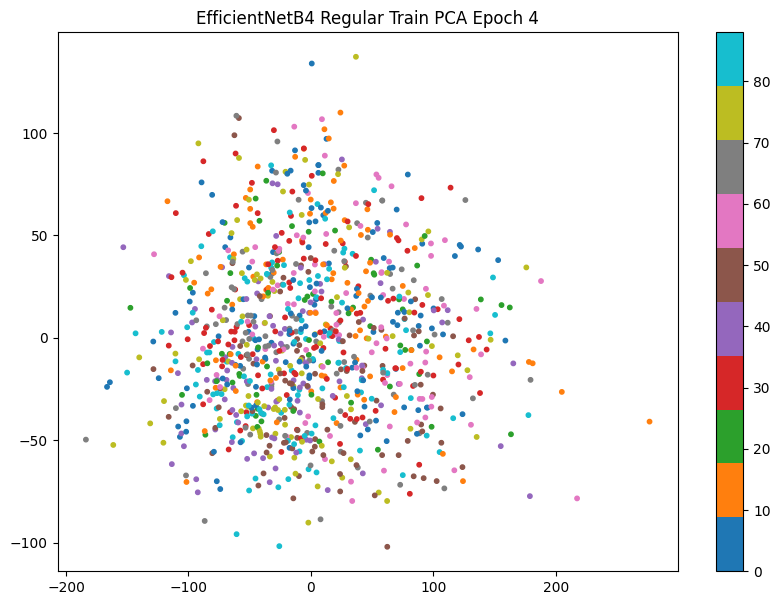

Saved EfficientNetB4 weights to EfficientNetB4_regular_train_epoch_4.pth
Starting Epoch 5/10
Epoch 5 Training Loss: 4.0236


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 4.0940, Accuracy: 316/3709 (9%)



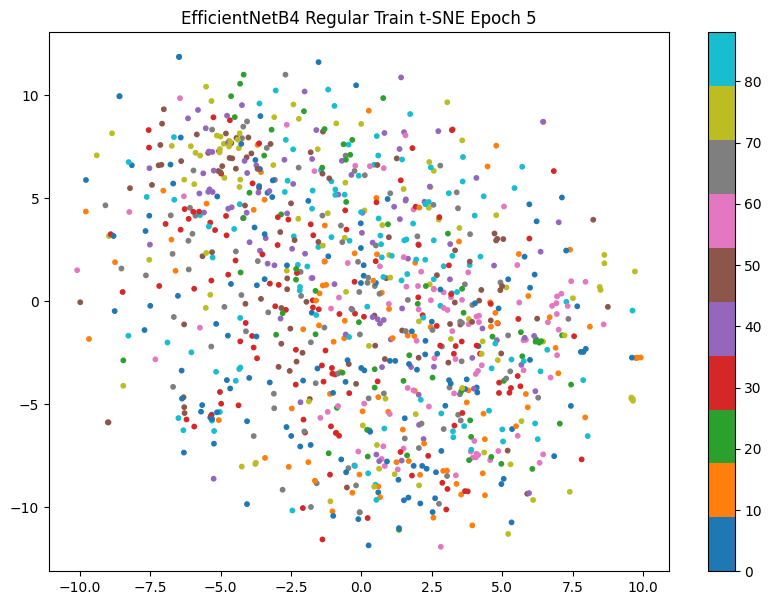

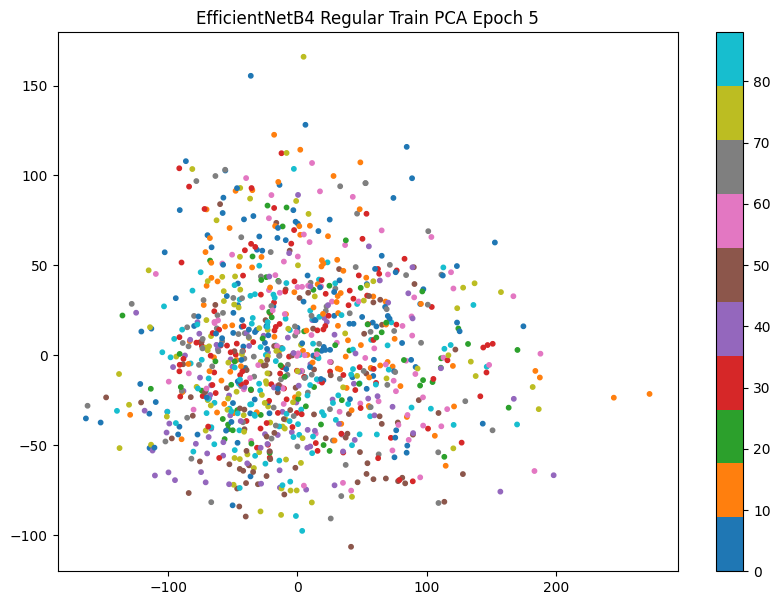

Saved EfficientNetB4 weights to EfficientNetB4_regular_train_epoch_5.pth
Starting Epoch 6/10
Epoch 6 Training Loss: 3.8301


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 3.8980, Accuracy: 502/3709 (14%)



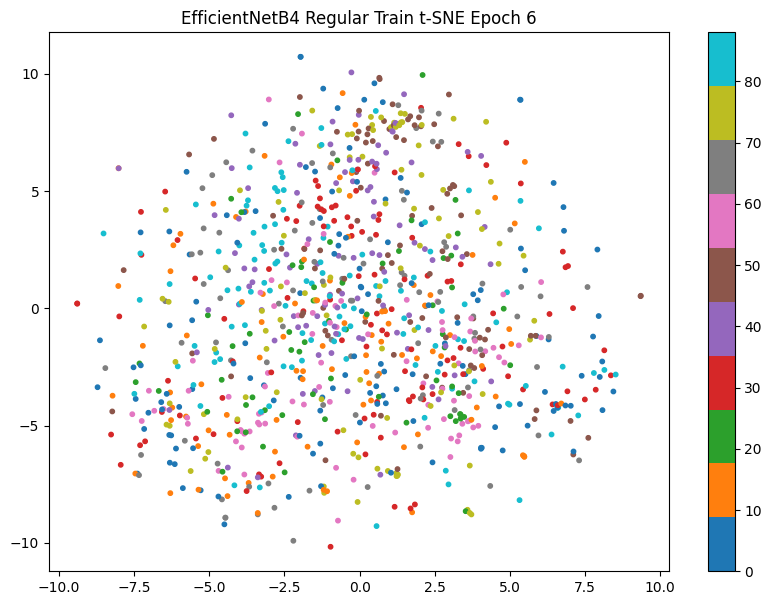

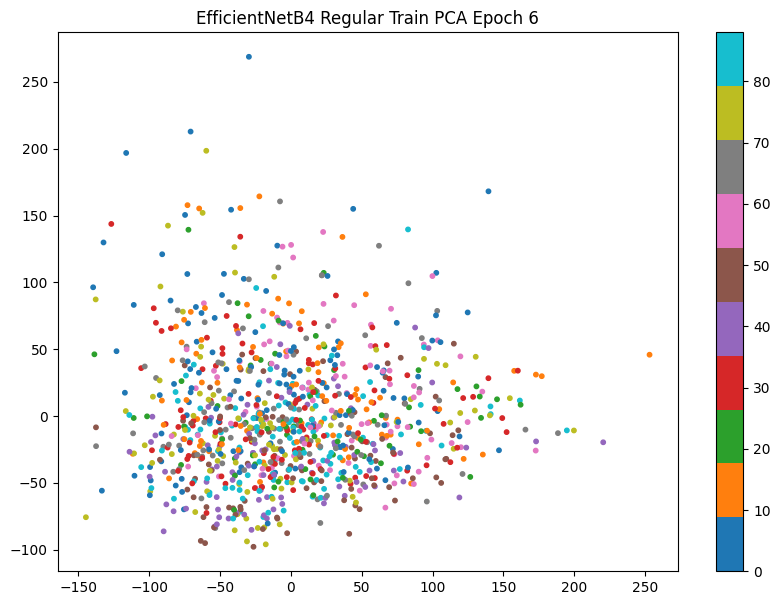

Saved EfficientNetB4 weights to EfficientNetB4_regular_train_epoch_6.pth
Starting Epoch 7/10
Epoch 7 Training Loss: 3.5279


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 3.6051, Accuracy: 803/3709 (22%)



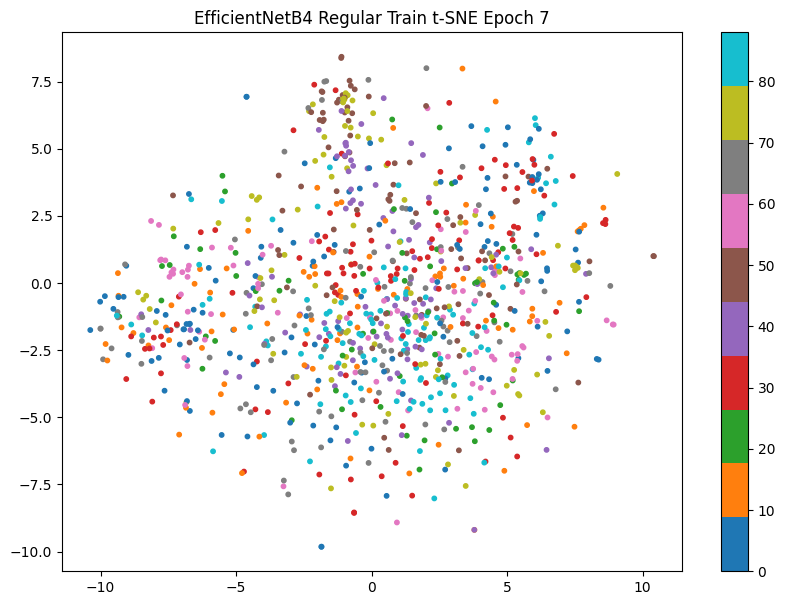

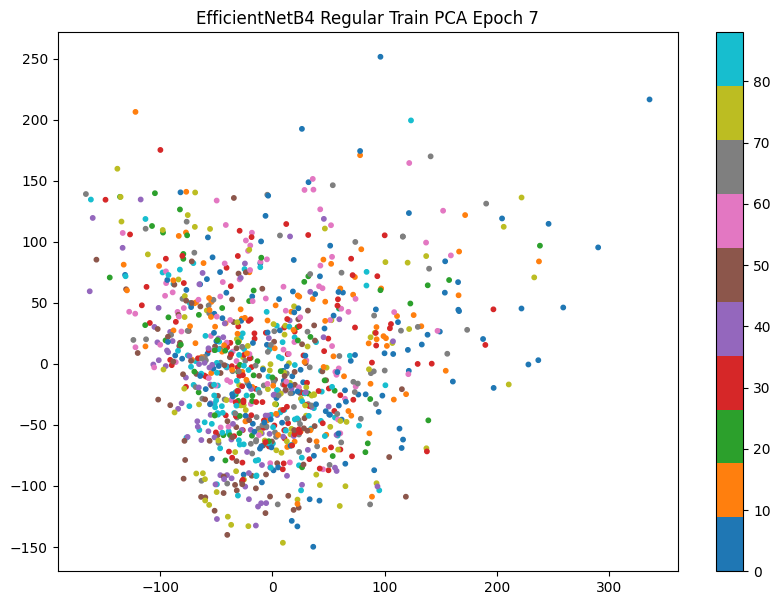

Saved EfficientNetB4 weights to EfficientNetB4_regular_train_epoch_7.pth
Starting Epoch 8/10
Epoch 8 Training Loss: 3.1368


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 3.2421, Accuracy: 1024/3709 (28%)



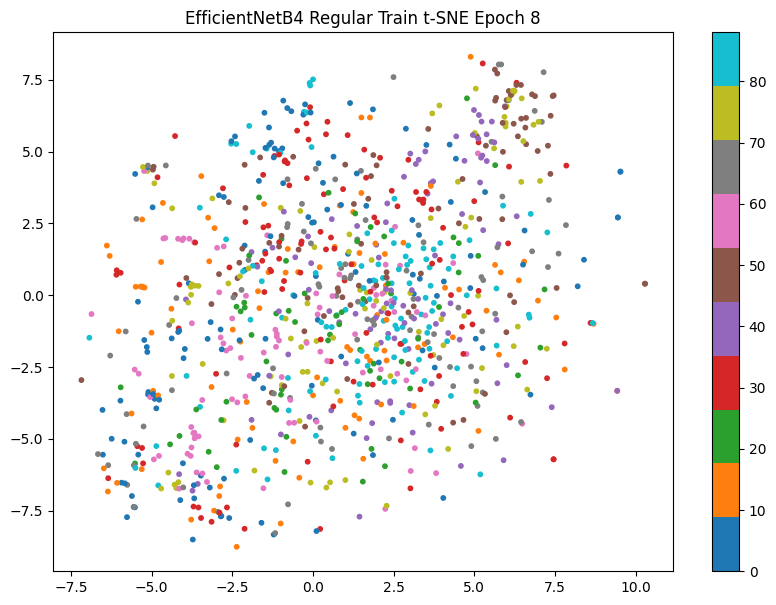

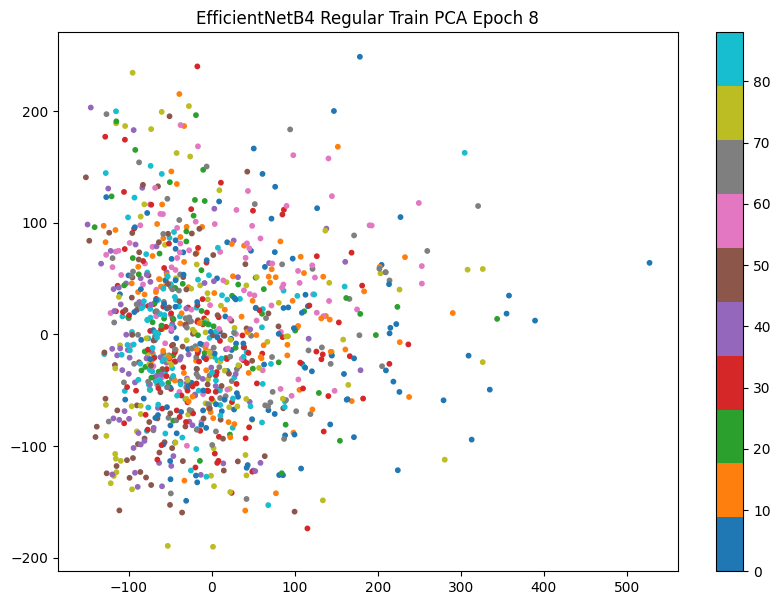

Saved EfficientNetB4 weights to EfficientNetB4_regular_train_epoch_8.pth
Starting Epoch 9/10
Epoch 9 Training Loss: 2.6940


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.8925, Accuracy: 1143/3709 (31%)



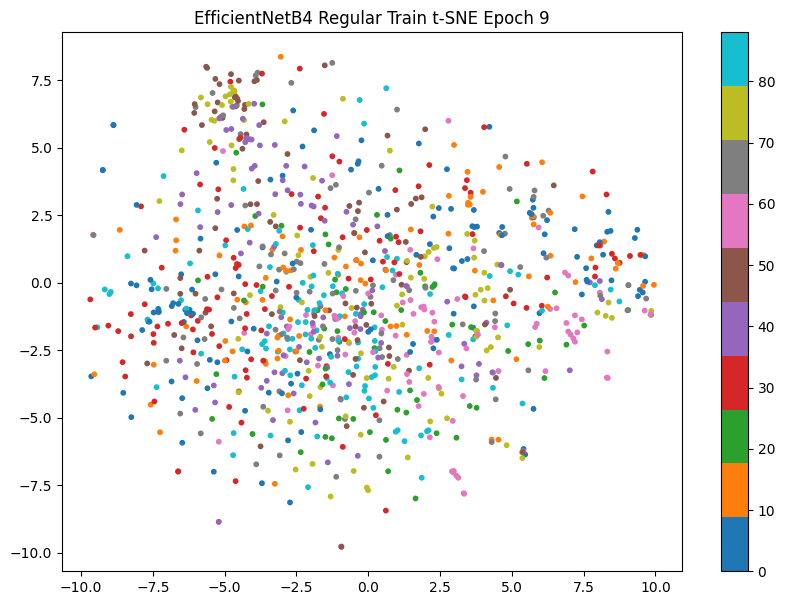

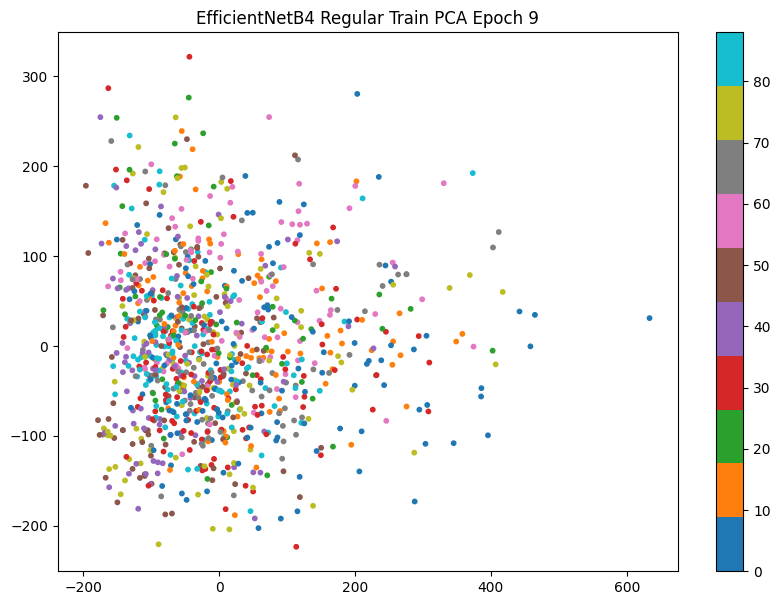

Saved EfficientNetB4 weights to EfficientNetB4_regular_train_epoch_9.pth
Starting Epoch 10/10
Epoch 10 Training Loss: 2.3230


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.7073, Accuracy: 1231/3709 (33%)



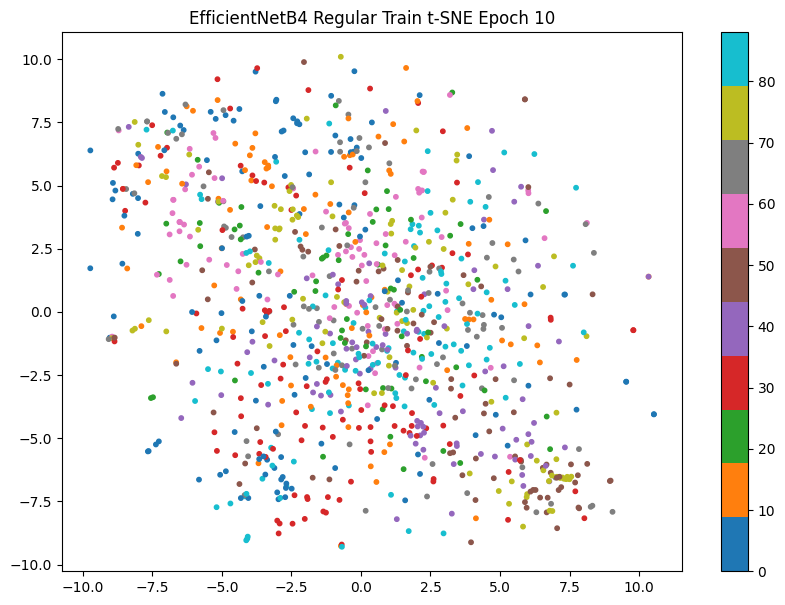

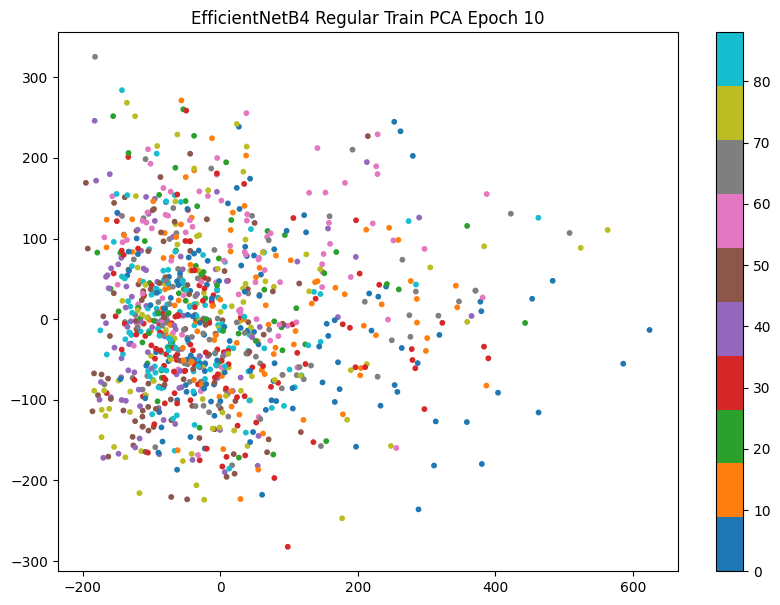

Saved EfficientNetB4 weights to EfficientNetB4_regular_train_epoch_10.pth

Training ConvNeXtTiny...
Starting Epoch 1/10
Epoch 1 Training Loss: 4.2170


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 3.8790, Accuracy: 614/3709 (17%)



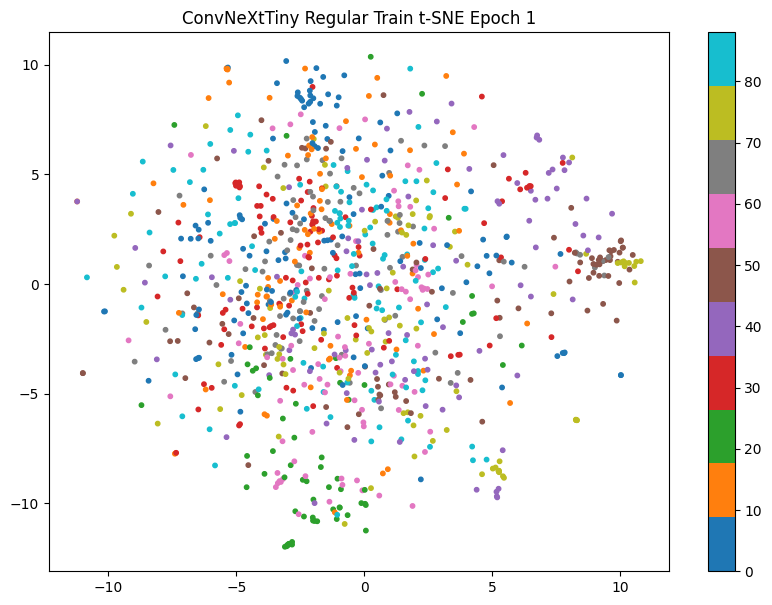

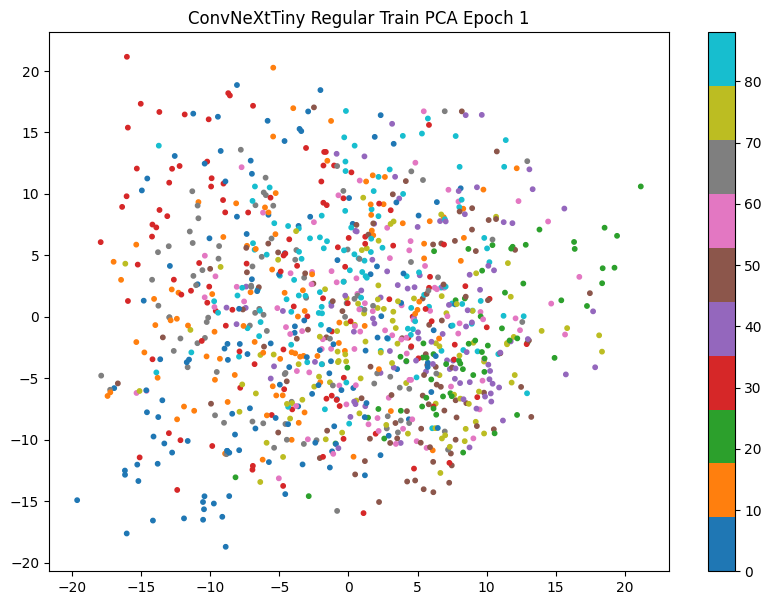

Saved ConvNeXtTiny weights to ConvNeXtTiny_regular_train_epoch_1.pth
Starting Epoch 2/10
Epoch 2 Training Loss: 3.2485


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 3.2486, Accuracy: 1099/3709 (30%)



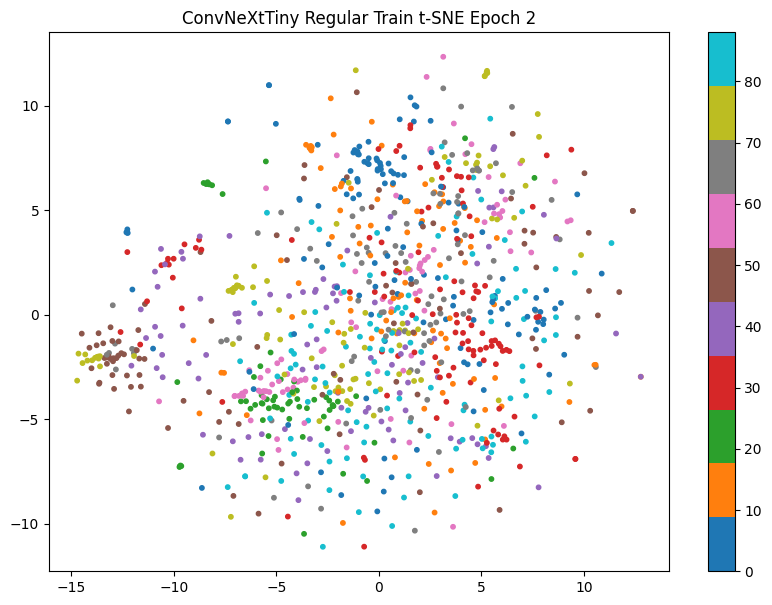

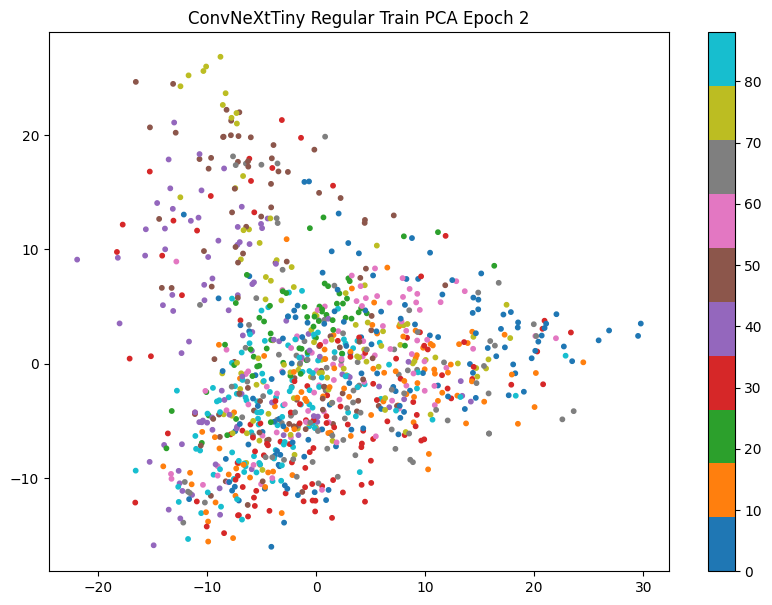

Saved ConvNeXtTiny weights to ConvNeXtTiny_regular_train_epoch_2.pth
Starting Epoch 3/10
Epoch 3 Training Loss: 2.3140


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.7718, Accuracy: 1442/3709 (39%)



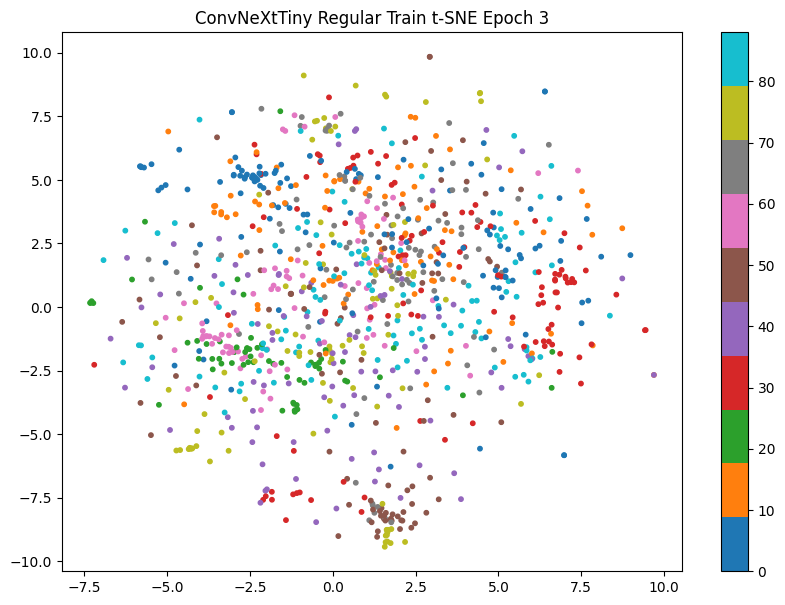

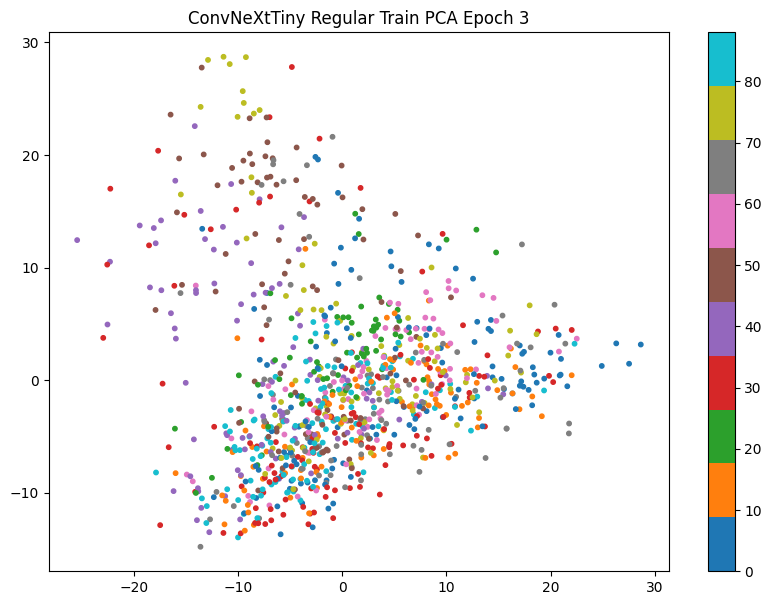

Saved ConvNeXtTiny weights to ConvNeXtTiny_regular_train_epoch_3.pth
Starting Epoch 4/10
Epoch 4 Training Loss: 1.5414


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.4528, Accuracy: 1659/3709 (45%)



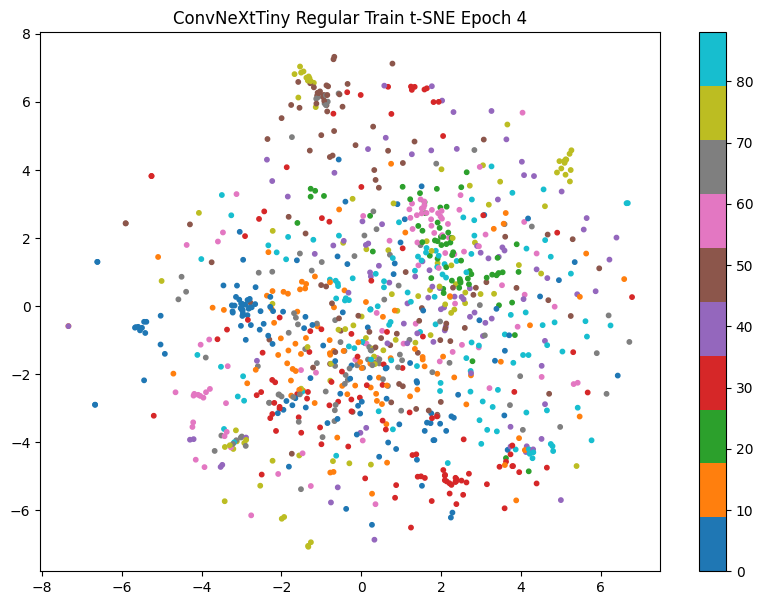

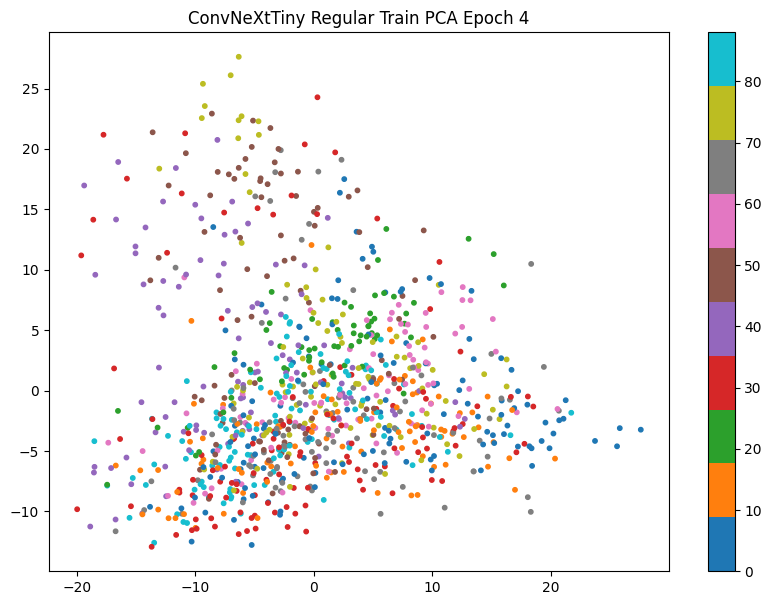

Saved ConvNeXtTiny weights to ConvNeXtTiny_regular_train_epoch_4.pth
Starting Epoch 5/10
Epoch 5 Training Loss: 0.9510


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.2662, Accuracy: 1793/3709 (48%)



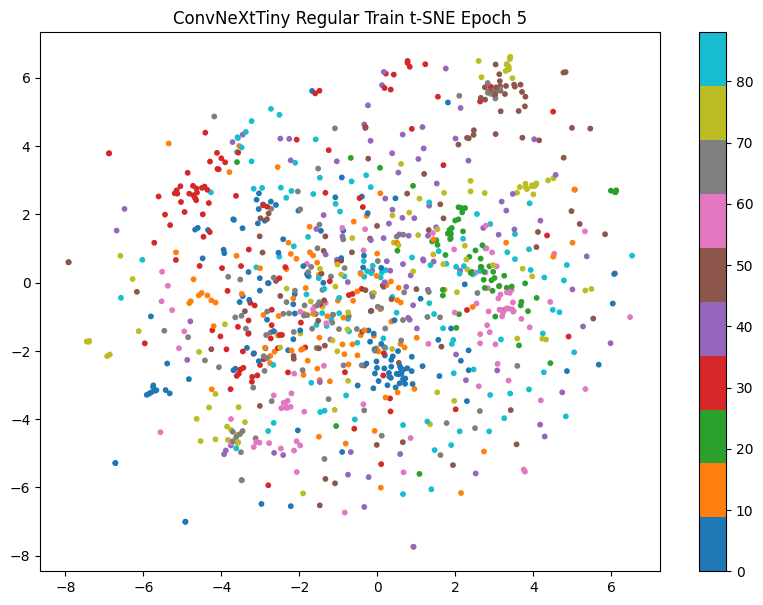

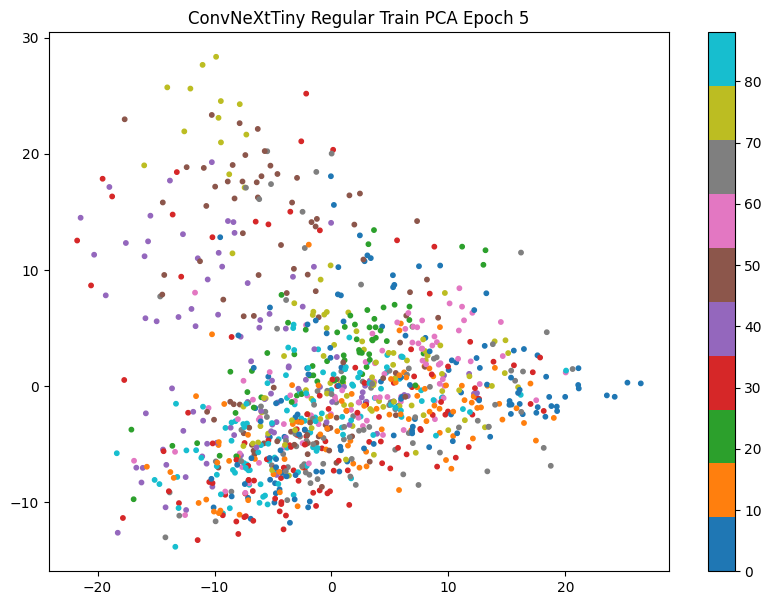

Saved ConvNeXtTiny weights to ConvNeXtTiny_regular_train_epoch_5.pth
Starting Epoch 6/10
Epoch 6 Training Loss: 0.5861


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.1433, Accuracy: 1865/3709 (50%)



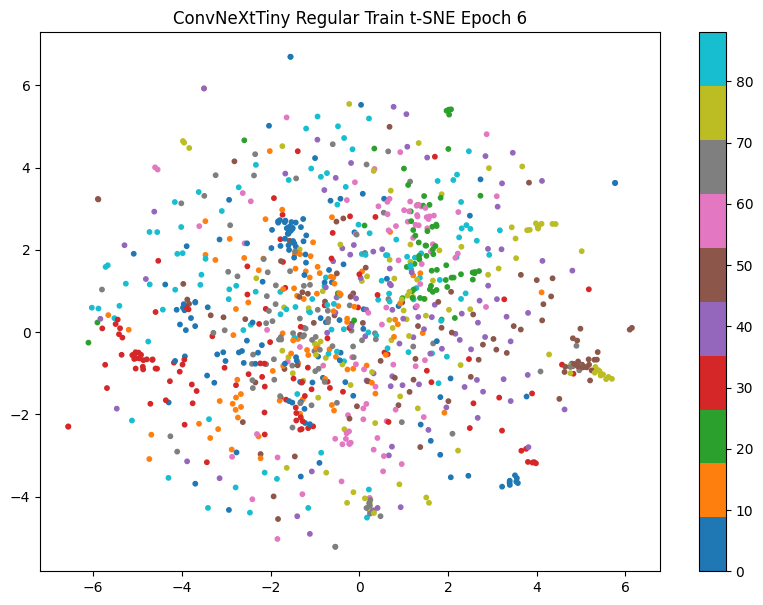

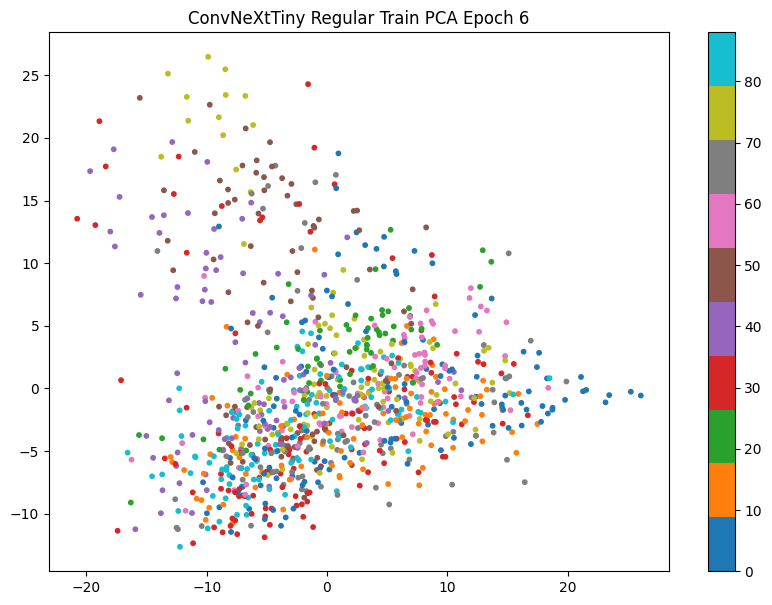

Saved ConvNeXtTiny weights to ConvNeXtTiny_regular_train_epoch_6.pth
Starting Epoch 7/10
Epoch 7 Training Loss: 0.3630


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.0820, Accuracy: 1879/3709 (51%)



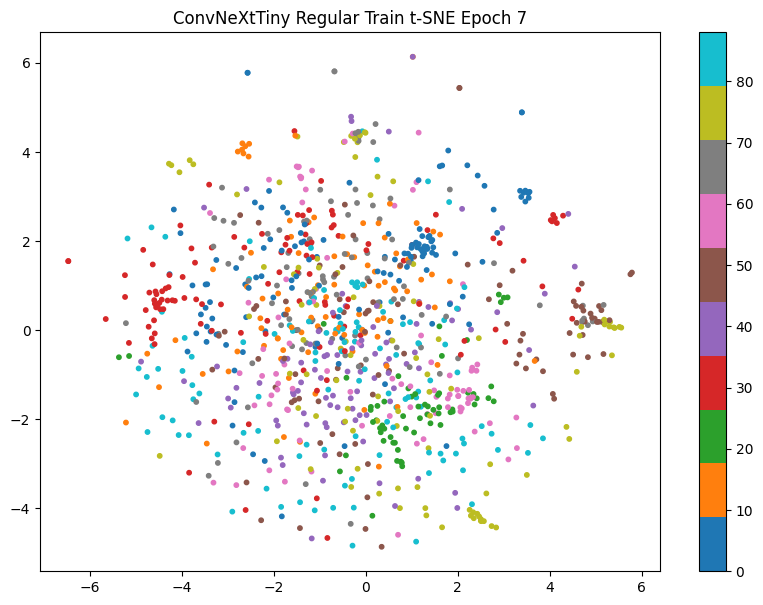

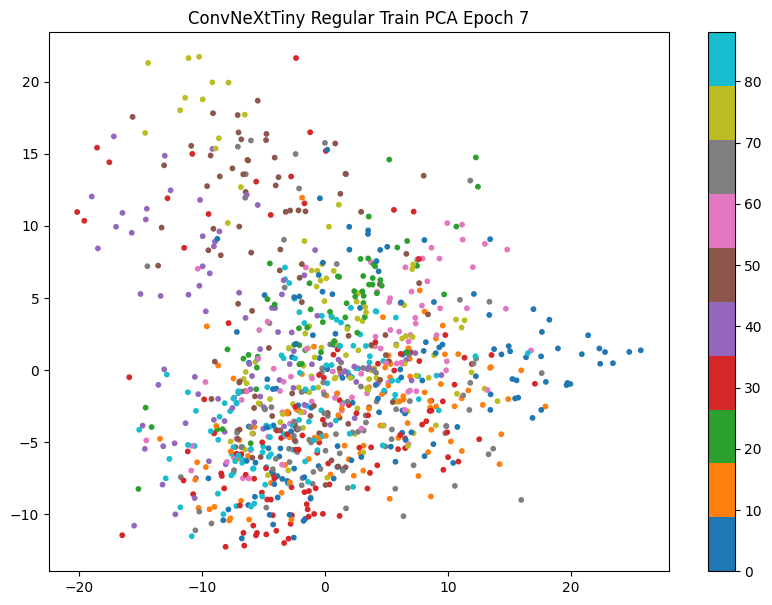

Saved ConvNeXtTiny weights to ConvNeXtTiny_regular_train_epoch_7.pth
Starting Epoch 8/10
Epoch 8 Training Loss: 0.2483


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.0320, Accuracy: 1910/3709 (51%)



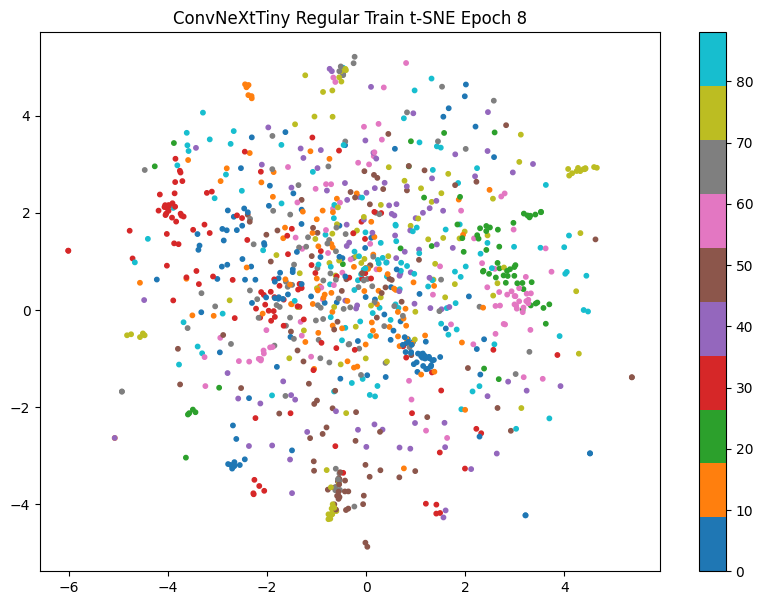

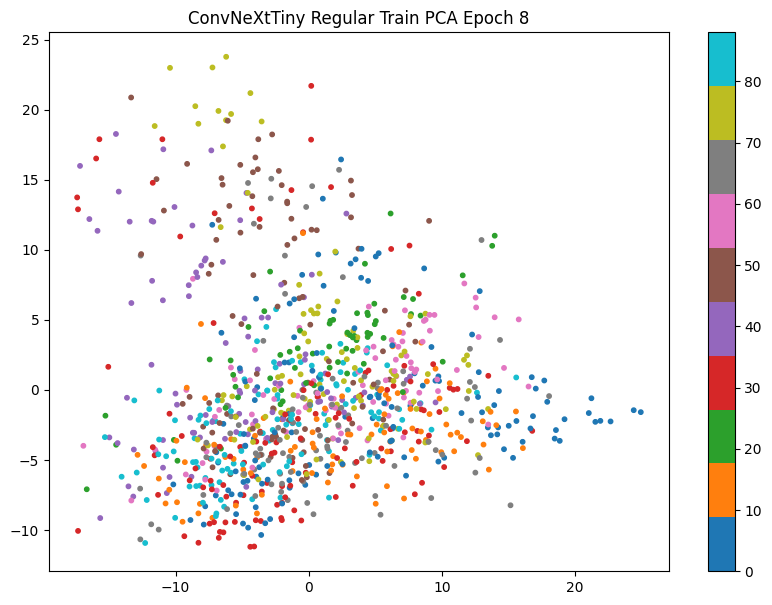

Saved ConvNeXtTiny weights to ConvNeXtTiny_regular_train_epoch_8.pth
Starting Epoch 9/10
Epoch 9 Training Loss: 0.1678


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 1.9974, Accuracy: 1902/3709 (51%)



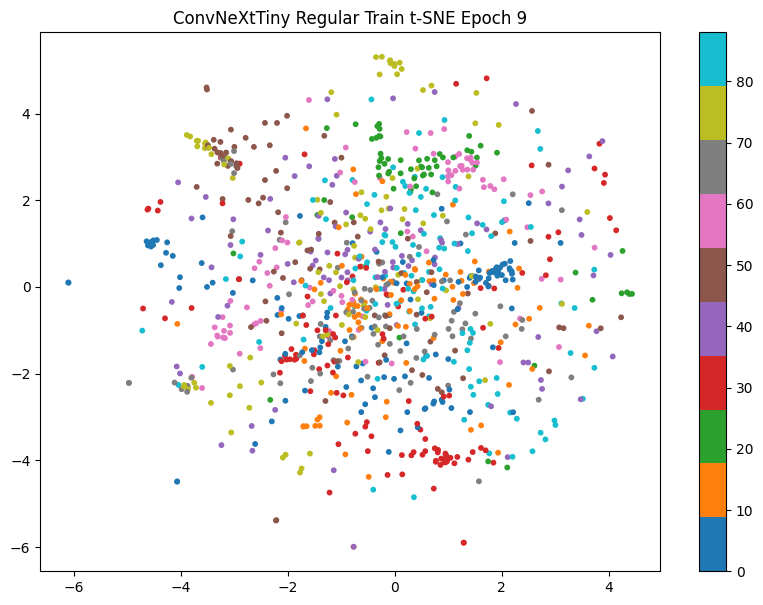

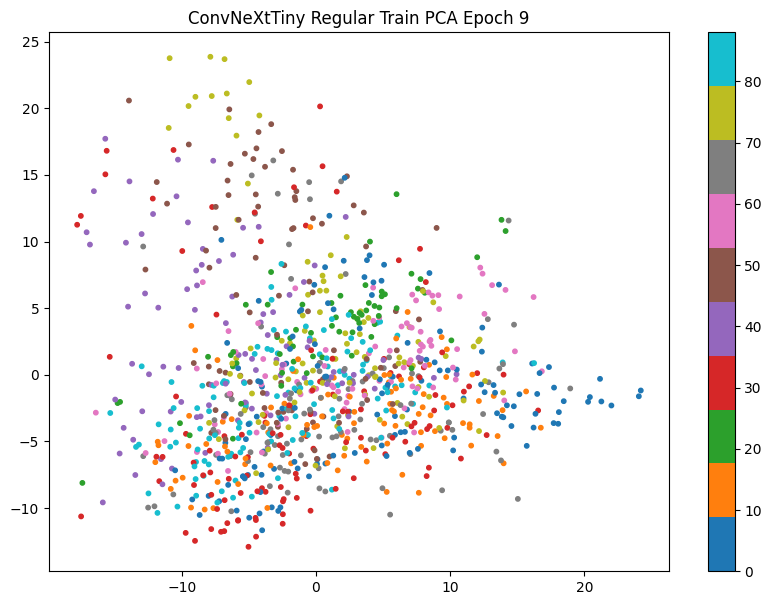

Saved ConvNeXtTiny weights to ConvNeXtTiny_regular_train_epoch_9.pth
Starting Epoch 10/10
Epoch 10 Training Loss: 0.1361


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 1.9832, Accuracy: 1901/3709 (51%)



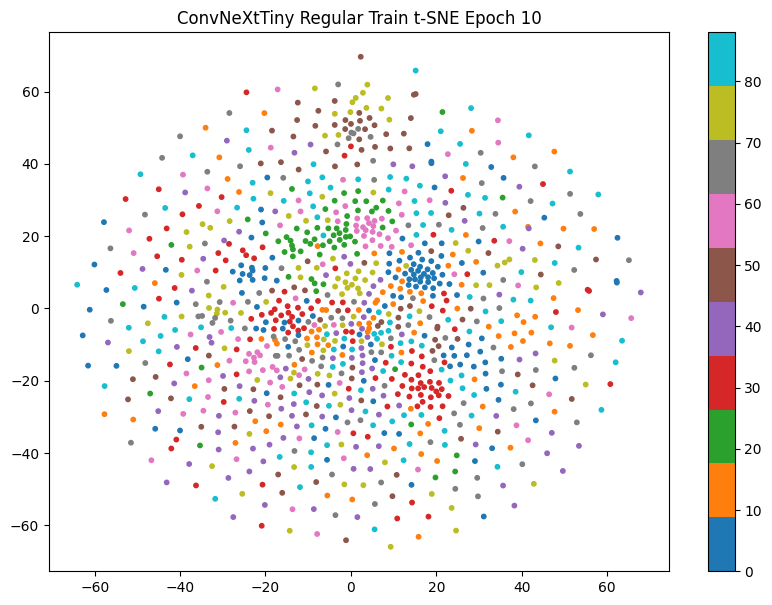

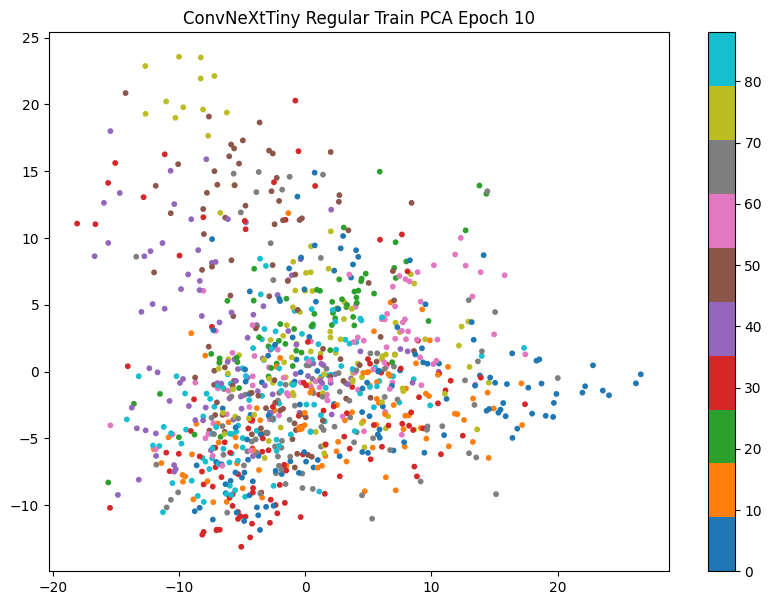

Saved ConvNeXtTiny weights to ConvNeXtTiny_regular_train_epoch_10.pth

Training DS_FusionNet...
Starting Epoch 1/10
Epoch 1 Training Loss: 4.2106


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 3.5951, Accuracy: 705/3709 (19%)



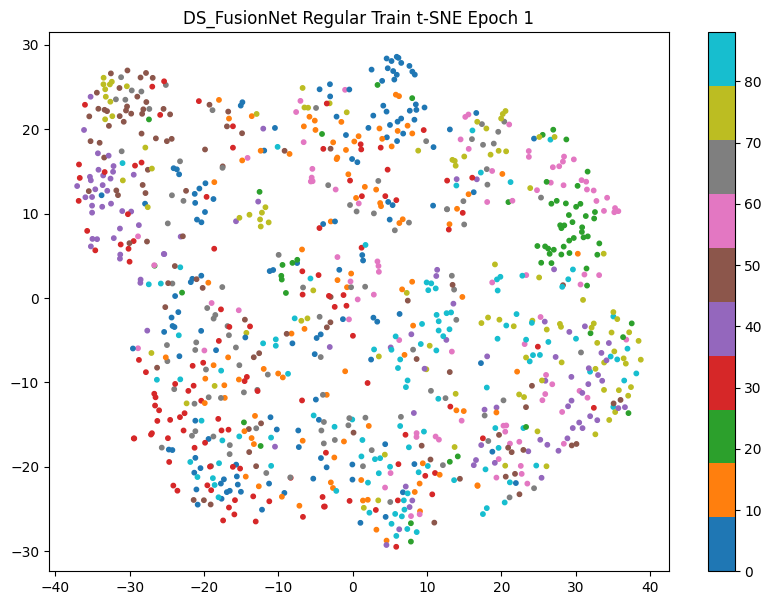

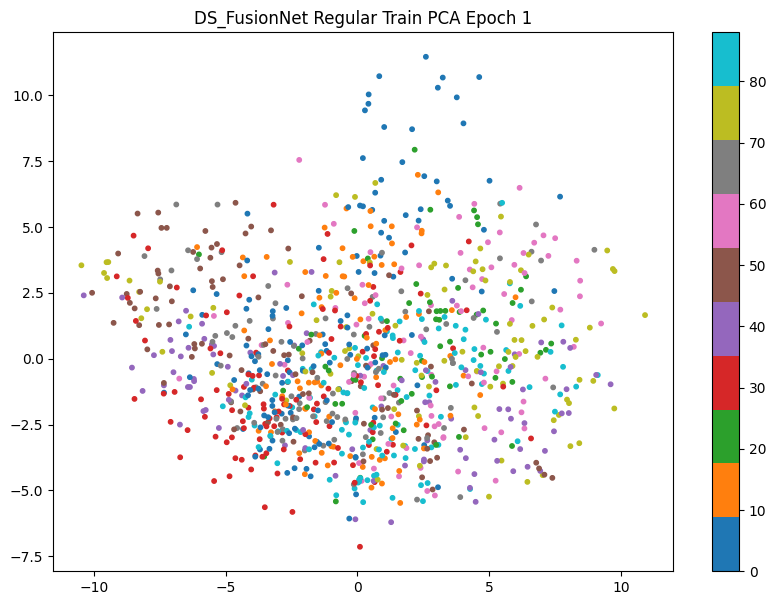

Saved DS_FusionNet weights to DS_FusionNet_regular_train_epoch_1.pth
Starting Epoch 2/10
Epoch 2 Training Loss: 2.4392


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.5378, Accuracy: 1258/3709 (34%)



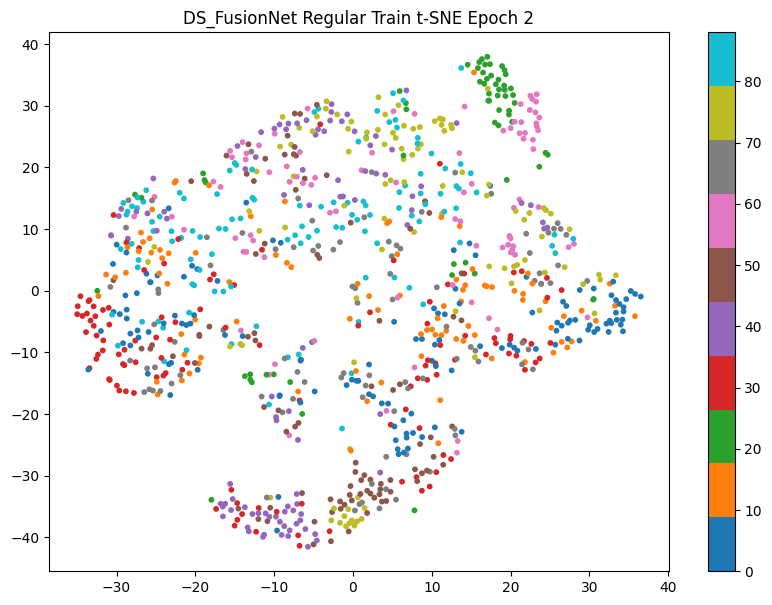

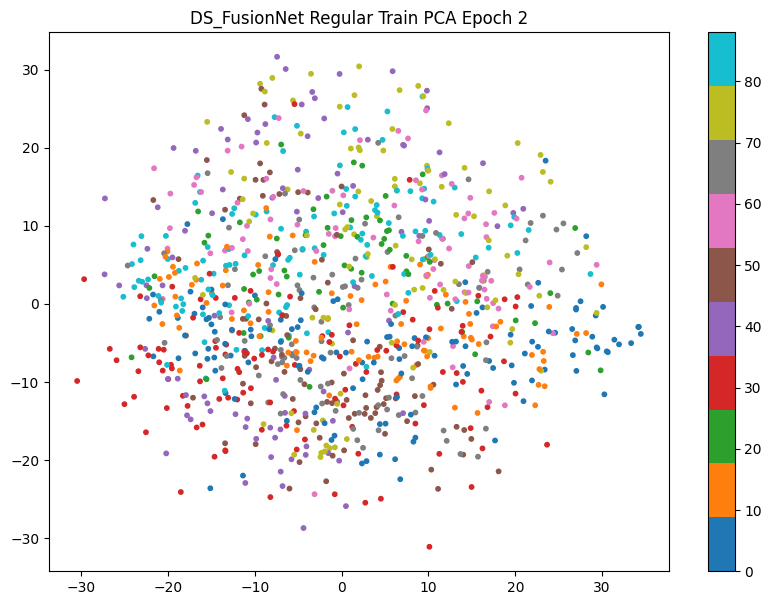

Saved DS_FusionNet weights to DS_FusionNet_regular_train_epoch_2.pth
Starting Epoch 3/10
Epoch 3 Training Loss: 1.0362


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.1888, Accuracy: 1516/3709 (41%)



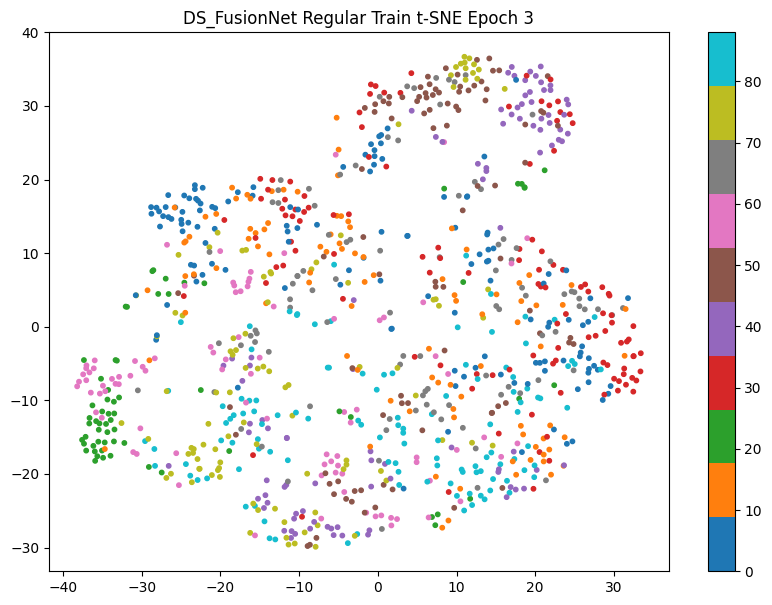

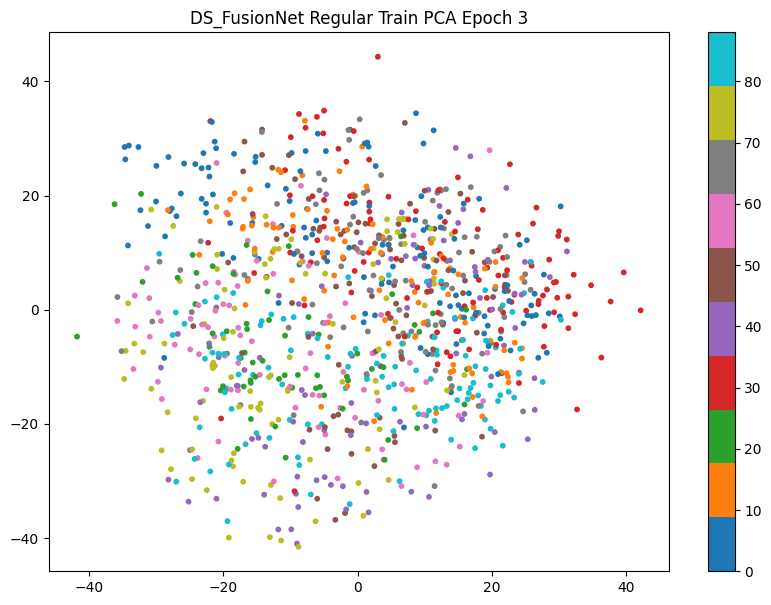

Saved DS_FusionNet weights to DS_FusionNet_regular_train_epoch_3.pth
Starting Epoch 4/10
Epoch 4 Training Loss: 0.3534


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.1821, Accuracy: 1587/3709 (43%)



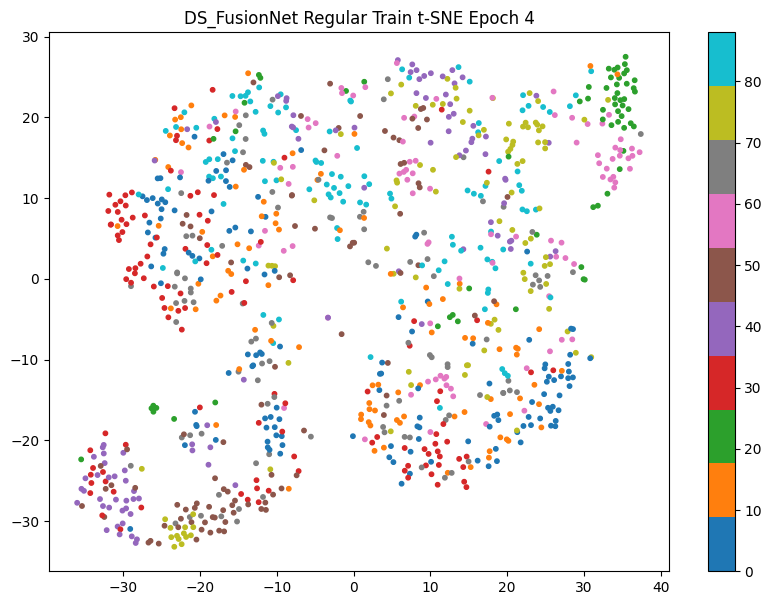

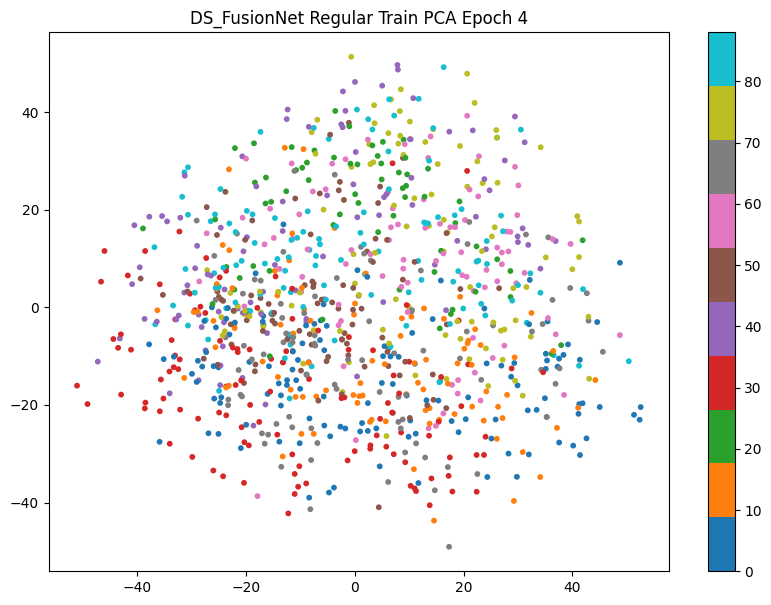

Saved DS_FusionNet weights to DS_FusionNet_regular_train_epoch_4.pth
Starting Epoch 5/10
Epoch 5 Training Loss: 0.1615


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.2451, Accuracy: 1574/3709 (42%)



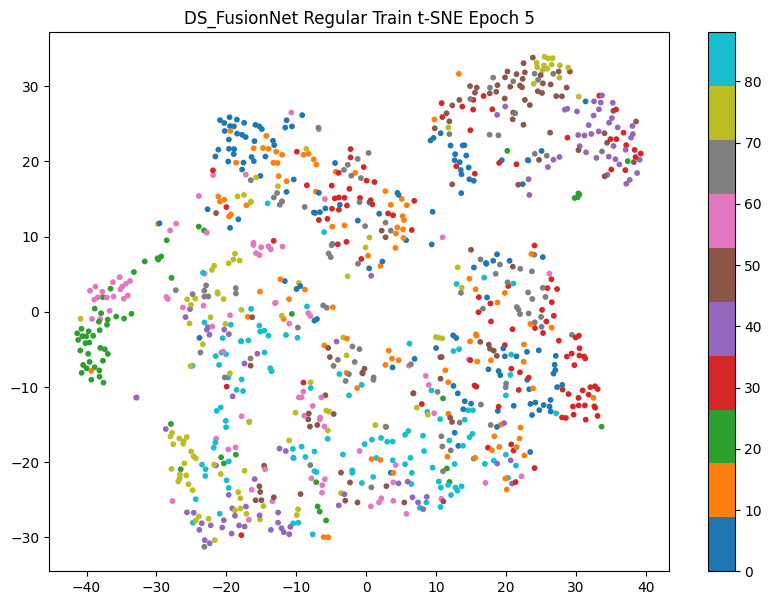

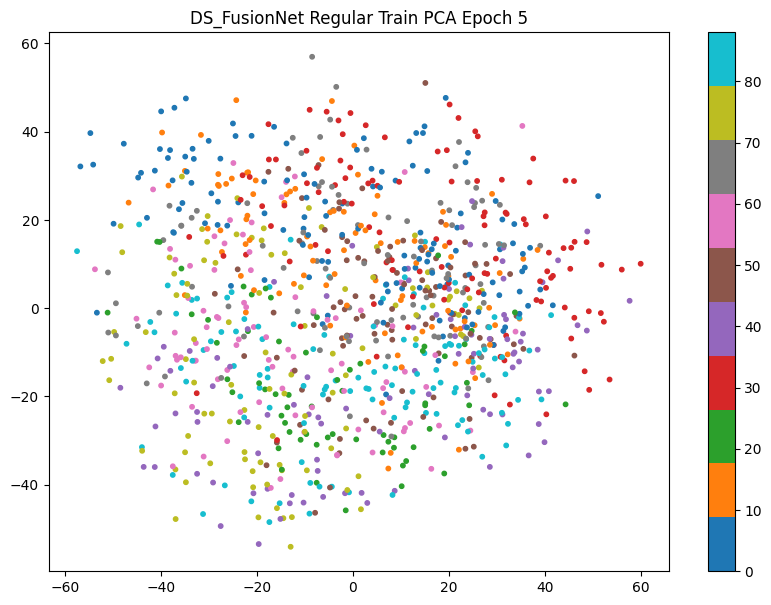

Saved DS_FusionNet weights to DS_FusionNet_regular_train_epoch_5.pth
Starting Epoch 6/10
Epoch 6 Training Loss: 0.0943


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.3023, Accuracy: 1633/3709 (44%)



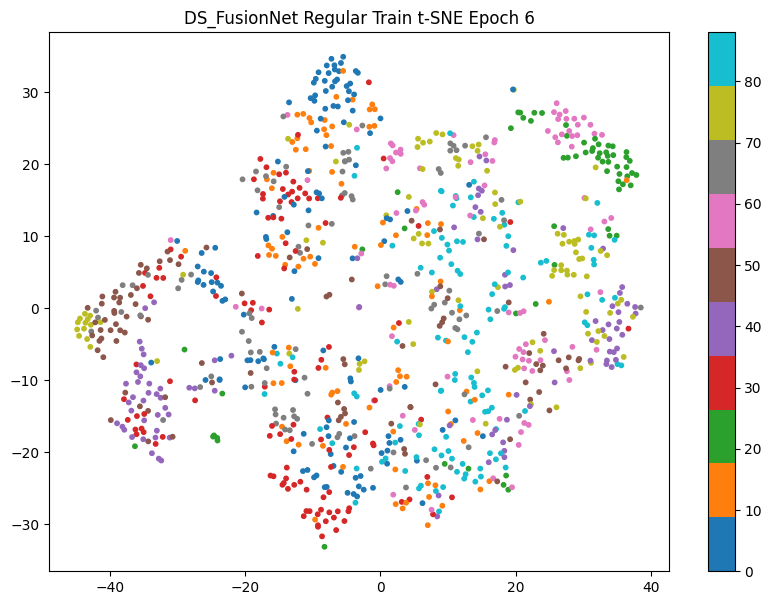

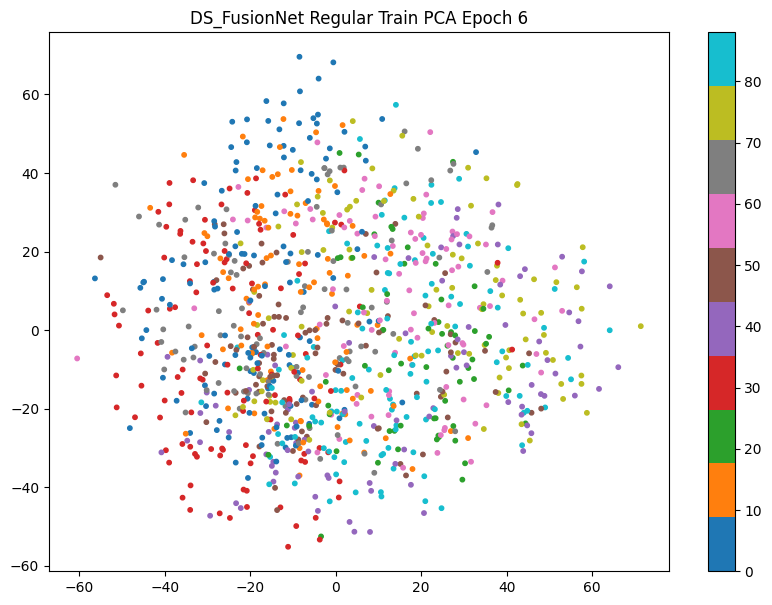

Saved DS_FusionNet weights to DS_FusionNet_regular_train_epoch_6.pth
Starting Epoch 7/10
Epoch 7 Training Loss: 0.0597


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.3811, Accuracy: 1656/3709 (45%)



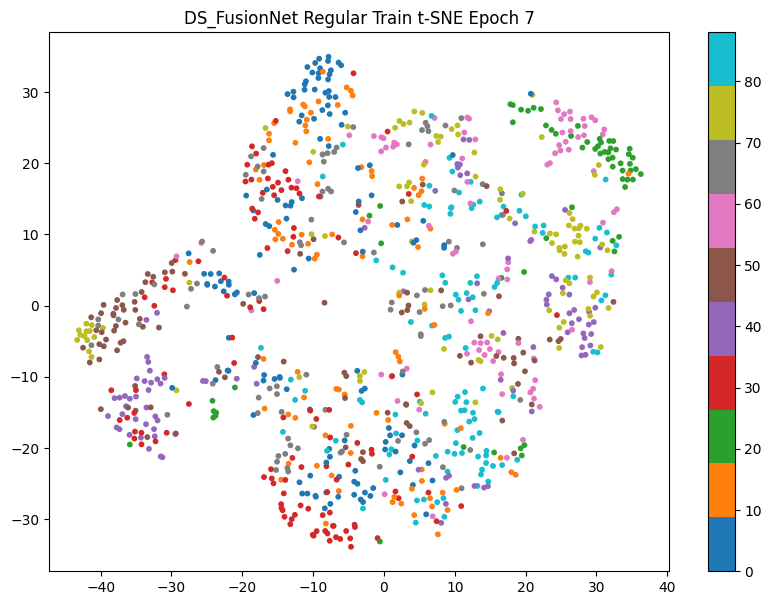

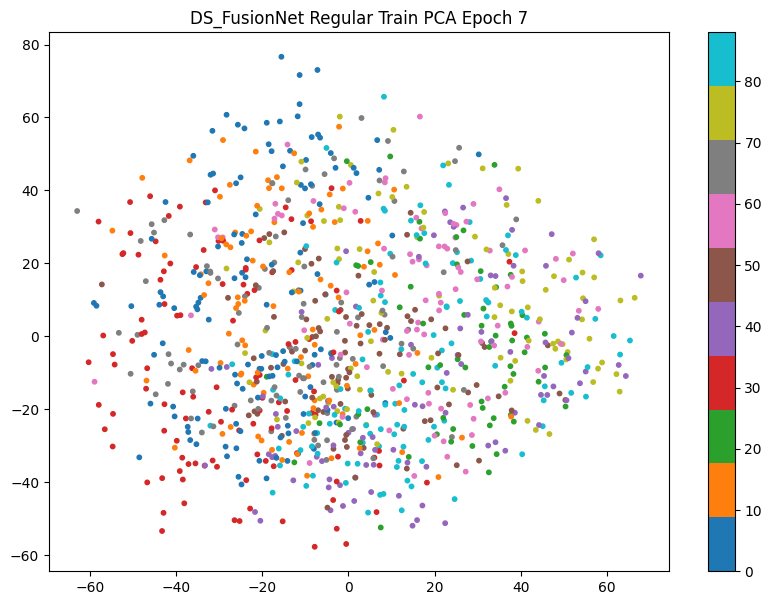

Saved DS_FusionNet weights to DS_FusionNet_regular_train_epoch_7.pth
Starting Epoch 8/10
Epoch 8 Training Loss: 0.0604


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.4628, Accuracy: 1619/3709 (44%)



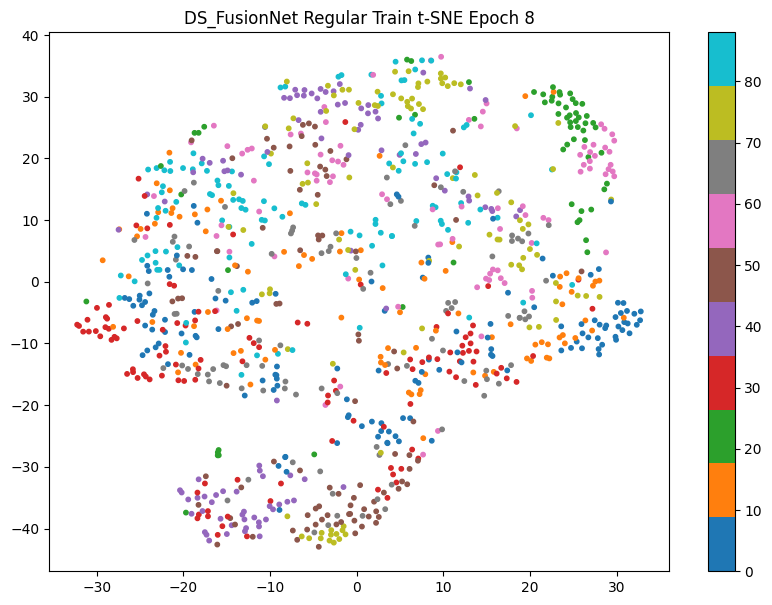

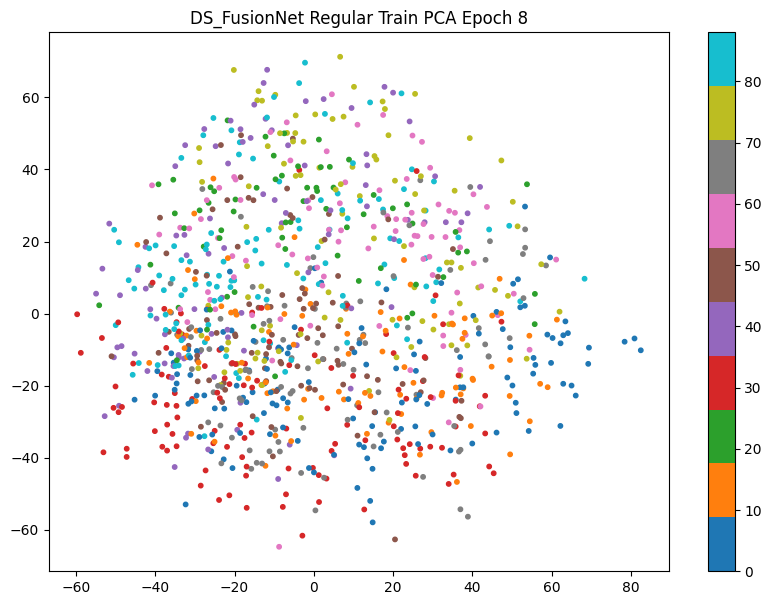

Saved DS_FusionNet weights to DS_FusionNet_regular_train_epoch_8.pth
Starting Epoch 9/10
Epoch 9 Training Loss: 0.0550


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.3592, Accuracy: 1682/3709 (45%)



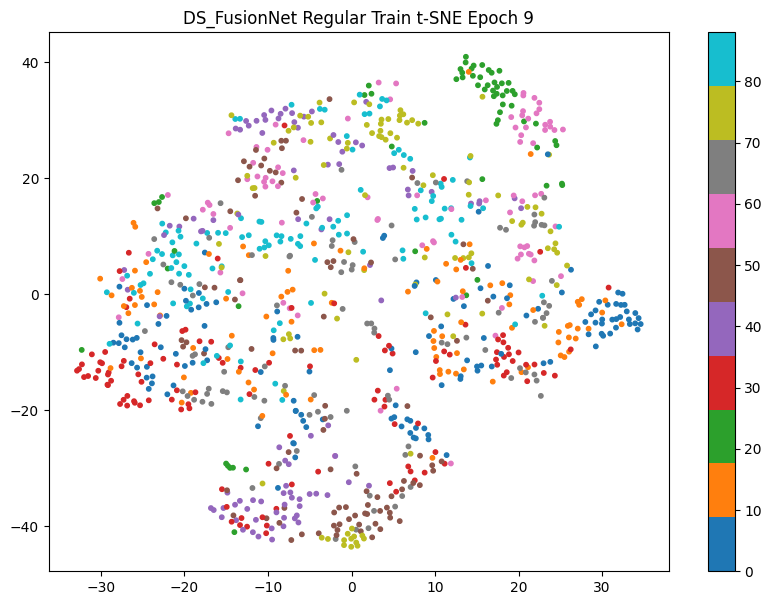

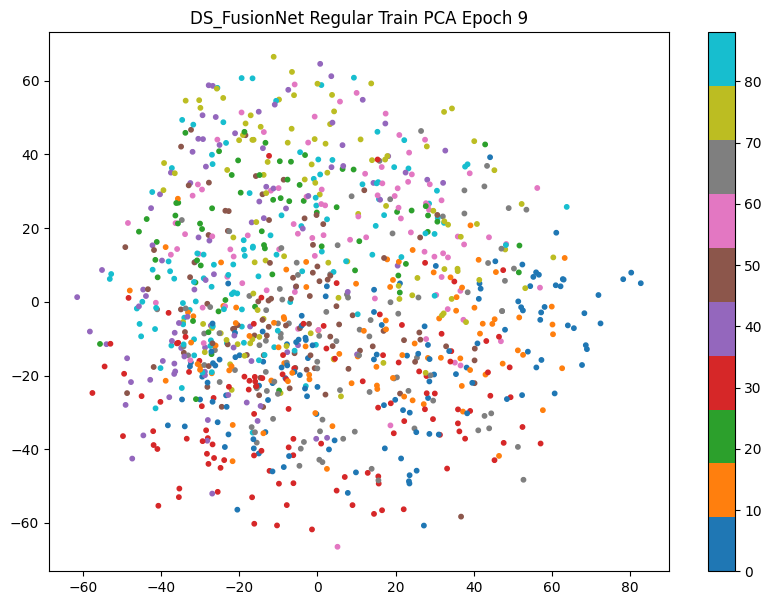

Saved DS_FusionNet weights to DS_FusionNet_regular_train_epoch_9.pth
Starting Epoch 10/10
Epoch 10 Training Loss: 0.0439


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.6104, Accuracy: 1570/3709 (42%)



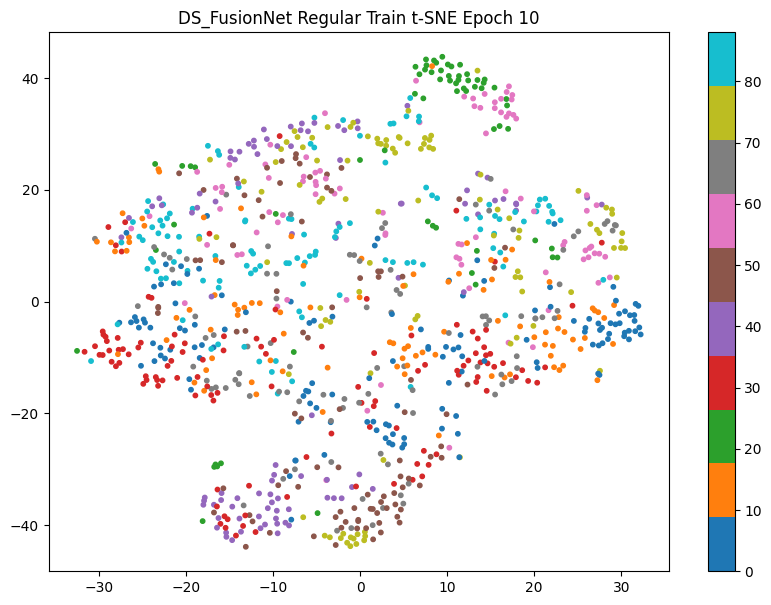

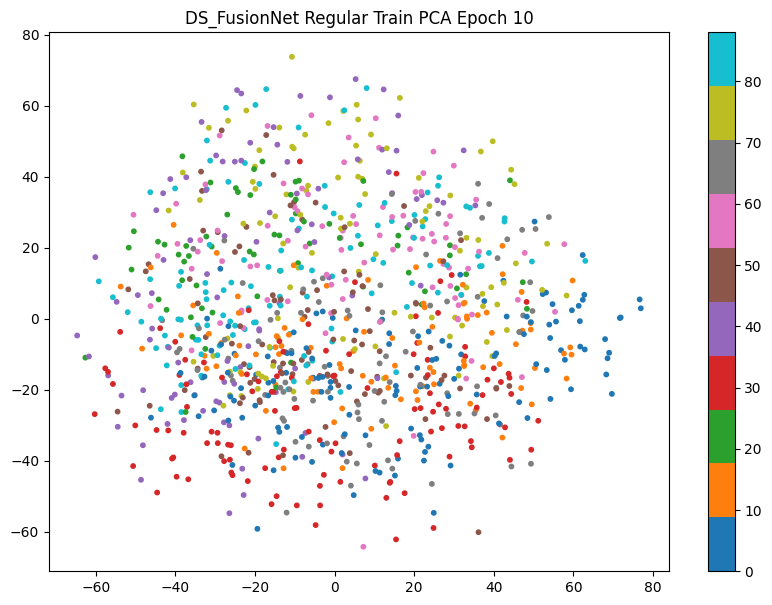

Saved DS_FusionNet weights to DS_FusionNet_regular_train_epoch_10.pth


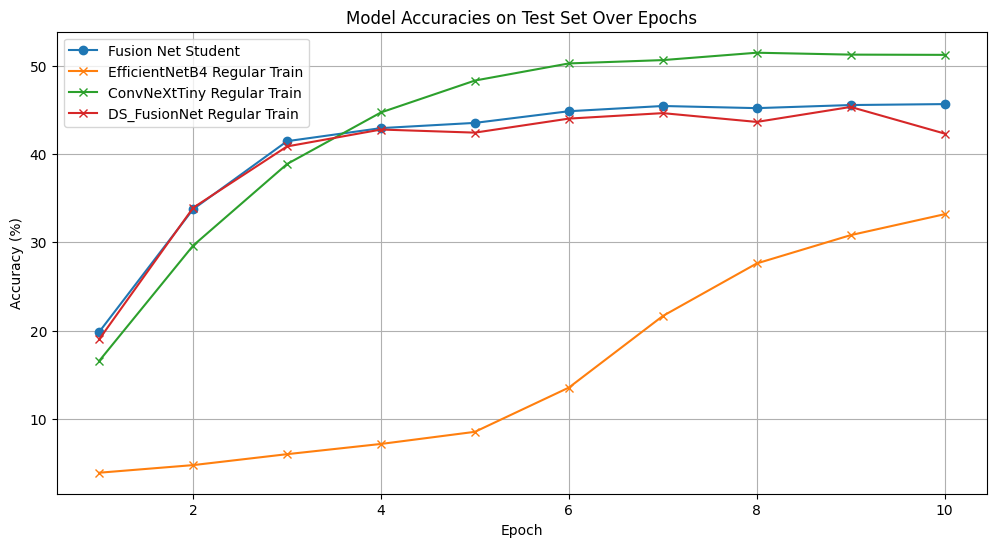

In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms, models
from torch.utils.data import DataLoader, Dataset
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import os
from PIL import Image

# 自定义数据集类
class PlantDocDataset(Dataset):
    def __init__(self, root_dir, txt_path, transform=None, train=True, train_ratio=0.8, random_seed=42):
        self.root_dir = root_dir
        self.transform = transform
        self.samples = []

        # 解析txt文件
        with open(txt_path, 'r') as f:
            lines = f.readlines()

        for line in lines:
            line = line.strip()
            if not line:
                continue
            parts = line.split('=')
            if len(parts) < 3:
                continue
            img_rel_path, label_str, _ = parts[0], parts[1], parts[2]
            img_full_path = os.path.join(root_dir, 'images', img_rel_path.replace('/', os.path.sep))
            if not os.path.exists(img_full_path):
                continue
            label = int(label_str)
            self.samples.append((img_full_path, label))

        # 随机分割数据集
        num_samples = len(self.samples)
        indices = list(range(num_samples))
        np.random.seed(random_seed)
        np.random.shuffle(indices)
        split_idx = int(train_ratio * num_samples)
        self.indices = indices[:split_idx] if train else indices[split_idx:]

    def __len__(self):
        return len(self.indices)

    def __getitem__(self, idx):
        actual_idx = self.indices[idx]
        img_path, label = self.samples[actual_idx]
        image = Image.open(img_path).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image, label

# 数据预处理
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# 创建数据集和数据加载器
train_dataset = PlantDocDataset(
    root_dir=r'E:\data1\plantdoc',
    txt_path=r'E:\data1\plantdoc\trainval.txt',
    transform=transform,
    train=True,
    train_ratio=0.1  # 减少训练集比例到10%
)

test_dataset = PlantDocDataset(
    root_dir=r'E:\data1\plantdoc',
    txt_path=r'E:\data1\plantdoc\trainval.txt',
    transform=transform,
    train=False
)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False)

# 修改模型输出为89类
def load_efficientnet_b4(pretrained=True):
    model = models.efficientnet_b4(pretrained=pretrained)
    num_ftrs = model.classifier[1].in_features
    model.classifier[1] = nn.Linear(num_ftrs, 89)
    return model

def load_convnext_tiny(pretrained=True):
    model = models.convnext_tiny(pretrained=pretrained)
    num_ftrs = model.classifier[-1].in_features
    model.classifier[-1] = nn.Linear(num_ftrs, 89)
    return model

class DS_FusionNet(nn.Module):
    def __init__(self):
        super(DS_FusionNet, self).__init__()
        self.efficientnet = load_efficientnet_b4(pretrained=True)
        self.convnext = load_convnext_tiny(pretrained=True)
        self.deformable_conv = nn.Conv2d(2560, 64, kernel_size=3, padding=1)
        self.avgpool = nn.AdaptiveAvgPool2d((7, 7))
        self.fc = nn.Linear(64 * 7 * 7, 89)  # 89 classes

    def forward(self, x):
        eff_out_feat = self.efficientnet.features(x)
        convnext_out_feat = self.convnext.features(x)
        fused_feat = torch.cat((eff_out_feat, convnext_out_feat), dim=1)
        fused_feat = self.deformable_conv(fused_feat)
        fused_feat = self.avgpool(fused_feat)
        fused_feat = fused_feat.view(fused_feat.size(0), -1)
        out = self.fc(fused_feat)
        return out

# 双向知识蒸馏损失函数
def distillation_loss(y, labels, teacher_scores, T=3, alpha=0.5):
    KD_loss = nn.KLDivLoss()(nn.functional.log_softmax(y / T, dim=1),
                             nn.functional.softmax(teacher_scores / T, dim=1)) * (alpha * T * T) + \
              nn.CrossEntropyLoss()(y, labels) * (1. - alpha)
    return KD_loss

# 训练函数
def train(model, teacher_model, device, train_loader, optimizer, epoch, accumulation_steps=4):
    model.train()
    teacher_model.eval() if teacher_model is not None else model.train()
    running_loss = 0.0
    for batch_idx, (data, target) in enumerate(train_loader):
        data, target = data.to(device), target.to(device)
        
        if teacher_model is not None:
            output_student = model(data)
            with torch.no_grad():
                output_teacher = teacher_model(data)
            loss = distillation_loss(output_student, target, output_teacher) / accumulation_steps
        else:
            output = model(data)
            loss = nn.CrossEntropyLoss()(output, target) / accumulation_steps
        
        loss.backward()
        
        if ((batch_idx + 1) % accumulation_steps == 0) or (batch_idx + 1 == len(train_loader)):
            optimizer.step()
            optimizer.zero_grad()
        
        running_loss += loss.item() * accumulation_steps
    
    print(f'Epoch {epoch} Training Loss: {running_loss / len(train_loader):.4f}')

# 测试函数
def test(model, device, test_loader):
    model.eval()
    test_loss = 0
    correct = 0
    with torch.no_grad():
        for data, target in test_loader:
            data, target = data.to(device), target.to(device)
            output = model(data)
            test_loss += nn.CrossEntropyLoss(reduction='sum')(output, target).item()  # sum up batch loss
            pred = output.argmax(dim=1, keepdim=True)  # get the index of the max log-probability
            correct += pred.eq(target.view_as(pred)).sum().item()

    test_loss /= len(test_loader.dataset)

    accuracy = 100. * correct / len(test_loader.dataset)
    print('\nTest set: Average loss: {:.4f}, Accuracy: {}/{} ({:.0f}%)\n'.format(
        test_loss, correct, len(test_loader.dataset), accuracy))
    
    return accuracy

# 可视化函数
def visualize_tsne(features, labels, title):
    tsne = TSNE(n_components=2, random_state=0)
    features_tsne = tsne.fit_transform(features)
    plt.figure(figsize=(10, 7))
    plt.scatter(features_tsne[:, 0], features_tsne[:, 1], c=labels, cmap='tab10', s=10)
    plt.title(title)
    plt.colorbar()
    plt.show()

def visualize_pca(features, labels, title):
    pca = PCA(n_components=2)
    features_pca = pca.fit_transform(features)
    plt.figure(figsize=(10, 7))
    plt.scatter(features_pca[:, 0], features_pca[:, 1], c=labels, cmap='tab10', s=10)
    plt.title(title)
    plt.colorbar()
    plt.show()

# 特征提取函数（修正后的）
def extract_features(model, dataloader, device, num_samples=1000):
    model.eval()
    features = []
    labels = []
    with torch.no_grad():
        for i, (data, target) in enumerate(dataloader):
            if i * len(data) >= num_samples:
                break
            data, target = data.to(device), target.to(device)
            
            # 获取中间特征
            if isinstance(model, models.EfficientNet):
                feature_map = model.features(data)
            elif isinstance(model, models.ConvNeXt):
                feature_map = model.features(data)
            elif isinstance(model, DS_FusionNet):
                feature_map = model.forward(data)
            else:
                raise ValueError("Unsupported model type")
                
            # 将特征展平成一维向量
            feature_vector = torch.flatten(feature_map, start_dim=1)
            features.append(feature_vector.cpu().numpy())
            labels.extend(target.cpu().numpy())  # 修正处：添加.cpu()
    
    features = np.concatenate(features)[:num_samples]
    labels = np.array(labels)[:num_samples]
    return features, labels

# 主程序
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# 初始化模型
efficientnet = load_efficientnet_b4().to(device)
convnext = load_convnext_tiny().to(device)
fusion_net = DS_FusionNet().to(device)

# 加载教师模型权重（如果存在）
teacher_weights_path = "teacher_weights.pth"
if os.path.exists(teacher_weights_path):
    efficientnet.load_state_dict(torch.load(teacher_weights_path))
else:
    print(f"No pre-trained weights found at {teacher_weights_path}. Training the EfficientNet teacher model from scratch.")

# 训练参数
optimizer_efficientnet = optim.Adam(efficientnet.parameters(), lr=1e-4)
optimizer_convnext = optim.Adam(convnext.parameters(), lr=1e-4)
optimizer_fusion_net = optim.Adam(fusion_net.parameters(), lr=1e-4)

# 训练循环
num_epochs = 10  # 设置训练轮数为10

print("\nTraining EfficientNet Teacher Model...")
for epoch in range(1, num_epochs + 1):
    print(f'Starting Epoch {epoch}/{num_epochs}')
    train(efficientnet, None, device, train_loader, optimizer_efficientnet, epoch)
    acc_efficientnet = test(efficientnet, device, test_loader)

print("\nTraining ConvNeXt Teacher Model...")
for epoch in range(1, num_epochs + 1):
    print(f'Starting Epoch {epoch}/{num_epochs}')
    train(convnext, None, device, train_loader, optimizer_convnext, epoch)
    acc_convnext = test(convnext, device, test_loader)

print("\nTraining Fusion Net Student Model using EfficientNet and ConvNeXt Teachers...")
accuracies_fusion_net = []
for epoch in range(1, num_epochs + 1):
    print(f'Starting Epoch {epoch}/{num_epochs}')
    train(fusion_net, efficientnet, device, train_loader, optimizer_fusion_net, epoch)
    acc_fusion_net = test(fusion_net, device, test_loader)
    accuracies_fusion_net.append(acc_fusion_net)
    
    # 提取特征并进行可视化
    features, labels = extract_features(fusion_net, test_loader, device)
    visualize_tsne(features, labels, f'Fusion Net t-SNE Epoch {epoch}')
    visualize_pca(features, labels, f'Fusion Net PCA Epoch {epoch}')
    
    # 保存学生模型权重
    student_weights_path = f"FusionNet_student_epoch_{epoch}.pth"
    torch.save(fusion_net.state_dict(), student_weights_path)
    print(f'Saved Fusion Net weights to {student_weights_path}')

# 常规训练部分
regular_models = {
    'EfficientNetB4': load_efficientnet_b4().to(device),
    'ConvNeXtTiny': load_convnext_tiny().to(device),
    'DS_FusionNet': DS_FusionNet().to(device)
}

regular_optimizers = {name: optim.Adam(model.parameters(), lr=1e-4) for name, model in regular_models.items()}

regular_accuracies = {name: [] for name in regular_models.keys()}

print("\nRegular Training for Comparison...")
for name, model in regular_models.items():
    print(f'\nTraining {name}...')
    for epoch in range(1, num_epochs + 1):
        print(f'Starting Epoch {epoch}/{num_epochs}')
        train(model, None, device, train_loader, regular_optimizers[name], epoch)
        acc_regular = test(model, device, test_loader)
        regular_accuracies[name].append(acc_regular)
        
        # 提取特征并进行可视化
        features, labels = extract_features(model, test_loader, device)
        visualize_tsne(features, labels, f'{name} Regular Train t-SNE Epoch {epoch}')
        visualize_pca(features, labels, f'{name} Regular Train PCA Epoch {epoch}')
        
        # 保存模型权重
        model_weights_path = f"{name}_regular_train_epoch_{epoch}.pth"
        torch.save(model.state_dict(), model_weights_path)
        print(f'Saved {name} weights to {model_weights_path}')

# 绘制准确率曲线
plt.figure(figsize=(12, 6))
plt.plot(range(1, num_epochs + 1), accuracies_fusion_net, label='Fusion Net Student', marker='o')
for name, accs in regular_accuracies.items():
    plt.plot(range(1, num_epochs + 1), accs, label=f'{name} Regular Train', marker='x')

plt.xlabel('Epoch')
plt.ylabel('Accuracy (%)')
plt.title('Model Accuracies on Test Set Over Epochs')
plt.legend()
plt.grid(True)
plt.show()

关键修改点：
自定义数据集类：使用 PlantDocDataset 类来读取本地数据。
数据预处理：调整了归一化的均值和标准差以适应新的数据集。
模型输出类别数：将模型的输出类别数从 10 类改为 89 类。
请确保你的数据路径和文件格式正确，并且 trainval.txt 文件中的每一行格式为 relative_image_path=label=some_other_info。这样代码才能正常运行。

No pre-trained weights found at teacher_weights.pth. Training the teacher model from scratch.
Starting Epoch 1/10
Training EfficientNetB4...
Evaluating EfficientNetB4...


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.7449, Accuracy: 1530/3709 (41%)



d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\joblib\externals\loky\backend\context.py:136: UserWarning: Could not find the number of physical cores for the following reason:
[WinError 2] 系统找不到指定的文件。
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.
  warnings.warn(
  File "d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\joblib\externals\loky\backend\context.py", line 257, in _count_physical_cores
    cpu_info = subprocess.run(
  File "d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\subprocess.py", line 493, in run
    with Popen(*popenargs, **kwargs) as process:
  File "d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\subprocess.py", line 858, in __init__
    self._execute_child(args, executable, preexec_fn, close_fds,
  File "d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\subprocess.py", line 1327, in _execute_child
    hp, ht, pid, tid = _winapi.CreateProcess(executabl

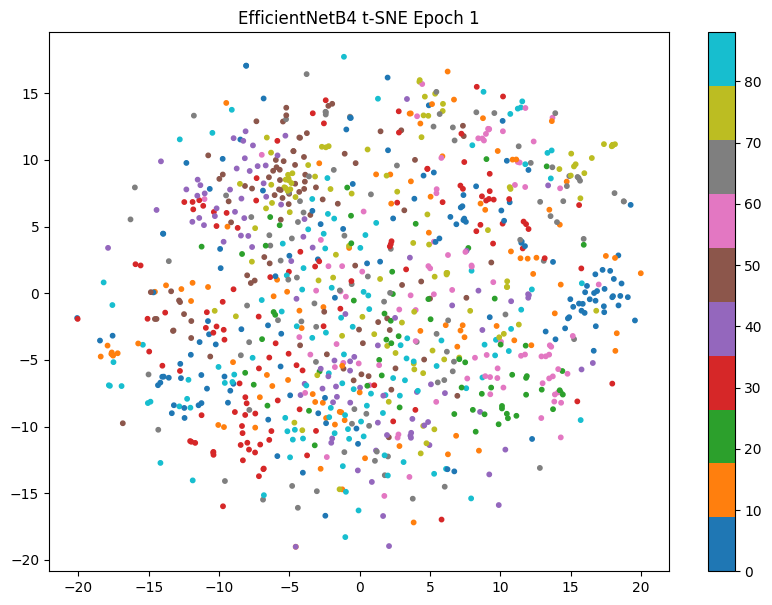

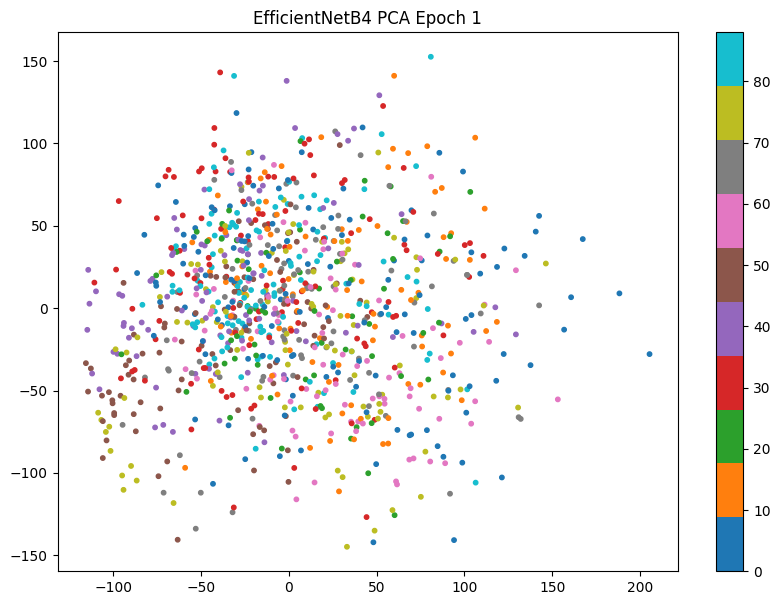

Saved EfficientNetB4 weights to EfficientNetB4_student_epoch_1.pth
Training ConvNeXtTiny...
Evaluating ConvNeXtTiny...


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 1.5675, Accuracy: 2336/3709 (63%)



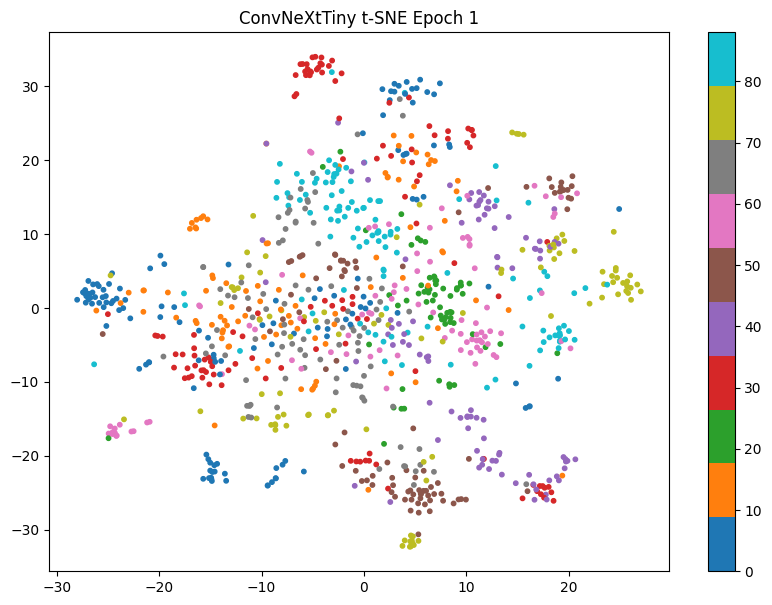

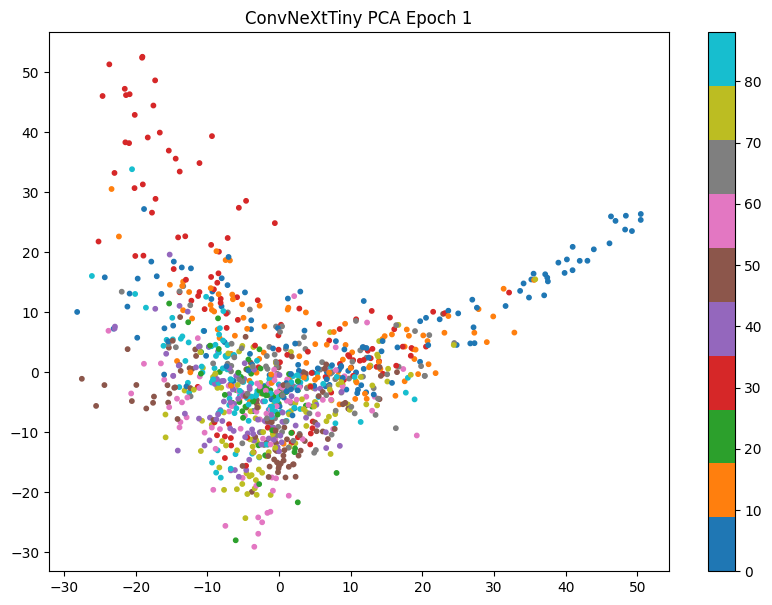

Saved ConvNeXtTiny weights to ConvNeXtTiny_student_epoch_1.pth
Starting Epoch 2/10
Training EfficientNetB4...
Evaluating EfficientNetB4...


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 2.2294, Accuracy: 1935/3709 (52%)



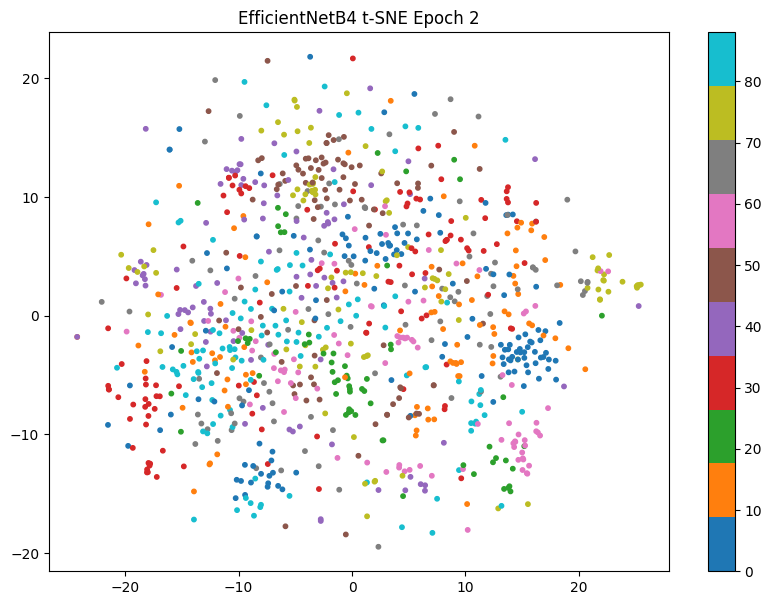

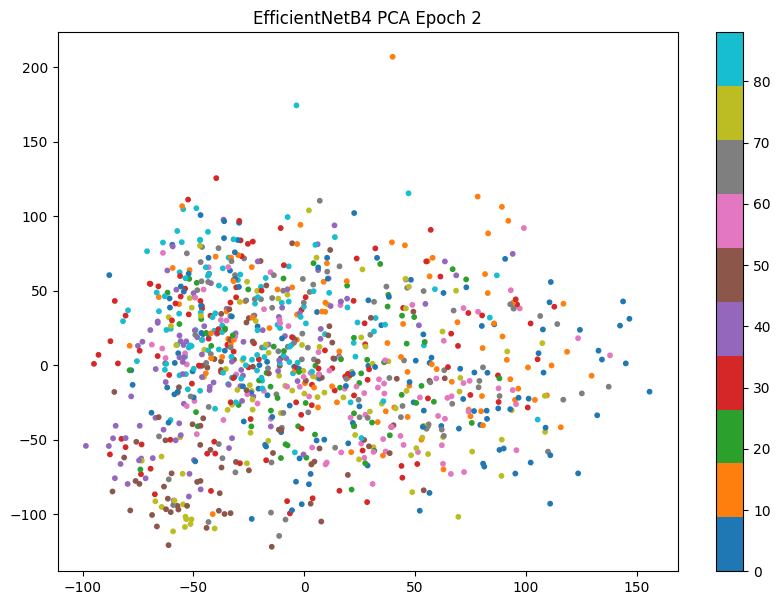

Saved EfficientNetB4 weights to EfficientNetB4_student_epoch_2.pth
Training ConvNeXtTiny...
Evaluating ConvNeXtTiny...


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 1.3757, Accuracy: 2527/3709 (68%)



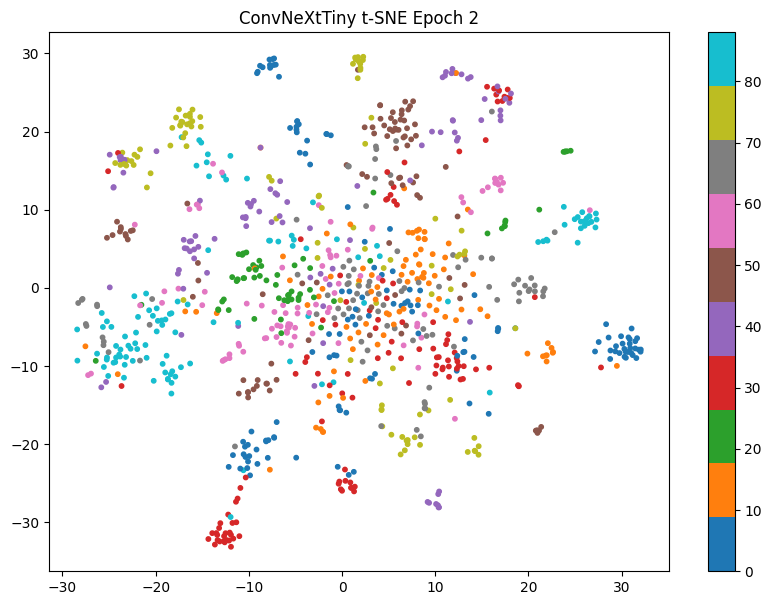

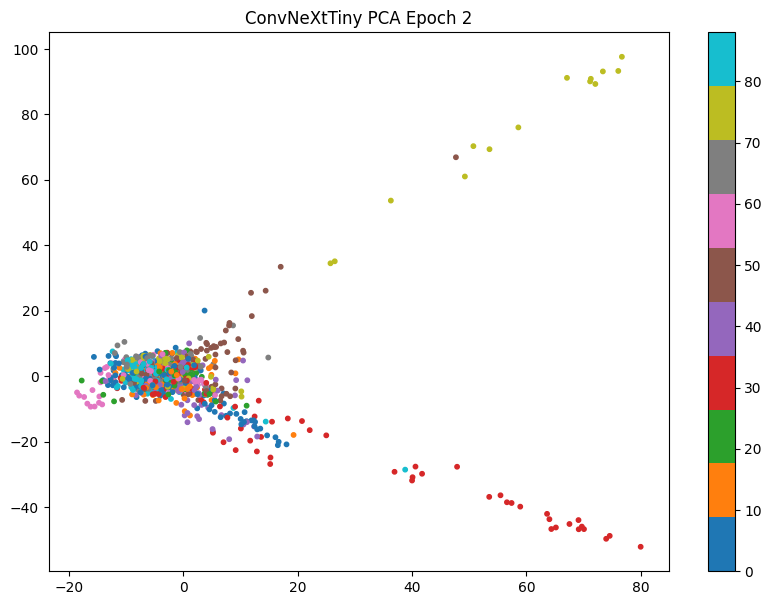

Saved ConvNeXtTiny weights to ConvNeXtTiny_student_epoch_2.pth
Starting Epoch 3/10
Training EfficientNetB4...
Evaluating EfficientNetB4...


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 1.9478, Accuracy: 2111/3709 (57%)



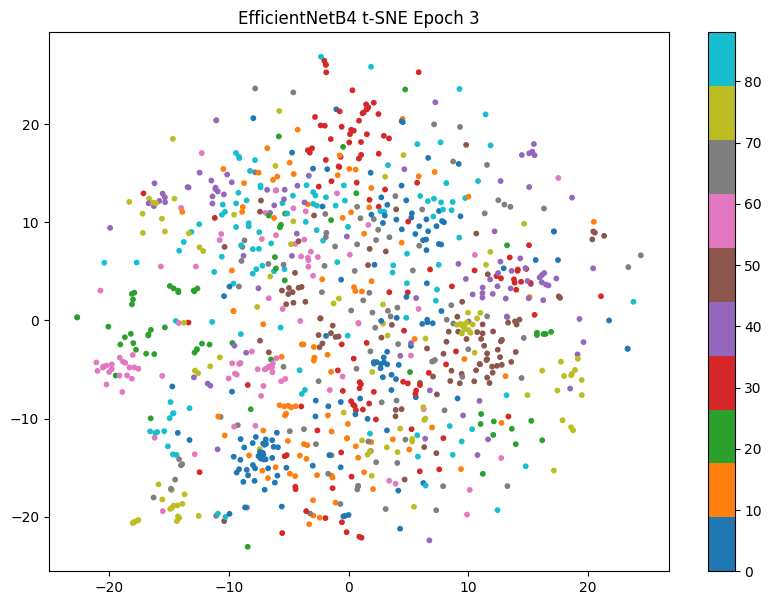

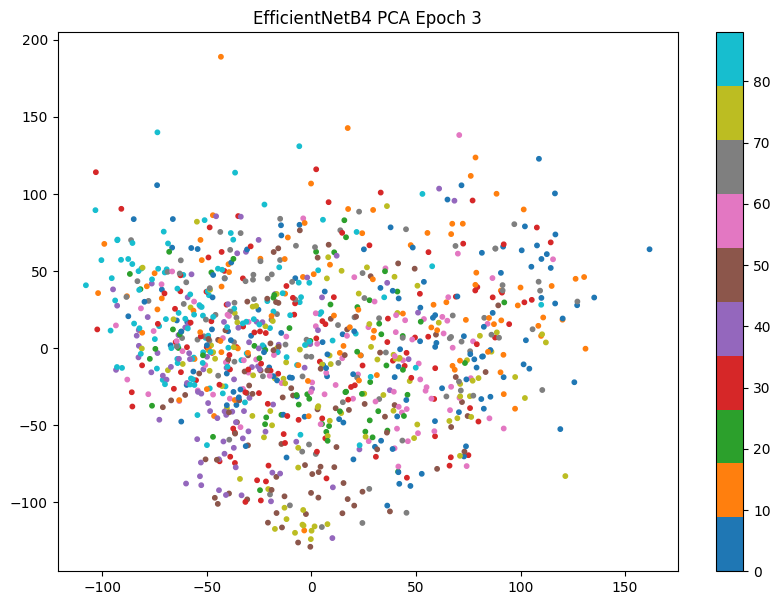

Saved EfficientNetB4 weights to EfficientNetB4_student_epoch_3.pth
Training ConvNeXtTiny...
Evaluating ConvNeXtTiny...


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 1.3403, Accuracy: 2549/3709 (69%)



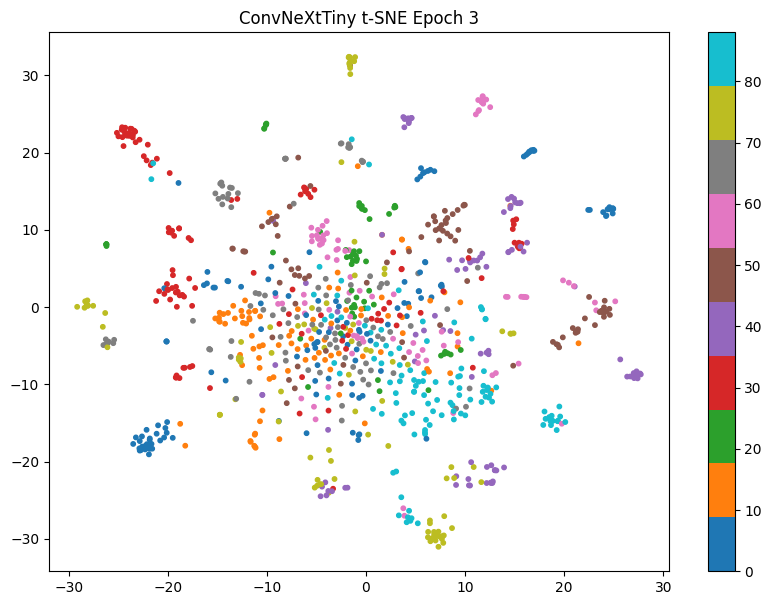

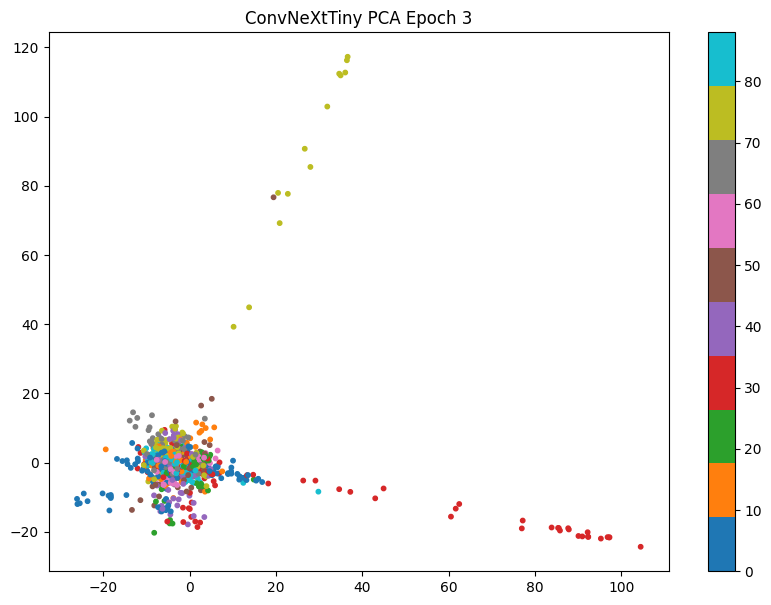

Saved ConvNeXtTiny weights to ConvNeXtTiny_student_epoch_3.pth
Starting Epoch 4/10
Training EfficientNetB4...
Evaluating EfficientNetB4...


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 1.8311, Accuracy: 2268/3709 (61%)



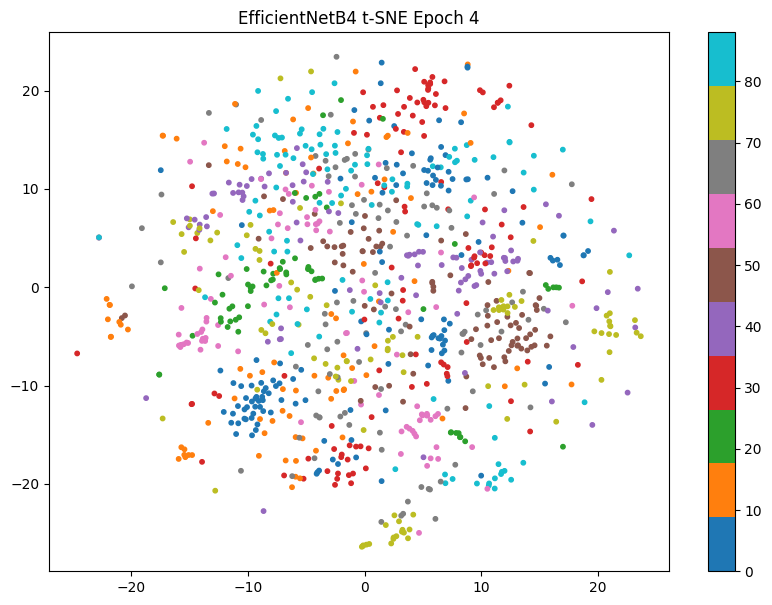

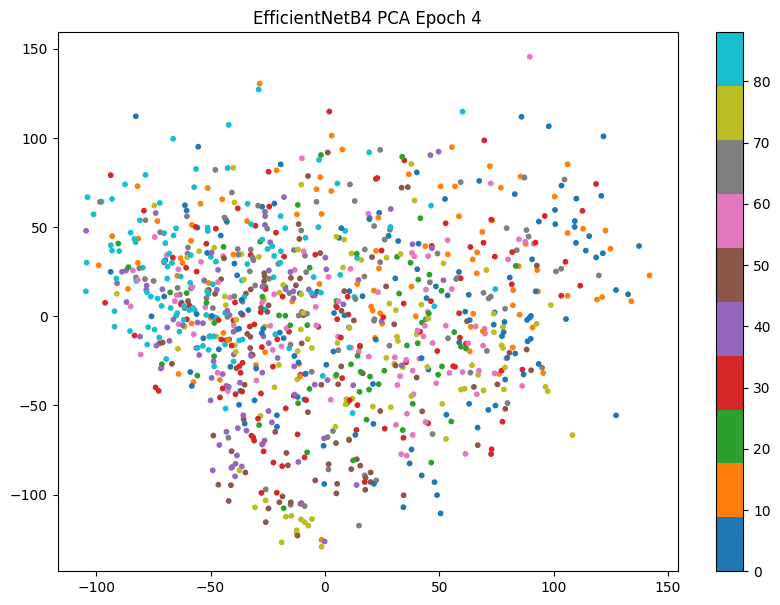

Saved EfficientNetB4 weights to EfficientNetB4_student_epoch_4.pth
Training ConvNeXtTiny...
Evaluating ConvNeXtTiny...


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 1.4179, Accuracy: 2529/3709 (68%)



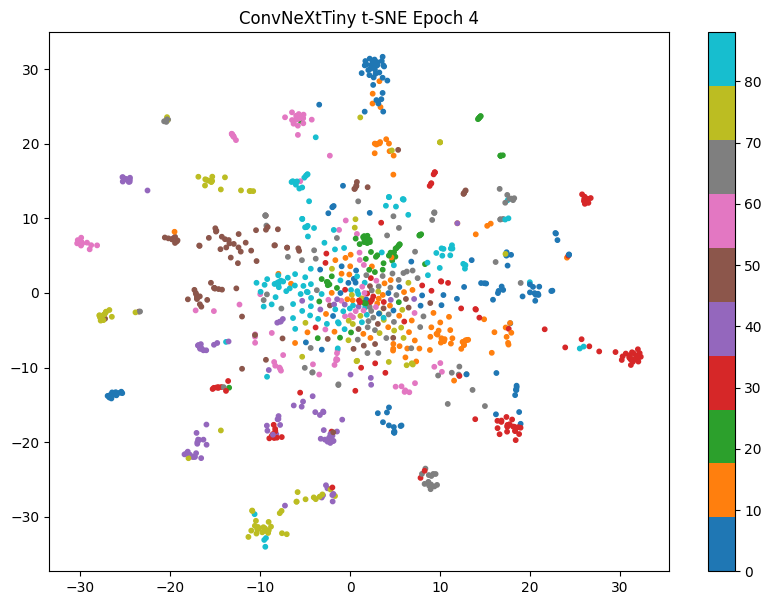

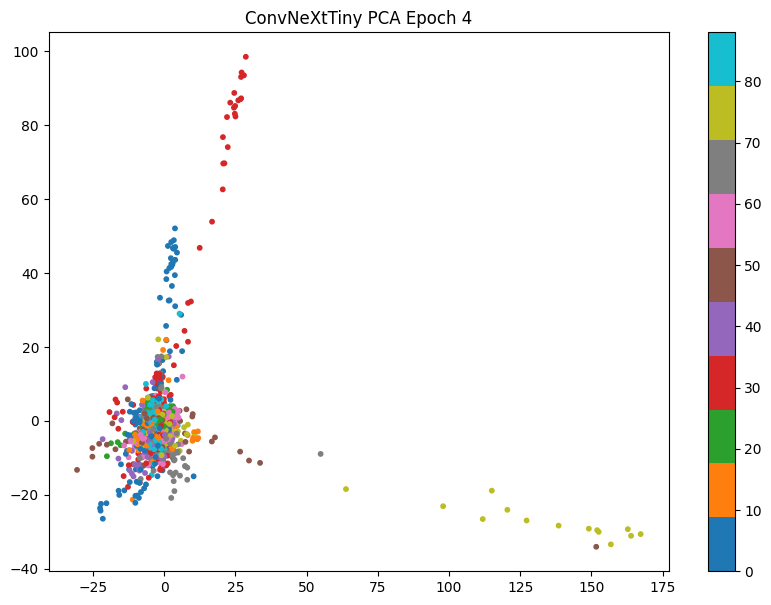

Saved ConvNeXtTiny weights to ConvNeXtTiny_student_epoch_4.pth
Starting Epoch 5/10
Training EfficientNetB4...
Evaluating EfficientNetB4...


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 1.6850, Accuracy: 2312/3709 (62%)



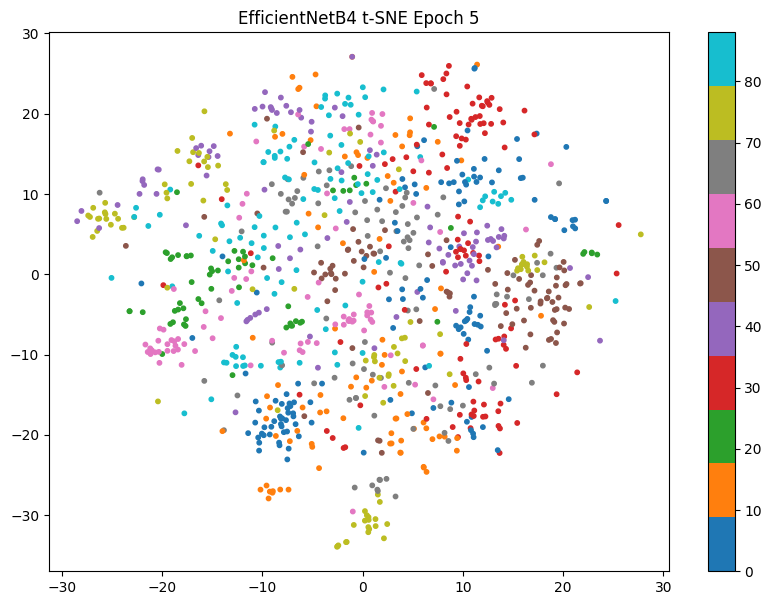

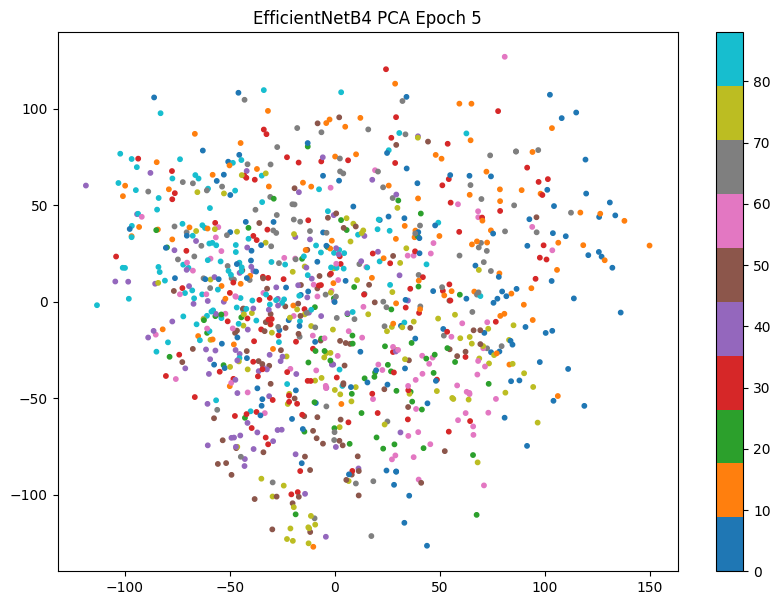

Saved EfficientNetB4 weights to EfficientNetB4_student_epoch_5.pth
Training ConvNeXtTiny...
Evaluating ConvNeXtTiny...


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 1.4683, Accuracy: 2511/3709 (68%)



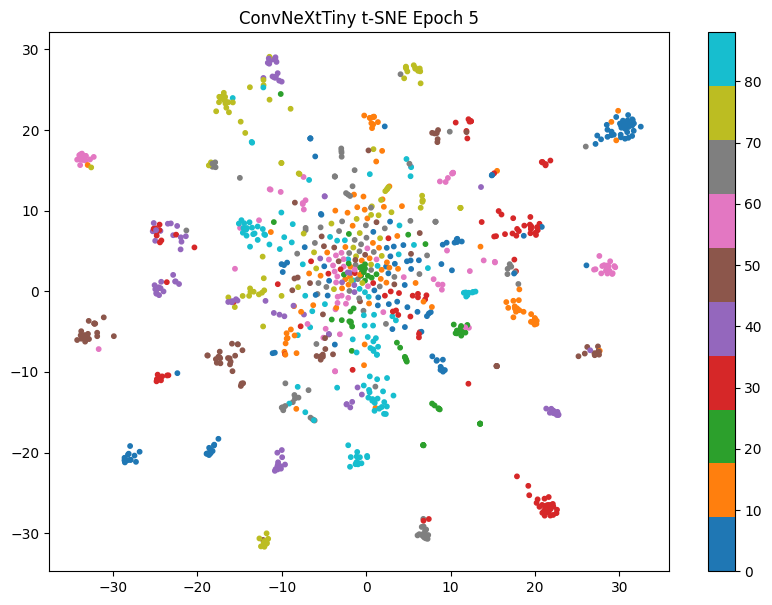

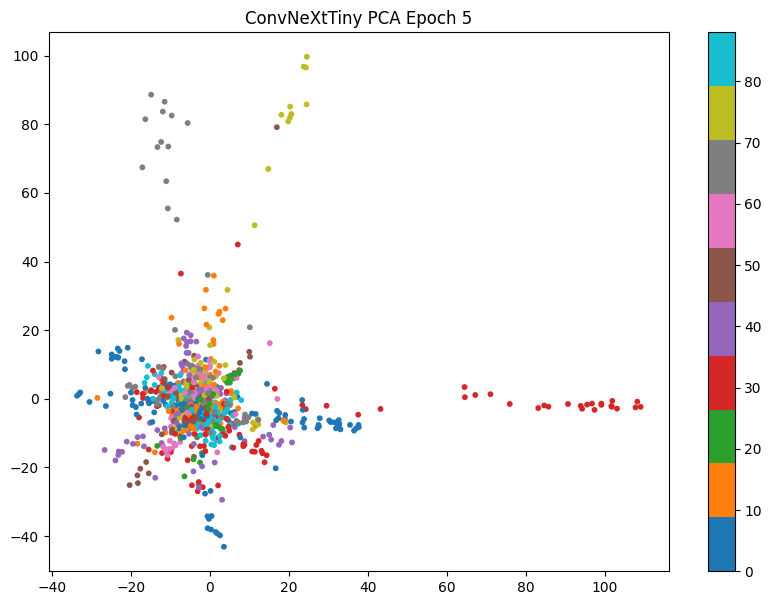

Saved ConvNeXtTiny weights to ConvNeXtTiny_student_epoch_5.pth
Starting Epoch 6/10
Training EfficientNetB4...
Evaluating EfficientNetB4...


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 1.6812, Accuracy: 2317/3709 (62%)



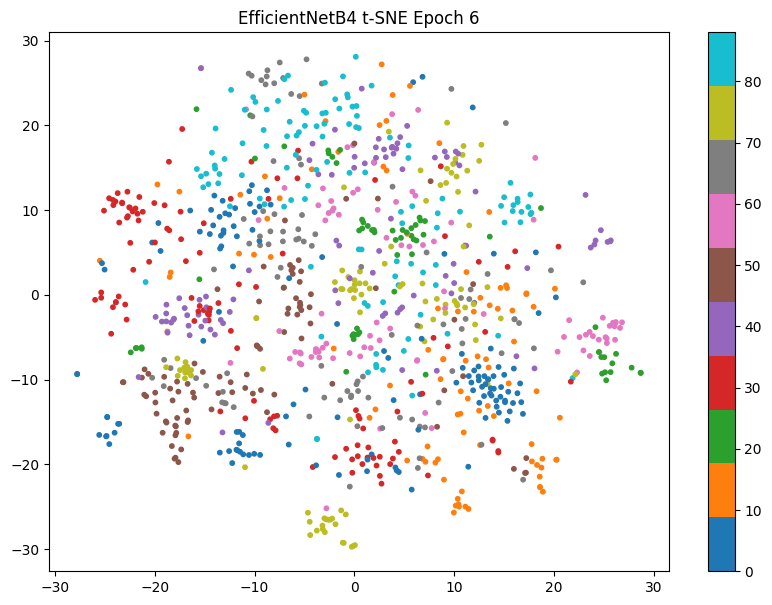

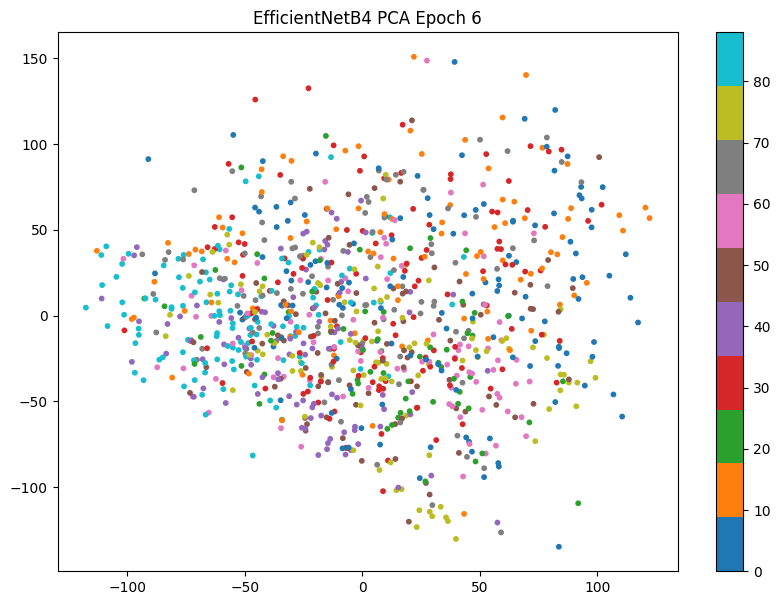

Saved EfficientNetB4 weights to EfficientNetB4_student_epoch_6.pth
Training ConvNeXtTiny...
Evaluating ConvNeXtTiny...


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 1.5373, Accuracy: 2474/3709 (67%)



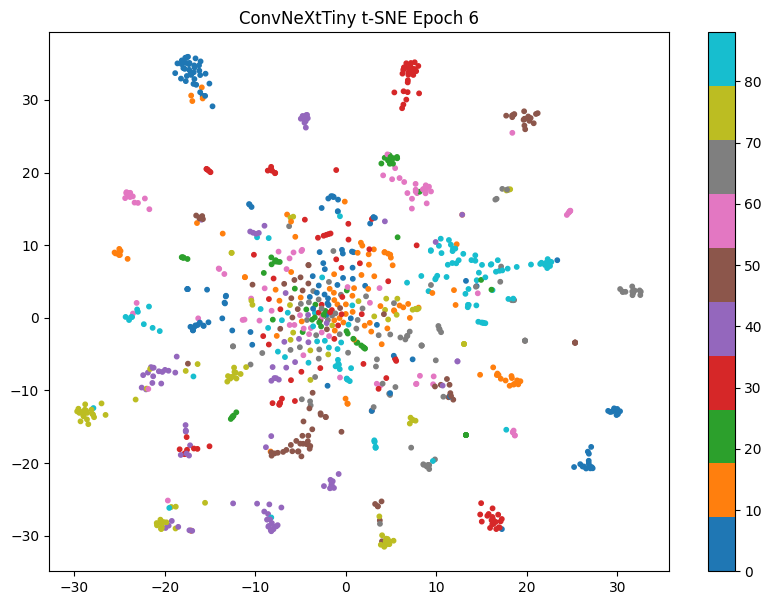

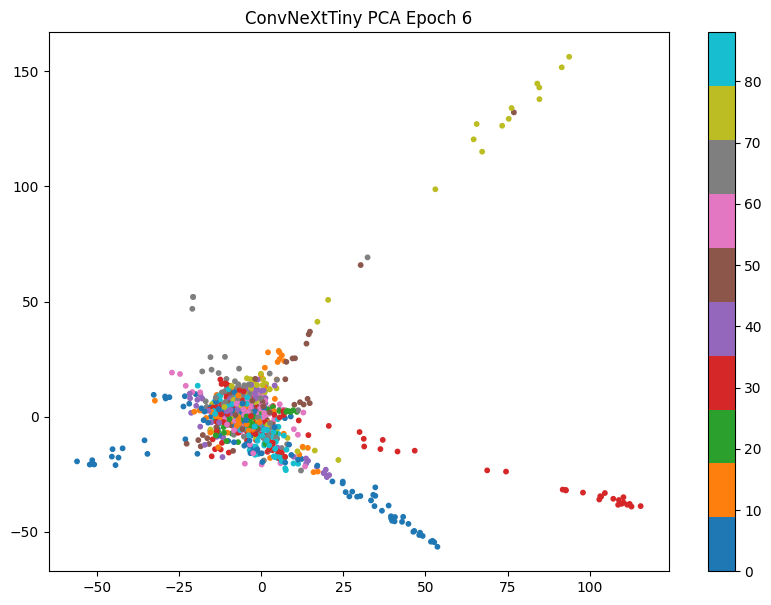

Saved ConvNeXtTiny weights to ConvNeXtTiny_student_epoch_6.pth
Starting Epoch 7/10
Training EfficientNetB4...
Evaluating EfficientNetB4...


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 1.6350, Accuracy: 2385/3709 (64%)



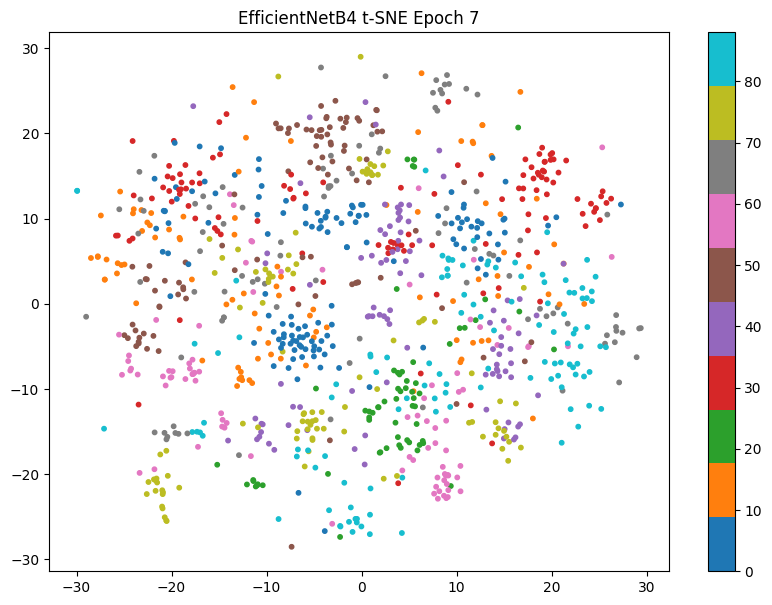

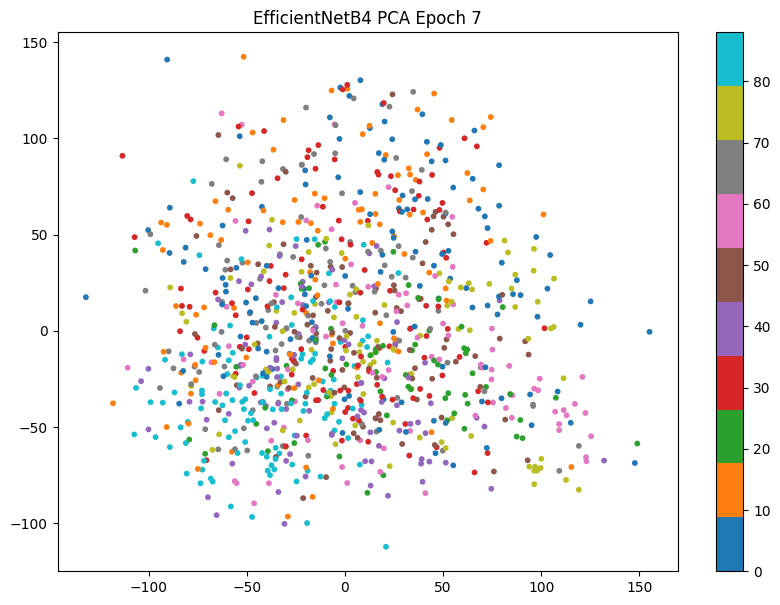

Saved EfficientNetB4 weights to EfficientNetB4_student_epoch_7.pth
Training ConvNeXtTiny...
Evaluating ConvNeXtTiny...


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 1.5332, Accuracy: 2491/3709 (67%)



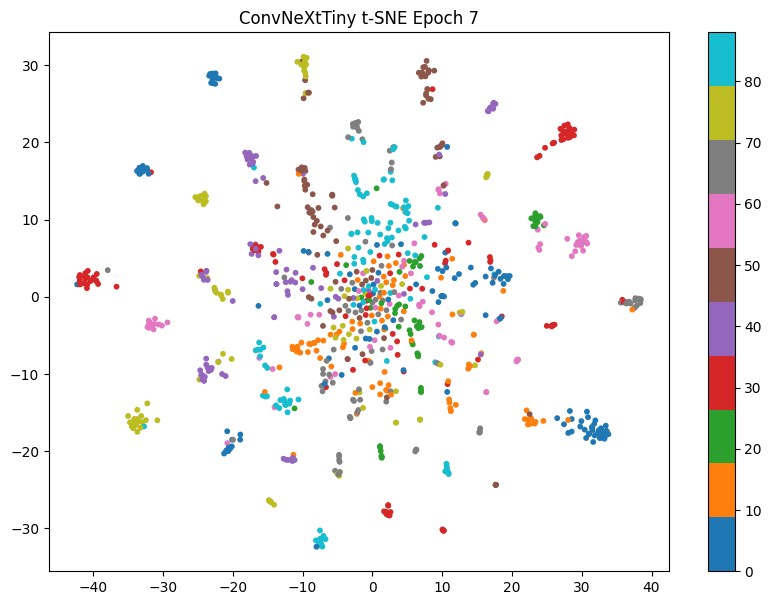

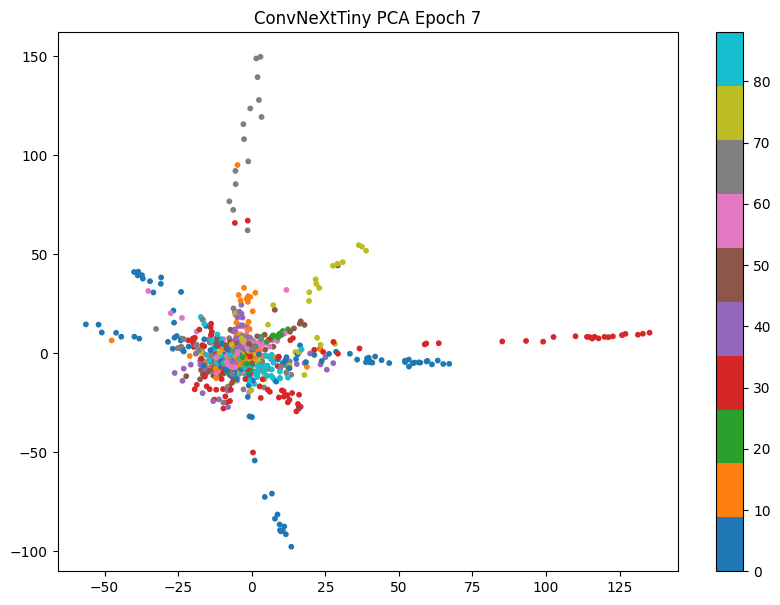

Saved ConvNeXtTiny weights to ConvNeXtTiny_student_epoch_7.pth
Starting Epoch 8/10
Training EfficientNetB4...
Evaluating EfficientNetB4...


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 1.6160, Accuracy: 2395/3709 (65%)



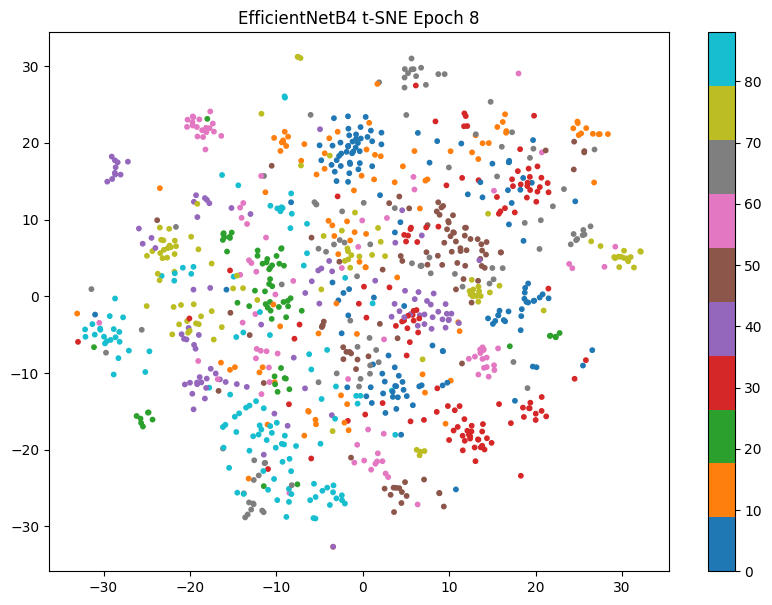

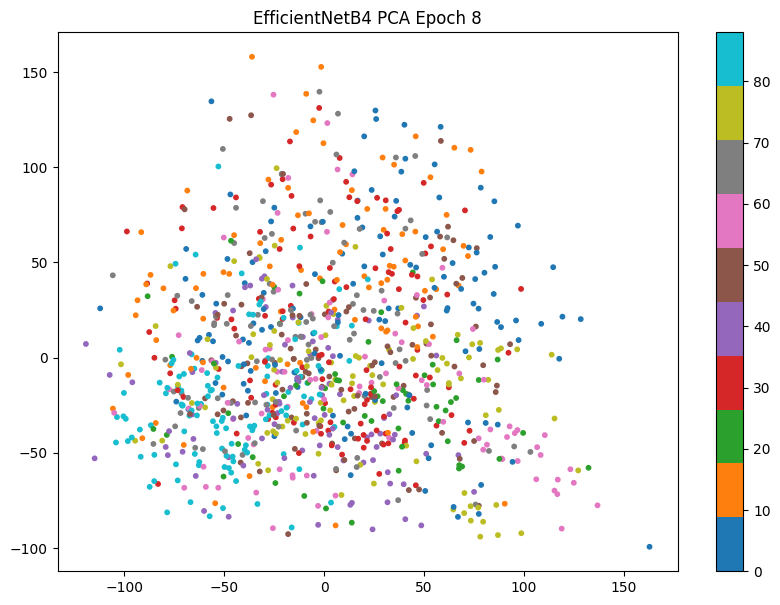

Saved EfficientNetB4 weights to EfficientNetB4_student_epoch_8.pth
Training ConvNeXtTiny...
Evaluating ConvNeXtTiny...


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 1.5762, Accuracy: 2476/3709 (67%)



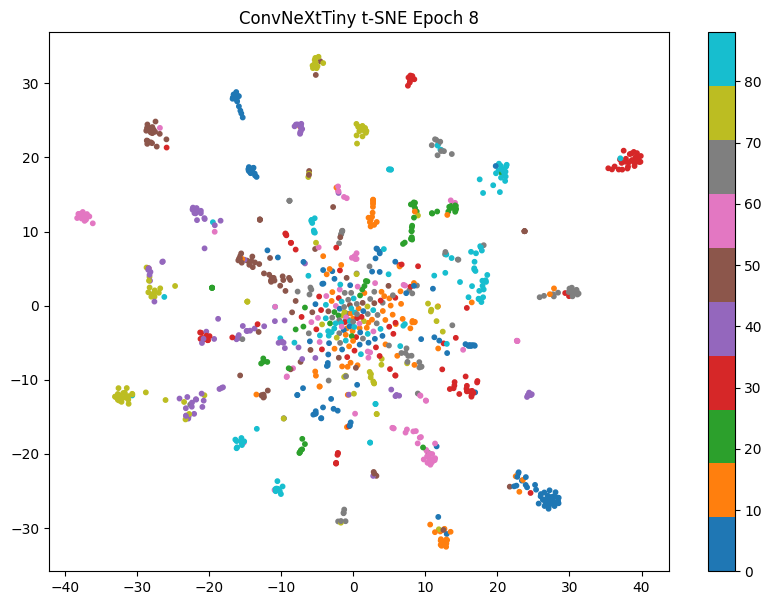

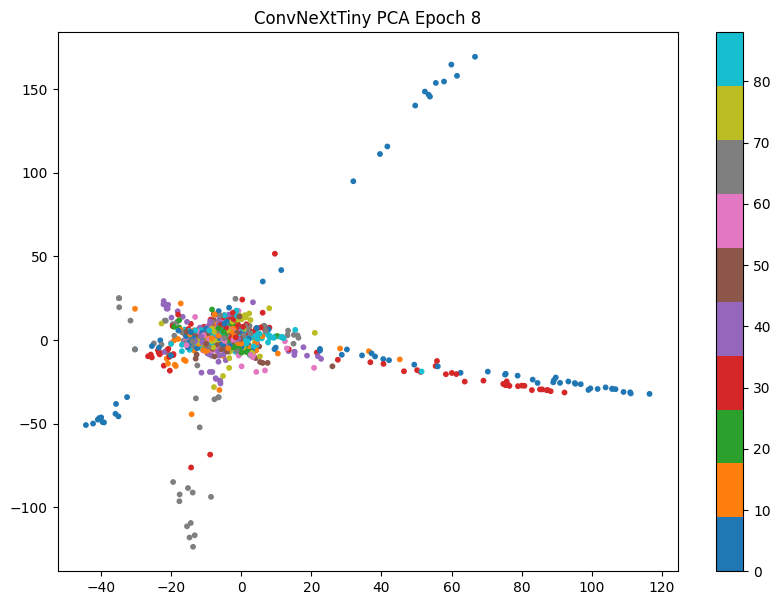

Saved ConvNeXtTiny weights to ConvNeXtTiny_student_epoch_8.pth
Starting Epoch 9/10
Training EfficientNetB4...
Evaluating EfficientNetB4...


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 1.6148, Accuracy: 2391/3709 (64%)



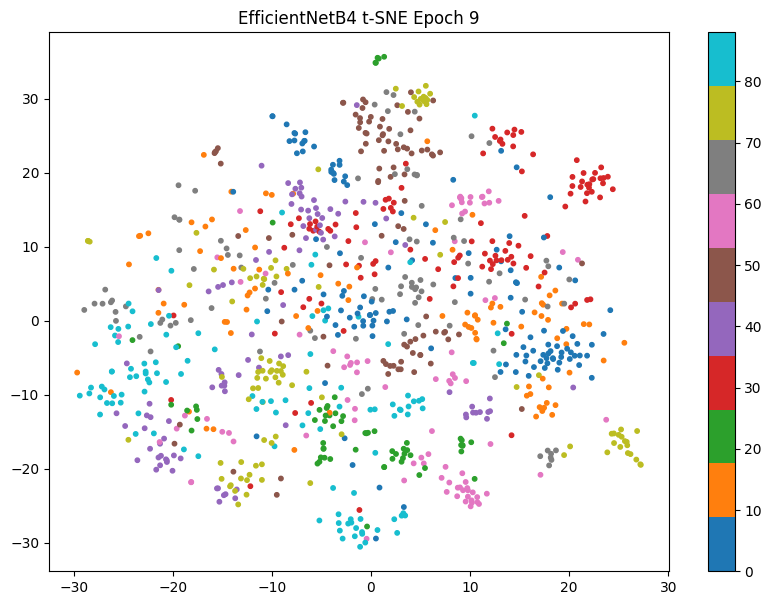

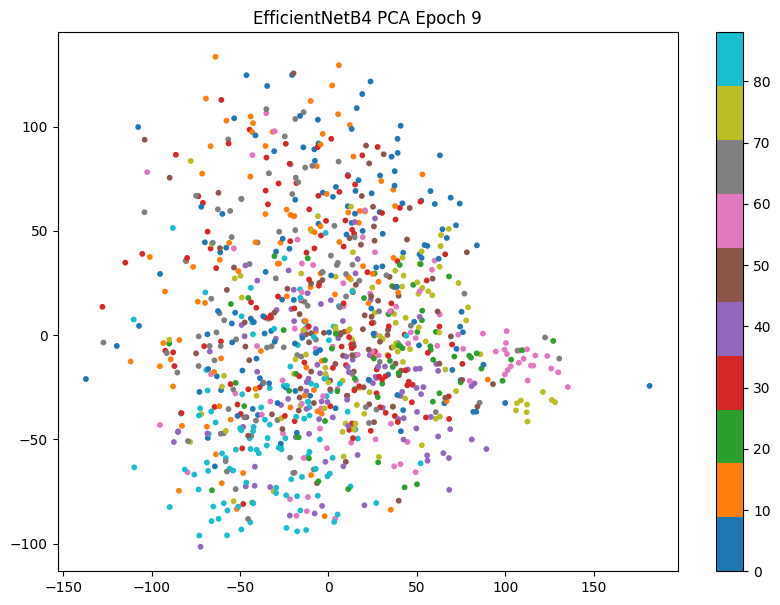

Saved EfficientNetB4 weights to EfficientNetB4_student_epoch_9.pth
Training ConvNeXtTiny...
Evaluating ConvNeXtTiny...


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 1.6338, Accuracy: 2412/3709 (65%)



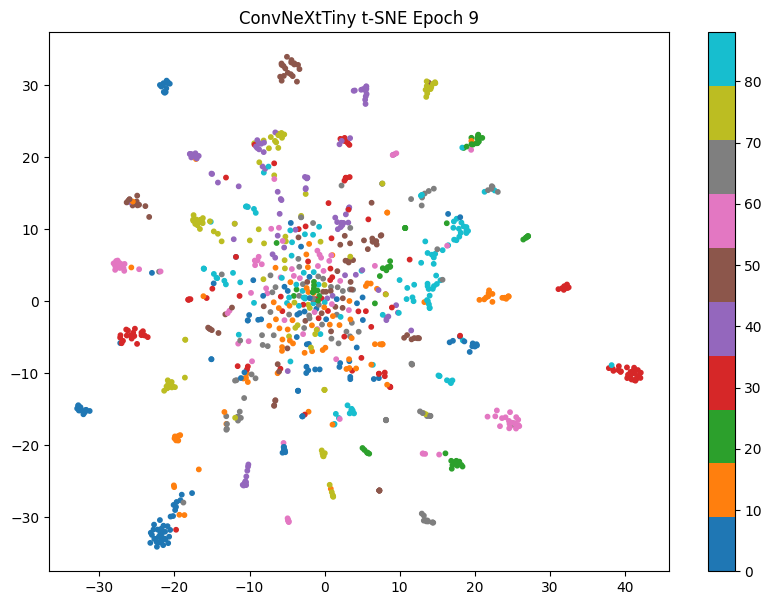

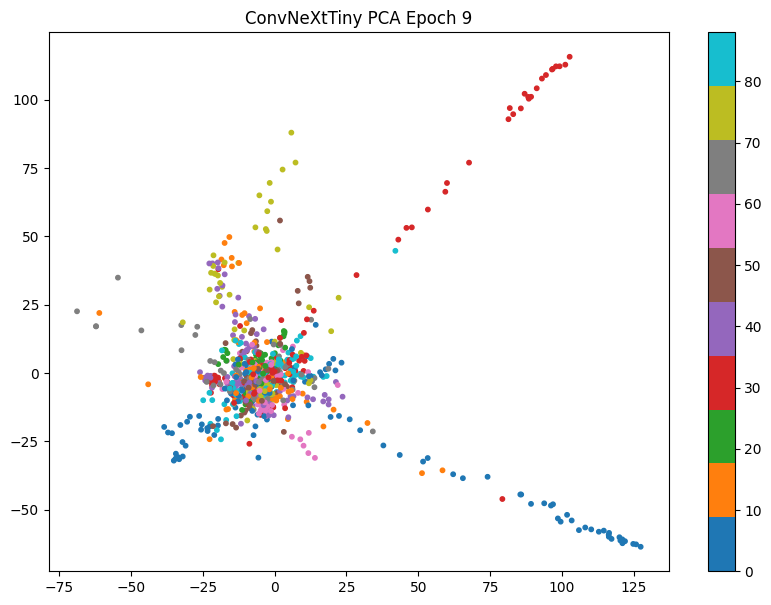

Saved ConvNeXtTiny weights to ConvNeXtTiny_student_epoch_9.pth
Starting Epoch 10/10
Training EfficientNetB4...
Evaluating EfficientNetB4...


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 1.6067, Accuracy: 2422/3709 (65%)



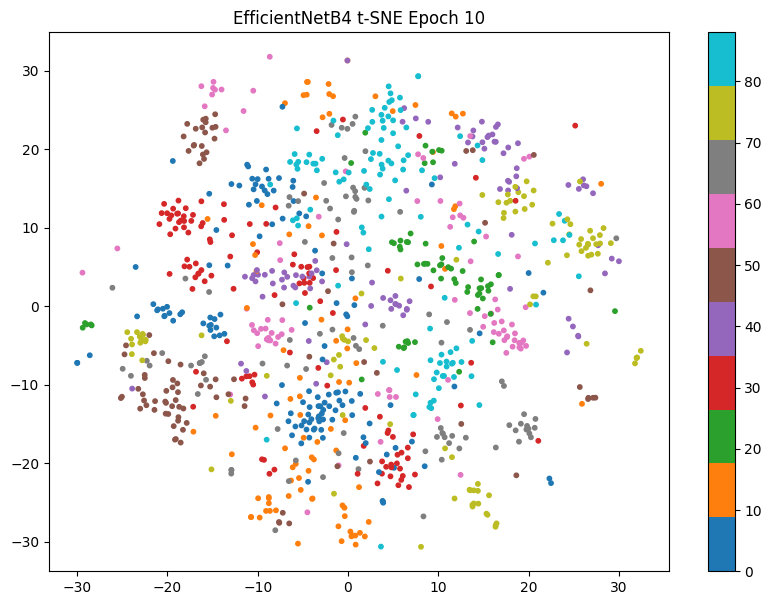

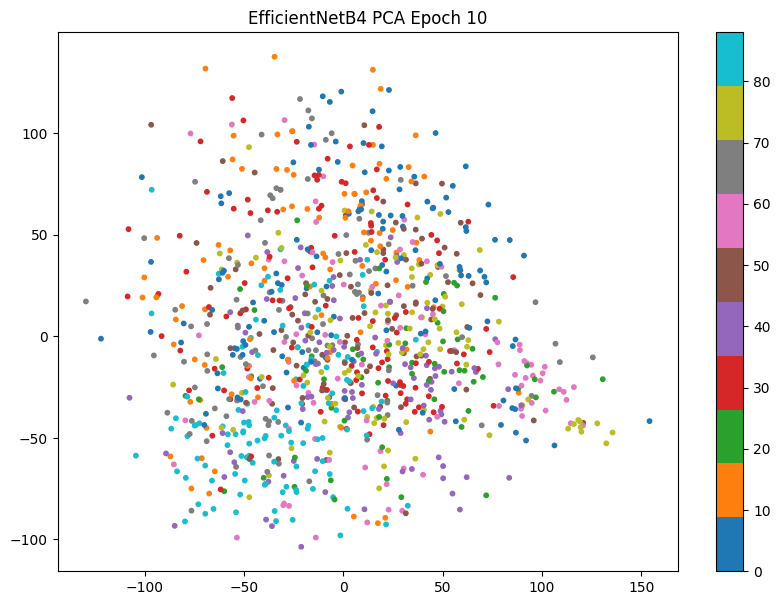

Saved EfficientNetB4 weights to EfficientNetB4_student_epoch_10.pth
Training ConvNeXtTiny...
Evaluating ConvNeXtTiny...


d:\Users\songyanghui\anaconda3\envs\mvpdr\lib\site-packages\PIL\TiffImagePlugin.py:870: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))



Test set: Average loss: 1.6475, Accuracy: 2430/3709 (66%)



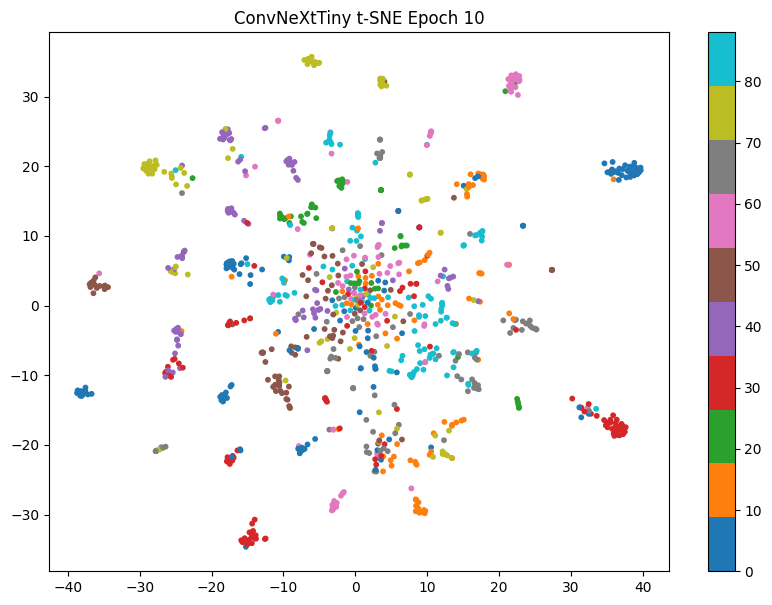

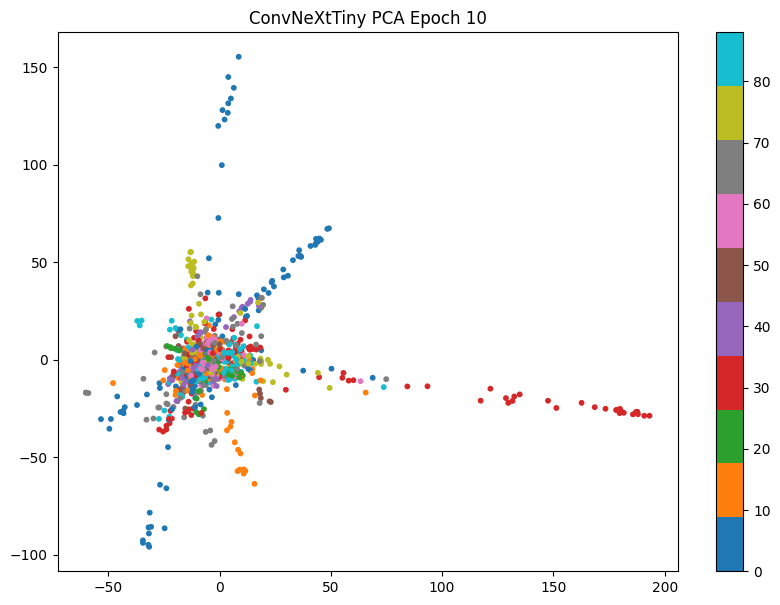

Saved ConvNeXtTiny weights to ConvNeXtTiny_student_epoch_10.pth


In [6]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F  # 导入 F 模块
from torchvision import datasets, transforms, models
from torch.utils.data import DataLoader, Dataset
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import os
from PIL import Image

# 自定义数据集类
class PlantDocDataset(Dataset):
    def __init__(self, root_dir, txt_path, transform=None, train=True, train_ratio=0.8, random_seed=42):
        self.root_dir = root_dir
        self.transform = transform
        self.samples = []

        # 解析txt文件
        with open(txt_path, 'r') as f:
            lines = f.readlines()

        for line in lines:
            line = line.strip()
            if not line:
                continue
            parts = line.split('=')
            if len(parts) < 3:
                continue
            img_rel_path, label_str, _ = parts[0], parts[1], parts[2]
            img_full_path = os.path.join(root_dir, 'images', img_rel_path.replace('/', os.path.sep))
            if not os.path.exists(img_full_path):
                continue
            label = int(label_str)
            self.samples.append((img_full_path, label))

        # 随机分割数据集
        num_samples = len(self.samples)
        indices = list(range(num_samples))
        np.random.seed(random_seed)
        np.random.shuffle(indices)
        split_idx = int(train_ratio * num_samples)
        self.indices = indices[:split_idx] if train else indices[split_idx:]

    def __len__(self):
        return len(self.indices)

    def __getitem__(self, idx):
        actual_idx = self.indices[idx]
        img_path, label = self.samples[actual_idx]
        image = Image.open(img_path).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image, label

# 数据预处理
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# 创建数据集和数据加载器
train_dataset = PlantDocDataset(
    root_dir=r'E:\data1\plantdoc',
    txt_path=r'E:\data1\plantdoc\trainval.txt',
    transform=transform,
    train=True
)

test_dataset = PlantDocDataset(
    root_dir=r'E:\data1\plantdoc',
    txt_path=r'E:\data1\plantdoc\trainval.txt',
    transform=transform,
    train=False
)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False)

# 修改模型输出为89类
def load_efficientnet_b4(pretrained=True):
    model = models.efficientnet_b4(pretrained=pretrained)
    num_ftrs = model.classifier[1].in_features
    model.classifier[1] = nn.Linear(num_ftrs, 89)
    return model

def load_convnext_tiny(pretrained=True):
    model = models.convnext_tiny(pretrained=pretrained)
    num_ftrs = model.classifier[-1].in_features
    model.classifier[-1] = nn.Linear(num_ftrs, 89)
    return model

# 定义知识蒸馏损失函数
def distillation_loss(output_student, target, output_teacher, T=3.0, alpha=0.5):
    """
    计算知识蒸馏损失
    :param output_student: 学生模型的输出
    :param target: 真实标签
    :param output_teacher: 教师模型的输出
    :param T: 温度参数，用于软化教师模型的输出
    :param alpha: 权重参数，用于平衡交叉熵损失和KL散度损失
    :return: 总损失
    """
    # 计算交叉熵损失
    ce_loss = F.cross_entropy(output_student, target)
    
    # 计算KL散度损失
    kd_loss = F.kl_div(F.log_softmax(output_student / T, dim=1),
                       F.softmax(output_teacher / T, dim=1),
                       reduction='batchmean') * T * T
    
    # 总损失
    loss = alpha * ce_loss + (1 - alpha) * kd_loss
    return loss

# 训练函数
def train(model, teacher_model, device, train_loader, optimizer, epoch):
    model.train()
    teacher_model.eval()
    for batch_idx, (data, target) in enumerate(train_loader):
        data, target = data.to(device), target.to(device)
        optimizer.zero_grad()
        output_student = model(data)
        with torch.no_grad():
            output_teacher = teacher_model(data)
        loss = distillation_loss(output_student, target, output_teacher)
        loss.backward()
        optimizer.step()

# 测试函数
def test(model, device, test_loader):
    model.eval()
    test_loss = 0
    correct = 0
    all_preds = []
    all_labels = []
    with torch.no_grad():
        for data, target in test_loader:
            data, target = data.to(device), target.to(device)
            output = model(data)
            test_loss += nn.CrossEntropyLoss(reduction='sum')(output, target).item()
            pred = output.argmax(dim=1, keepdim=True)
            correct += pred.eq(target.view_as(pred)).sum().item()
            all_preds.extend(pred.cpu().numpy())
            all_labels.extend(target.cpu().numpy())

    test_loss /= len(test_loader.dataset)
    print(f'\nTest set: Average loss: {test_loss:.4f}, Accuracy: {correct}/{len(test_loader.dataset)} ({100. * correct / len(test_loader.dataset):.0f}%)\n')
    return all_preds, all_labels

# 可视化函数
def visualize_tsne(features, labels, title):
    tsne = TSNE(n_components=2, random_state=0)
    features_tsne = tsne.fit_transform(features)
    plt.figure(figsize=(10, 7))
    plt.scatter(features_tsne[:, 0], features_tsne[:, 1], c=labels, cmap='tab10', s=10)
    plt.title(title)
    plt.colorbar()
    plt.show()

def visualize_pca(features, labels, title):
    pca = PCA(n_components=2)
    features_pca = pca.fit_transform(features)
    plt.figure(figsize=(10, 7))
    plt.scatter(features_pca[:, 0], features_pca[:, 1], c=labels, cmap='tab10', s=10)
    plt.title(title)
    plt.colorbar()
    plt.show()

# 特征提取函数（修正后的）
def extract_features(model, dataloader, device, num_samples=1000):
    model.eval()
    features = []
    labels = []
    with torch.no_grad():
        for i, (data, target) in enumerate(dataloader):
            if i * len(data) >= num_samples:
                break
            data, target = data.to(device), target.to(device)
            
            # 获取中间特征
            if isinstance(model, models.EfficientNet):
                feature_map = model.features(data)
            elif isinstance(model, models.ConvNeXt):
                feature_map = model.features(data)
            elif isinstance(model, models.SwinTransformer):
                feature_map = model.forward(data)[0]  # SwinTransformer 返回的是一个元组，第一个元素才是特征图
                print(f"SwinTransformer feature_map shape: {feature_map.shape}")  # 调试信息
                if feature_map.dim() == 4:  # 检查是否为四维张量
                    feature_map = feature_map.permute(0, 2, 3, 1).contiguous().view(feature_map.size(0), -1, feature_map.size(-1))
                    feature_map = feature_map.mean(dim=1)  # 全局平均池化
                else:
                    raise ValueError(f"Unexpected feature map dimension: {feature_map.dim()}")
            else:
                raise ValueError("Unsupported model type")
                
            # 将特征展平成一维向量
            feature_vector = torch.flatten(feature_map, start_dim=1)
            features.append(feature_vector.cpu().numpy())
            labels.extend(target.cpu().numpy())  # 修正处：添加.cpu()
    
    features = np.concatenate(features)[:num_samples]
    labels = np.array(labels)[:num_samples]
    return features, labels

# 主程序
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# 初始化模型
models_dict = {
    'EfficientNetB4': load_efficientnet_b4().to(device),
    'ConvNeXtTiny': load_convnext_tiny().to(device),
    
}

# 训练参数
optimizers = {name: optim.Adam(model.parameters(), lr=1e-4) for name, model in models_dict.items()}
teacher_model = load_efficientnet_b4().to(device)

# 加载教师模型权重（如果存在）
teacher_weights_path = "teacher_weights.pth"
if os.path.exists(teacher_weights_path):
    teacher_model.load_state_dict(torch.load(teacher_weights_path))
else:
    print(f"No pre-trained weights found at {teacher_weights_path}. Training the teacher model from scratch.")

# 训练循环
num_epochs = 10  # 设置训练轮数为10
for epoch in range(1, num_epochs + 1):
    print(f'Starting Epoch {epoch}/{num_epochs}')
    for name, model in models_dict.items():
        print(f'Training {name}...')
        train(model, teacher_model, device, train_loader, optimizers[name], epoch)
        print(f'Evaluating {name}...')
        test_preds, test_labels = test(model, device, test_loader)
        
        # 提取特征并进行可视化
        features, labels = extract_features(model, test_loader, device)
        visualize_tsne(features, labels, f'{name} t-SNE Epoch {epoch}')
        visualize_pca(features, labels, f'{name} PCA Epoch {epoch}')
        
        # 保存学生模型权重
        student_weights_path = f"{name}_student_epoch_{epoch}.pth"
        torch.save(model.state_dict(), student_weights_path)
        print(f'Saved {name} weights to {student_weights_path}')

优化版ConvNetTiny

In [3]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms, models, ops
from torch.utils.data import DataLoader, Dataset
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import os
from PIL import Image
from tqdm import tqdm

# 改进的ConvNeXt Tiny组件 --------------------------------------------------------
class HybridAttention(nn.Module):
    """混合通道与空间注意力机制"""
    def __init__(self, dim, reduction=4):
        super().__init__()
        self.channel_att = nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Conv2d(dim, dim // reduction, 1),
            nn.GELU(),
            nn.Conv2d(dim // reduction, dim, 1),
            nn.Sigmoid()
        )
        self.spatial_att = nn.Sequential(
            nn.Conv2d(dim, dim//reduction, 1),
            nn.Conv2d(dim//reduction, 1, 3, padding=1, groups=dim//reduction),
            nn.Sigmoid()
        )
        
    def forward(self, x):
        return x * self.channel_att(x) * self.spatial_att(x)

class EnhancedDownsample(nn.Module):
    """改进的下采样模块"""
    def __init__(self, in_ch, out_ch):
        super().__init__()
        print(f"EnhancedDownsample: in_ch={in_ch}, out_ch={out_ch}, groups=1")
        self.main = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, 2, 1, bias=False),
            nn.GroupNorm(1, out_ch),  # groups=1
            HybridAttention(out_ch),
            nn.Conv2d(out_ch, out_ch, 1, bias=False)
        )
        self.res = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 1, 2, bias=False),
            nn.GroupNorm(1, out_ch)  # groups=1
        )
    
    def forward(self, x):
        return self.main(x) + self.res(x)

class DeformConvBlock(nn.Module):
    """可变形卷积块"""
    def __init__(self, dim):
        super().__init__()
        self.offset = nn.Conv2d(dim, 2*3*3, 3, padding=1)
        self.conv = nn.Conv2d(dim, dim, 3, padding=1)
        self.norm = nn.GroupNorm(1, dim)
        self.att = HybridAttention(dim)
        
    def forward(self, x):
        offset = self.offset(x)
        x = ops.deform_conv2d(x, offset, self.conv.weight, padding=1)
        return self.att(self.norm(x))

class EnhancedConvNeXtBlock(nn.Module):
    """改进的ConvNeXt基础块"""
    def __init__(self, dim, layer_scale=1e-6):
        super().__init__()
        self.dwconv = DeformConvBlock(dim)
        self.pwconv1 = nn.Linear(dim, 4*dim)
        self.act = nn.GELU()
        self.pwconv2 = nn.Linear(4*dim, dim)
        self.gamma = nn.Parameter(layer_scale * torch.ones(dim)) if layer_scale > 0 else None
        
    def forward(self, x):
        shortcut = x
        x = self.dwconv(x)
        x = x.permute(0, 2, 3, 1)  # [N, C, H, W] -> [N, H, W, C]
        x = self.pwconv1(x)
        x = self.act(x)
        x = self.pwconv2(x)
        if self.gamma is not None:
            x = self.gamma * x
        x = x.permute(0, 3, 1, 2)  # [N, H, W, C] -> [N, C, H, W]
        return shortcut + x

class EnhancedConvNeXtTiny(nn.Module):
    """改进的ConvNeXt Tiny完整模型"""
    def __init__(self, num_classes=89):
        super().__init__()
        self.features = nn.Sequential(
            EnhancedDownsample(3, 96),  # stage 0
            *[self._make_stage(96, 3)],  # stage 1
            EnhancedDownsample(96, 192),
            *[self._make_stage(192, 3)],  # stage 2
            EnhancedDownsample(192, 384),
            *[self._make_stage(384, 9)],  # stage 3
            nn.AdaptiveAvgPool2d(1)
        )
        self.classifier = nn.Sequential(
            nn.Flatten(),
            nn.LayerNorm(384),
            HybridAttention(384),
            nn.Dropout(0.5),
            nn.Linear(384, num_classes)
        )
    
    def _make_stage(self, dim, depth):
        return nn.Sequential(*[EnhancedConvNeXtBlock(dim) for _ in range(depth)])
    
    def forward(self, x):
        return self.classifier(self.features(x))

# 数据集和训练框架 ---------------------------------------------------------------
class PlantDocDataset(Dataset):
    """自定义植物病害数据集"""
    def __init__(self, root_dir, txt_path, transform=None, train=True, train_ratio=0.8, random_seed=42):
        self.samples = []
        with open(txt_path, 'r') as f:
            for line in f.readlines():
                parts = line.strip().split('=')
                if len(parts) < 3: continue
                img_path = os.path.join(root_dir, 'images', parts[0].replace('/', os.sep))
                if os.path.exists(img_path):
                    self.samples.append((img_path, int(parts[1])))
        
        indices = np.random.RandomState(random_seed).permutation(len(self.samples))
        split = int(len(indices) * train_ratio)
        self.indices = indices[:split] if train else indices[split:]
        self.transform = transform

    def __len__(self):
        return len(self.indices)

    def __getitem__(self, idx):
        img_path, label = self.samples[self.indices[idx]]
        img = Image.open(img_path).convert('RGB')
        return self.transform(img) if self.transform else img, label

class DS_FusionNet(nn.Module):
    """双教师知识蒸馏融合网络"""
    def __init__(self):
        super().__init__()
        self.efficientnet = models.efficientnet_b4(pretrained=True)
        self.efficientnet.classifier[1] = nn.Linear(self.efficientnet.classifier[1].in_features, 89)
        
        self.convnext = EnhancedConvNeXtTiny(89)
        
        # 动态获取输出通道
        eff_out = self._get_eff_output_channels()
        convnext_out = 384  # EnhancedConvNeXt最终特征维度
        
        self.fusion = nn.Sequential(
            nn.Conv2d(eff_out + convnext_out, 256, 1),
            nn.BatchNorm2d(256),
            nn.GELU(),
            nn.AdaptiveAvgPool2d(7),
            nn.Flatten(),
            nn.Linear(256*7*7, 512),
            nn.LayerNorm(512),
            nn.Dropout(0.5),
            nn.Linear(512, 89)
        )

    def _get_eff_output_channels(self):
        with torch.no_grad():
            dummy = torch.randn(1,3,224,224)
            return self.efficientnet.features(dummy).shape[1]

    def forward(self, x):
        eff_feat = self.efficientnet.features(x)
        convnext_feat = self.convnext.features(x)
        
        # 尺寸对齐
        if eff_feat.shape[-2:] != convnext_feat.shape[-2:]:
            convnext_feat = nn.functional.interpolate(
                convnext_feat, 
                size=eff_feat.shape[-2:], 
                mode='bilinear', 
                align_corners=False
            )
        
        fused = torch.cat([eff_feat, convnext_feat], dim=1)
        return self.fusion(fused)

# 训练工具函数 ----------------------------------------------------------------
def create_dataloaders():
    transform = transforms.Compose([
        transforms.RandomResizedCrop(224, scale=(0.6, 1.0)),
        transforms.RandomHorizontalFlip(),
        transforms.ColorJitter(0.3, 0.3, 0.3),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
        transforms.RandomErasing(p=0.5)
    ])
    
    train_set = PlantDocDataset(
        root_dir=r'E:\data1\plantdoc',
        txt_path=r'E:\data1\plantdoc\trainval.txt',
        transform=transform,
        train=True,
        train_ratio=0.1
    )
    
    test_set = PlantDocDataset(
        root_dir=r'E:\data1\plantdoc',
        txt_path=r'E:\data1\plantdoc\trainval.txt',
        transform=transform,
        train=False
    )
    
    return DataLoader(train_set, 16, shuffle=True, num_workers=4), \
           DataLoader(test_set, 16, shuffle=False, num_workers=4)

def train_epoch(model, loader, optimizer, device, teacher=None, T=3, alpha=0.7):
    model.train()
    total_loss = 0
    scaler = torch.cuda.amp.GradScaler()
    
    for inputs, targets in tqdm(loader, desc='Training'):
        inputs, targets = inputs.to(device), targets.to(device)
        
        with torch.cuda.amp.autocast():
            if teacher:
                with torch.no_grad():
                    teacher_logits = teacher(inputs)
                student_logits = model(inputs)
                loss = nn.KLDivLoss()(
                    torch.log_softmax(student_logits/T, dim=1),
                    torch.softmax(teacher_logits/T, dim=1)
                ) * (alpha*T*T) + \
                nn.CrossEntropyLoss(label_smoothing=0.1)(student_logits, targets) * (1-alpha)
            else:
                outputs = model(inputs)
                loss = nn.CrossEntropyLoss(label_smoothing=0.1)(outputs, targets)
        
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()
        optimizer.zero_grad()
        
        total_loss += loss.item() * inputs.size(0)
    
    return total_loss / len(loader.dataset)

@torch.no_grad()
def evaluate(model, loader, device):
    model.eval()
    correct = 0
    for inputs, targets in tqdm(loader, desc='Evaluating'):
        inputs, targets = inputs.to(device), targets.to(device)
        outputs = model(inputs)
        correct += (outputs.argmax(1) == targets).sum().item()
    return 100 * correct / len(loader.dataset)

def visualize_features(model, loader, device, method='tsne'):
    model.eval()
    features, labels = [], []
    
    for inputs, targets in tqdm(loader, desc='Extracting Features'):
        inputs = inputs.to(device)
        with torch.no_grad():
            feats = model.features(inputs).flatten(1).cpu()
        features.append(feats)
        labels.append(targets)
    
    features = torch.cat(features).numpy()
    labels = torch.cat(labels).numpy()
    
    plt.figure(figsize=(10,7))
    if method == 'tsne':
        emb = TSNE(n_components=2).fit_transform(features)
    else:
        emb = PCA(n_components=2).fit_transform(features)
    
    plt.scatter(emb[:,0], emb[:,1], c=labels, cmap='tab10', alpha=0.6)
    plt.title(f'{method.upper()} Visualization')
    plt.colorbar()
    plt.show()

# 主执行流程 -----------------------------------------------------------------
def main():
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    train_loader, test_loader = create_dataloaders()
    
    # 初始化模型
    eff_net = models.efficientnet_b4(pretrained=True)
    eff_net.classifier[1] = nn.Linear(eff_net.classifier[1].in_features, 89)
    eff_net = eff_net.to(device)
    
    convnext = EnhancedConvNeXtTiny(89).to(device)
    fusion_net = DS_FusionNet().to(device)
    
    # 优化器配置
    optimizer = {
        'eff': optim.AdamW(eff_net.parameters(), lr=1e-4, weight_decay=0.05),
        'convnext': optim.AdamW(convnext.parameters(), lr=1e-4, weight_decay=0.05),
        'fusion': optim.AdamW(fusion_net.parameters(), lr=3e-4, weight_decay=0.03)
    }
    
    scheduler = {
        'eff': optim.lr_scheduler.CosineAnnealingLR(optimizer['eff'], T_max=10),
        'convnext': optim.lr_scheduler.CosineAnnealingLR(optimizer['convnext'], T_max=10),
        'fusion': optim.lr_scheduler.CosineAnnealingLR(optimizer['fusion'], T_max=10)
    }
    
    # 第一阶段：单独训练教师模型
    print("Training EfficientNet Teacher...")
    for epoch in range(1, 11):
        loss = train_epoch(eff_net, train_loader, optimizer['eff'], device)
        acc = evaluate(eff_net, test_loader, device)
        print(f"Epoch {epoch}: Loss={loss:.4f}, Acc={acc:.2f}%")
        scheduler['eff'].step()
    
    print("\nTraining Enhanced ConvNeXt Teacher...")
    for epoch in range(1, 11):
        loss = train_epoch(convnext, train_loader, optimizer['convnext'], device)
        acc = evaluate(convnext, test_loader, device)
        print(f"Epoch {epoch}: Loss={loss:.4f}, Acc={acc:.2f}%")
        scheduler['convnext'].step()
    
    # 第二阶段：知识蒸馏训练融合模型
    print("\nTraining Fusion Net with Distillation...")
    best_acc = 0
    for epoch in range(1, 11):
        # 交替使用两个教师模型
        teacher = eff_net if epoch % 2 == 0 else convnext
        loss = train_epoch(fusion_net, train_loader, optimizer['fusion'], device, teacher)
        acc = evaluate(fusion_net, test_loader, device)
        scheduler['fusion'].step()
        
        if acc > best_acc:
            best_acc = acc
            torch.save(fusion_net.state_dict(), 'best_fusion.pth')
            print(f"New best model saved at {acc:.2f}%")
        
        # 可视化特征
        if epoch % 5 == 0:
            visualize_features(fusion_net, test_loader, device, 'tsne')
            visualize_features(fusion_net, test_loader, device, 'pca')

if __name__ == "__main__":
    main()

EnhancedDownsample: in_ch=3, out_ch=96, groups=1


ValueError: out_channels must be divisible by groups